# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%tensorflow_version 1.x

from tensorflow.python.util import deprecation
deprecation._PRINT_DEPRECATION_WARNINGS = False

TensorFlow 1.x selected.


In [2]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [3]:
!rm -r *
!mkdir data

## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [4]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:05, 34.5MB/s]                           
SVHN Testing Set: 64.3MB [00:02, 21.6MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [5]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

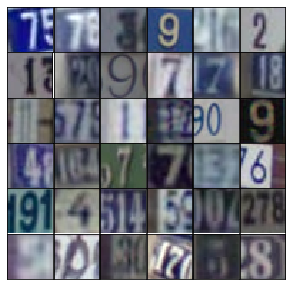

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [7]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [8]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [10]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z,4*4*512)
        x1 = tf.reshape(x1,(-1,4,4,512))
        x1 = tf.layers.batch_normalization(x1,training=training)
        x1 = tf.minimum(alpha*x1,x1)
                
        x2 = tf.layers.conv2d_transpose(x1,256,5,strides=2,padding="same")
        x2 = tf.layers.batch_normalization(x2,training=training)
        x2 = tf.minimum(alpha*x2,x2)

        x3 = tf.layers.conv2d_transpose(x2,128,5,strides=2,padding="same")
        x3 = tf.layers.batch_normalization(x3,training=training)
        x3 = tf.maximum(alpha*x3,x3)

        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3,output_dim,5,strides=2,padding="same")
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [11]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)

        flat = tf.reshape(relu3, (-1, 4*4*256))
        
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [12]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [14]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [15]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [16]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [17]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.3278... Generator Loss: 0.7758
Epoch 1/25... Discriminator Loss: 0.5329... Generator Loss: 1.4428
Epoch 1/25... Discriminator Loss: 0.1679... Generator Loss: 2.5227
Epoch 1/25... Discriminator Loss: 0.1475... Generator Loss: 2.8300
Epoch 1/25... Discriminator Loss: 0.2114... Generator Loss: 2.2055
Epoch 1/25... Discriminator Loss: 0.1597... Generator Loss: 2.7497
Epoch 1/25... Discriminator Loss: 0.1490... Generator Loss: 2.8553
Epoch 1/25... Discriminator Loss: 0.2160... Generator Loss: 2.4240
Epoch 1/25... Discriminator Loss: 0.2505... Generator Loss: 2.6781
Epoch 1/25... Discriminator Loss: 0.2856... Generator Loss: 2.1493


/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_base.py:1334: MatplotlibDeprecationWarning: 
box-forced
  "2.2", "box-forced", obj_type="keyword argument")


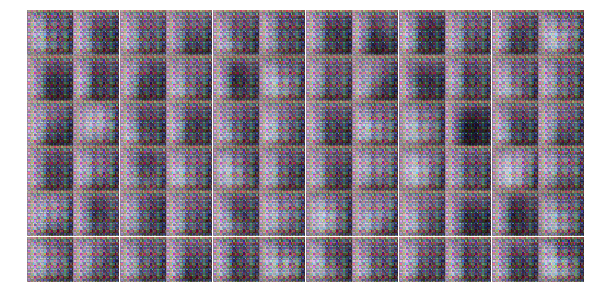

Epoch 1/25... Discriminator Loss: 0.6450... Generator Loss: 1.6003
Epoch 1/25... Discriminator Loss: 0.4625... Generator Loss: 2.2384
Epoch 1/25... Discriminator Loss: 0.5713... Generator Loss: 2.4117
Epoch 1/25... Discriminator Loss: 0.2462... Generator Loss: 2.7688
Epoch 1/25... Discriminator Loss: 0.4766... Generator Loss: 1.4611
Epoch 1/25... Discriminator Loss: 0.7023... Generator Loss: 3.9056
Epoch 1/25... Discriminator Loss: 0.2451... Generator Loss: 2.5032
Epoch 1/25... Discriminator Loss: 0.2500... Generator Loss: 2.4099
Epoch 1/25... Discriminator Loss: 0.3306... Generator Loss: 3.1858
Epoch 1/25... Discriminator Loss: 0.1183... Generator Loss: 2.8660


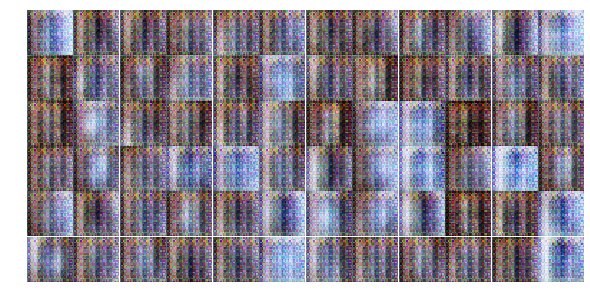

Epoch 1/25... Discriminator Loss: 0.6922... Generator Loss: 1.7447
Epoch 1/25... Discriminator Loss: 0.3869... Generator Loss: 2.3934
Epoch 1/25... Discriminator Loss: 0.7928... Generator Loss: 0.8540
Epoch 1/25... Discriminator Loss: 1.7131... Generator Loss: 0.4776
Epoch 1/25... Discriminator Loss: 0.4069... Generator Loss: 2.8950
Epoch 1/25... Discriminator Loss: 0.7609... Generator Loss: 2.8249
Epoch 1/25... Discriminator Loss: 0.2030... Generator Loss: 2.4880
Epoch 1/25... Discriminator Loss: 1.5674... Generator Loss: 0.4042
Epoch 1/25... Discriminator Loss: 0.9250... Generator Loss: 2.3169
Epoch 1/25... Discriminator Loss: 0.3684... Generator Loss: 1.5864


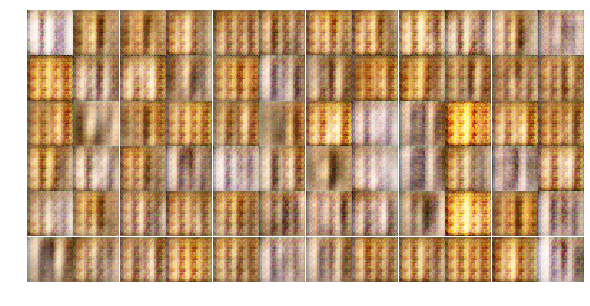

Epoch 1/25... Discriminator Loss: 1.2229... Generator Loss: 0.8729
Epoch 1/25... Discriminator Loss: 0.8430... Generator Loss: 1.8700
Epoch 1/25... Discriminator Loss: 0.8803... Generator Loss: 0.9719
Epoch 1/25... Discriminator Loss: 0.7069... Generator Loss: 1.3324
Epoch 1/25... Discriminator Loss: 0.9934... Generator Loss: 1.3773
Epoch 1/25... Discriminator Loss: 0.9733... Generator Loss: 1.0699
Epoch 1/25... Discriminator Loss: 0.6770... Generator Loss: 1.2195
Epoch 1/25... Discriminator Loss: 0.4101... Generator Loss: 1.9980
Epoch 1/25... Discriminator Loss: 0.5704... Generator Loss: 2.0536
Epoch 1/25... Discriminator Loss: 0.5092... Generator Loss: 1.8149


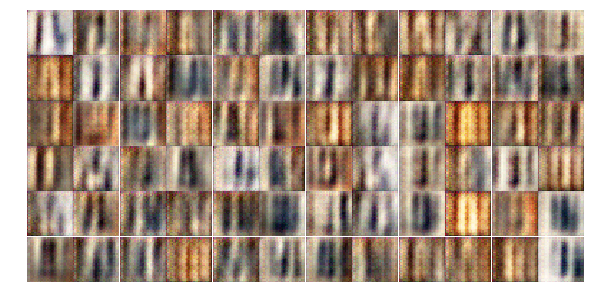

Epoch 1/25... Discriminator Loss: 0.3773... Generator Loss: 2.5354
Epoch 1/25... Discriminator Loss: 0.4257... Generator Loss: 1.6676
Epoch 1/25... Discriminator Loss: 0.7814... Generator Loss: 1.7680
Epoch 1/25... Discriminator Loss: 0.8880... Generator Loss: 2.2817
Epoch 1/25... Discriminator Loss: 0.5323... Generator Loss: 1.4776
Epoch 1/25... Discriminator Loss: 0.3339... Generator Loss: 1.8490
Epoch 1/25... Discriminator Loss: 0.8426... Generator Loss: 0.8212
Epoch 1/25... Discriminator Loss: 1.1860... Generator Loss: 0.6991
Epoch 1/25... Discriminator Loss: 0.7194... Generator Loss: 1.3160
Epoch 1/25... Discriminator Loss: 0.5987... Generator Loss: 1.7078


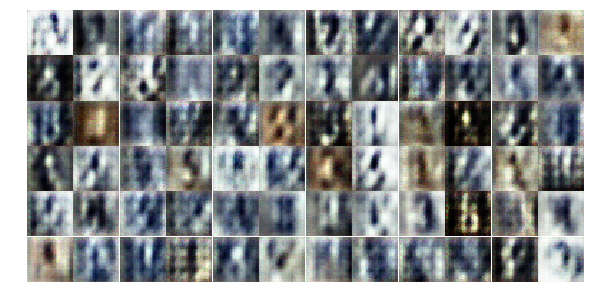

Epoch 1/25... Discriminator Loss: 0.6369... Generator Loss: 1.5778
Epoch 1/25... Discriminator Loss: 1.2059... Generator Loss: 0.5990
Epoch 1/25... Discriminator Loss: 0.6579... Generator Loss: 1.2811
Epoch 1/25... Discriminator Loss: 0.7353... Generator Loss: 1.1571
Epoch 1/25... Discriminator Loss: 0.7572... Generator Loss: 1.6218
Epoch 1/25... Discriminator Loss: 0.8064... Generator Loss: 1.0119
Epoch 1/25... Discriminator Loss: 0.6854... Generator Loss: 1.6180
Epoch 2/25... Discriminator Loss: 1.0526... Generator Loss: 0.9932
Epoch 2/25... Discriminator Loss: 0.7078... Generator Loss: 1.9036
Epoch 2/25... Discriminator Loss: 1.1333... Generator Loss: 0.7226


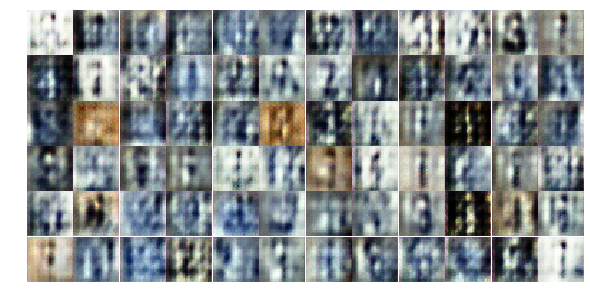

Epoch 2/25... Discriminator Loss: 0.7890... Generator Loss: 1.4968
Epoch 2/25... Discriminator Loss: 1.3437... Generator Loss: 0.5439
Epoch 2/25... Discriminator Loss: 1.3048... Generator Loss: 0.7731
Epoch 2/25... Discriminator Loss: 1.0029... Generator Loss: 1.0588
Epoch 2/25... Discriminator Loss: 0.7404... Generator Loss: 1.1395
Epoch 2/25... Discriminator Loss: 0.9458... Generator Loss: 1.3677
Epoch 2/25... Discriminator Loss: 0.7234... Generator Loss: 1.1292
Epoch 2/25... Discriminator Loss: 1.6556... Generator Loss: 0.3379
Epoch 2/25... Discriminator Loss: 1.6969... Generator Loss: 0.3157
Epoch 2/25... Discriminator Loss: 0.7777... Generator Loss: 1.4146


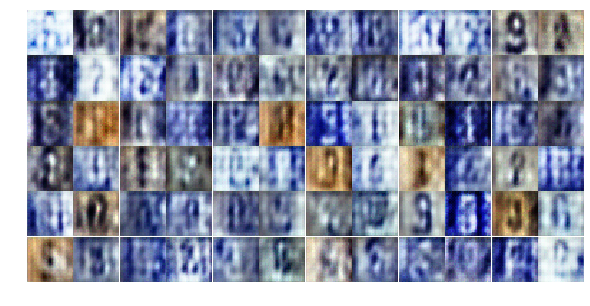

Epoch 2/25... Discriminator Loss: 0.7952... Generator Loss: 1.1493
Epoch 2/25... Discriminator Loss: 0.6557... Generator Loss: 1.5475
Epoch 2/25... Discriminator Loss: 0.8764... Generator Loss: 1.5356
Epoch 2/25... Discriminator Loss: 0.8735... Generator Loss: 1.1843
Epoch 2/25... Discriminator Loss: 0.7880... Generator Loss: 1.2570
Epoch 2/25... Discriminator Loss: 0.8839... Generator Loss: 1.0840
Epoch 2/25... Discriminator Loss: 1.0704... Generator Loss: 0.8371
Epoch 2/25... Discriminator Loss: 1.1075... Generator Loss: 0.8786
Epoch 2/25... Discriminator Loss: 0.8283... Generator Loss: 1.2250
Epoch 2/25... Discriminator Loss: 1.6235... Generator Loss: 0.4524


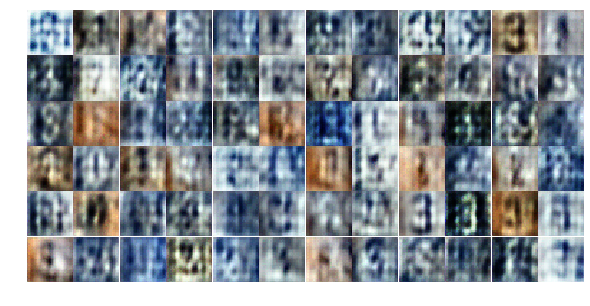

Epoch 2/25... Discriminator Loss: 1.1150... Generator Loss: 0.9145
Epoch 2/25... Discriminator Loss: 0.9746... Generator Loss: 1.1195
Epoch 2/25... Discriminator Loss: 0.9176... Generator Loss: 1.3571
Epoch 2/25... Discriminator Loss: 1.0495... Generator Loss: 0.9107
Epoch 2/25... Discriminator Loss: 1.0275... Generator Loss: 1.2842
Epoch 2/25... Discriminator Loss: 1.2511... Generator Loss: 0.7940
Epoch 2/25... Discriminator Loss: 1.1331... Generator Loss: 0.6091
Epoch 2/25... Discriminator Loss: 1.3058... Generator Loss: 0.6193
Epoch 2/25... Discriminator Loss: 1.0687... Generator Loss: 1.2653
Epoch 2/25... Discriminator Loss: 0.9118... Generator Loss: 1.2952


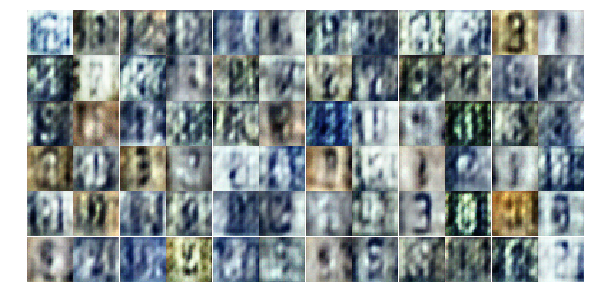

Epoch 2/25... Discriminator Loss: 1.1323... Generator Loss: 0.6947
Epoch 2/25... Discriminator Loss: 1.0738... Generator Loss: 1.0721
Epoch 2/25... Discriminator Loss: 1.3025... Generator Loss: 0.7388
Epoch 2/25... Discriminator Loss: 1.2114... Generator Loss: 0.8005
Epoch 2/25... Discriminator Loss: 1.1402... Generator Loss: 1.0343
Epoch 2/25... Discriminator Loss: 1.0625... Generator Loss: 1.0105
Epoch 2/25... Discriminator Loss: 1.2294... Generator Loss: 0.6918
Epoch 2/25... Discriminator Loss: 1.0921... Generator Loss: 1.5072
Epoch 2/25... Discriminator Loss: 1.1700... Generator Loss: 1.2751
Epoch 2/25... Discriminator Loss: 0.8940... Generator Loss: 1.2304


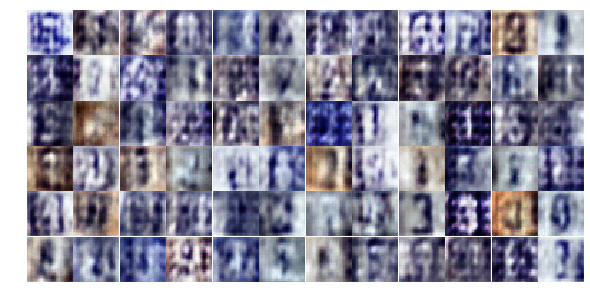

Epoch 2/25... Discriminator Loss: 0.8695... Generator Loss: 1.7868
Epoch 2/25... Discriminator Loss: 1.1224... Generator Loss: 1.5083
Epoch 2/25... Discriminator Loss: 1.1812... Generator Loss: 0.7222
Epoch 2/25... Discriminator Loss: 1.0673... Generator Loss: 0.8596
Epoch 2/25... Discriminator Loss: 1.1373... Generator Loss: 0.7451
Epoch 2/25... Discriminator Loss: 0.8702... Generator Loss: 1.1806
Epoch 2/25... Discriminator Loss: 1.1694... Generator Loss: 1.8147
Epoch 2/25... Discriminator Loss: 1.0704... Generator Loss: 1.0341
Epoch 2/25... Discriminator Loss: 0.7902... Generator Loss: 1.0674
Epoch 2/25... Discriminator Loss: 1.1425... Generator Loss: 1.5688


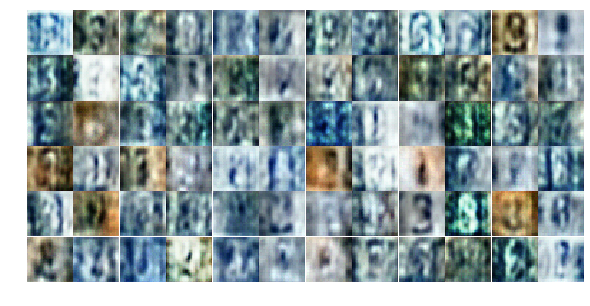

Epoch 2/25... Discriminator Loss: 0.7387... Generator Loss: 1.2443
Epoch 2/25... Discriminator Loss: 0.9483... Generator Loss: 1.0538
Epoch 2/25... Discriminator Loss: 0.9793... Generator Loss: 0.8713
Epoch 2/25... Discriminator Loss: 1.4482... Generator Loss: 0.4889
Epoch 3/25... Discriminator Loss: 0.8060... Generator Loss: 1.2737
Epoch 3/25... Discriminator Loss: 0.8399... Generator Loss: 0.9083
Epoch 3/25... Discriminator Loss: 0.7853... Generator Loss: 1.5948
Epoch 3/25... Discriminator Loss: 1.2136... Generator Loss: 0.5039
Epoch 3/25... Discriminator Loss: 1.1238... Generator Loss: 0.8776
Epoch 3/25... Discriminator Loss: 1.7959... Generator Loss: 0.2650


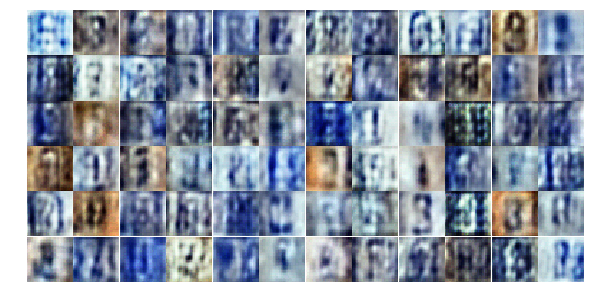

Epoch 3/25... Discriminator Loss: 0.8107... Generator Loss: 1.8499
Epoch 3/25... Discriminator Loss: 1.0289... Generator Loss: 0.6601
Epoch 3/25... Discriminator Loss: 0.7118... Generator Loss: 1.2829
Epoch 3/25... Discriminator Loss: 0.6029... Generator Loss: 1.2175
Epoch 3/25... Discriminator Loss: 0.9174... Generator Loss: 0.7635
Epoch 3/25... Discriminator Loss: 0.8867... Generator Loss: 0.8059
Epoch 3/25... Discriminator Loss: 0.7085... Generator Loss: 1.0745
Epoch 3/25... Discriminator Loss: 0.6875... Generator Loss: 1.1094
Epoch 3/25... Discriminator Loss: 1.8722... Generator Loss: 0.2912
Epoch 3/25... Discriminator Loss: 1.0957... Generator Loss: 0.6627


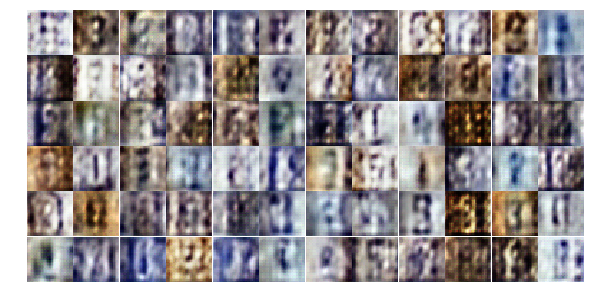

Epoch 3/25... Discriminator Loss: 0.9222... Generator Loss: 1.3755
Epoch 3/25... Discriminator Loss: 0.5798... Generator Loss: 1.3061
Epoch 3/25... Discriminator Loss: 0.8109... Generator Loss: 1.0458
Epoch 3/25... Discriminator Loss: 0.6010... Generator Loss: 1.6538
Epoch 3/25... Discriminator Loss: 0.6588... Generator Loss: 1.6946
Epoch 3/25... Discriminator Loss: 0.6597... Generator Loss: 2.1962
Epoch 3/25... Discriminator Loss: 1.8244... Generator Loss: 3.3391
Epoch 3/25... Discriminator Loss: 0.8846... Generator Loss: 1.7462
Epoch 3/25... Discriminator Loss: 0.5111... Generator Loss: 2.5488
Epoch 3/25... Discriminator Loss: 0.5967... Generator Loss: 1.3308


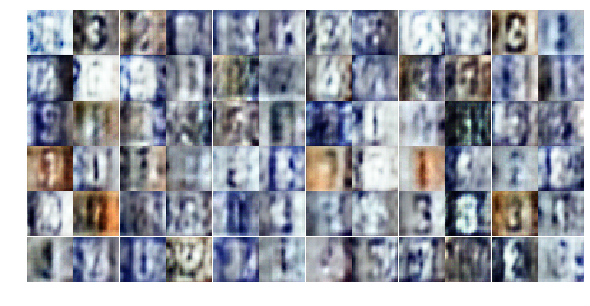

Epoch 3/25... Discriminator Loss: 0.8192... Generator Loss: 1.6682
Epoch 3/25... Discriminator Loss: 0.5933... Generator Loss: 1.2198
Epoch 3/25... Discriminator Loss: 0.6085... Generator Loss: 1.0704
Epoch 3/25... Discriminator Loss: 0.5907... Generator Loss: 1.6833
Epoch 3/25... Discriminator Loss: 0.3883... Generator Loss: 1.7775
Epoch 3/25... Discriminator Loss: 0.3903... Generator Loss: 2.1688
Epoch 3/25... Discriminator Loss: 1.2963... Generator Loss: 0.4841
Epoch 3/25... Discriminator Loss: 0.7782... Generator Loss: 3.1847
Epoch 3/25... Discriminator Loss: 0.9657... Generator Loss: 1.9669
Epoch 3/25... Discriminator Loss: 1.2646... Generator Loss: 0.4790


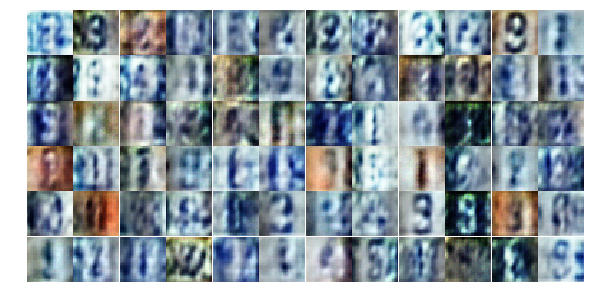

Epoch 3/25... Discriminator Loss: 0.4821... Generator Loss: 1.6985
Epoch 3/25... Discriminator Loss: 0.3570... Generator Loss: 1.8949
Epoch 3/25... Discriminator Loss: 0.6418... Generator Loss: 1.3833
Epoch 3/25... Discriminator Loss: 0.5126... Generator Loss: 3.2211
Epoch 3/25... Discriminator Loss: 0.2811... Generator Loss: 2.9453
Epoch 3/25... Discriminator Loss: 0.4872... Generator Loss: 1.3425
Epoch 3/25... Discriminator Loss: 0.6151... Generator Loss: 1.4546
Epoch 3/25... Discriminator Loss: 0.5643... Generator Loss: 1.1514
Epoch 3/25... Discriminator Loss: 0.2719... Generator Loss: 2.3021
Epoch 3/25... Discriminator Loss: 0.5538... Generator Loss: 1.3353


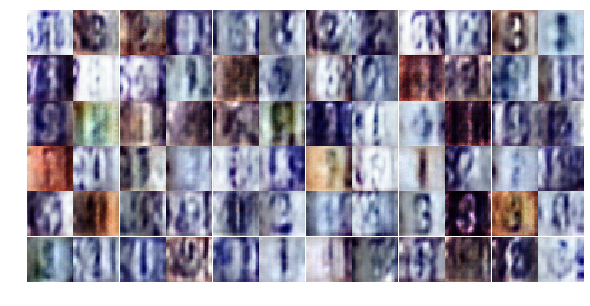

Epoch 3/25... Discriminator Loss: 1.0582... Generator Loss: 0.7528
Epoch 3/25... Discriminator Loss: 0.4489... Generator Loss: 1.6917
Epoch 3/25... Discriminator Loss: 0.5421... Generator Loss: 2.1916
Epoch 3/25... Discriminator Loss: 0.7156... Generator Loss: 1.1709
Epoch 3/25... Discriminator Loss: 0.3976... Generator Loss: 1.8541
Epoch 3/25... Discriminator Loss: 0.4494... Generator Loss: 1.6955
Epoch 3/25... Discriminator Loss: 0.3016... Generator Loss: 2.0657
Epoch 3/25... Discriminator Loss: 0.1900... Generator Loss: 2.5787
Epoch 3/25... Discriminator Loss: 0.3694... Generator Loss: 1.9399
Epoch 3/25... Discriminator Loss: 0.8110... Generator Loss: 0.9711


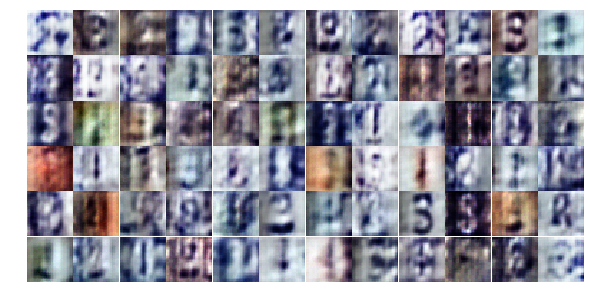

Epoch 3/25... Discriminator Loss: 0.7553... Generator Loss: 1.7730
Epoch 4/25... Discriminator Loss: 1.0400... Generator Loss: 0.6423
Epoch 4/25... Discriminator Loss: 0.4636... Generator Loss: 1.5894
Epoch 4/25... Discriminator Loss: 0.8177... Generator Loss: 1.2082
Epoch 4/25... Discriminator Loss: 1.0993... Generator Loss: 2.7176
Epoch 4/25... Discriminator Loss: 0.4500... Generator Loss: 1.8466
Epoch 4/25... Discriminator Loss: 0.3713... Generator Loss: 2.0865
Epoch 4/25... Discriminator Loss: 0.4985... Generator Loss: 1.7563
Epoch 4/25... Discriminator Loss: 0.4890... Generator Loss: 1.3771
Epoch 4/25... Discriminator Loss: 0.5655... Generator Loss: 1.8086


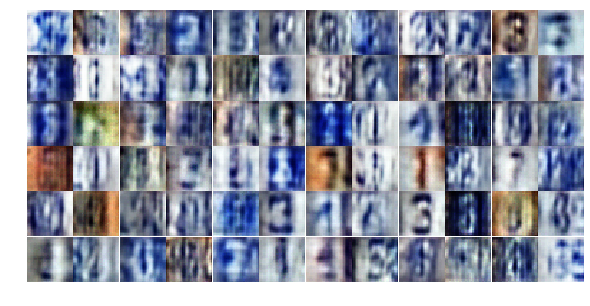

Epoch 4/25... Discriminator Loss: 0.5307... Generator Loss: 1.2549
Epoch 4/25... Discriminator Loss: 0.4747... Generator Loss: 1.4257
Epoch 4/25... Discriminator Loss: 0.7693... Generator Loss: 1.6792
Epoch 4/25... Discriminator Loss: 0.5450... Generator Loss: 1.1965
Epoch 4/25... Discriminator Loss: 0.5228... Generator Loss: 1.8857
Epoch 4/25... Discriminator Loss: 1.4972... Generator Loss: 0.4384
Epoch 4/25... Discriminator Loss: 0.7430... Generator Loss: 1.2673
Epoch 4/25... Discriminator Loss: 0.5767... Generator Loss: 1.3617
Epoch 4/25... Discriminator Loss: 0.6738... Generator Loss: 1.5577
Epoch 4/25... Discriminator Loss: 0.8435... Generator Loss: 0.8843


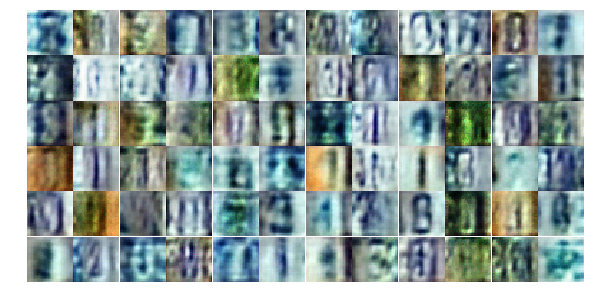

Epoch 4/25... Discriminator Loss: 0.7199... Generator Loss: 1.3171
Epoch 4/25... Discriminator Loss: 0.4665... Generator Loss: 1.5368
Epoch 4/25... Discriminator Loss: 0.7824... Generator Loss: 0.8814
Epoch 4/25... Discriminator Loss: 0.6279... Generator Loss: 1.0385
Epoch 4/25... Discriminator Loss: 0.4886... Generator Loss: 2.0906
Epoch 4/25... Discriminator Loss: 0.8594... Generator Loss: 2.1805
Epoch 4/25... Discriminator Loss: 0.5960... Generator Loss: 1.4597
Epoch 4/25... Discriminator Loss: 0.5624... Generator Loss: 1.6584
Epoch 4/25... Discriminator Loss: 0.4205... Generator Loss: 2.0051
Epoch 4/25... Discriminator Loss: 0.2616... Generator Loss: 2.4209


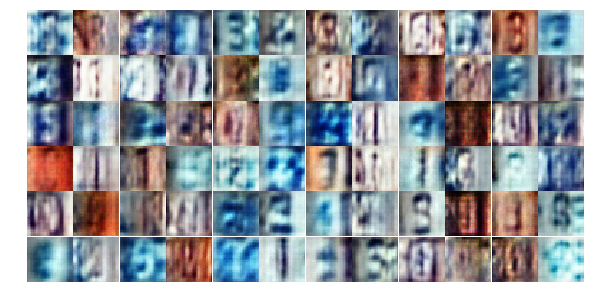

Epoch 4/25... Discriminator Loss: 0.2921... Generator Loss: 2.5385
Epoch 4/25... Discriminator Loss: 0.8498... Generator Loss: 0.7668
Epoch 4/25... Discriminator Loss: 0.4467... Generator Loss: 1.4911
Epoch 4/25... Discriminator Loss: 0.7537... Generator Loss: 3.3268
Epoch 4/25... Discriminator Loss: 0.5652... Generator Loss: 1.5645
Epoch 4/25... Discriminator Loss: 0.5928... Generator Loss: 1.5136
Epoch 4/25... Discriminator Loss: 1.0035... Generator Loss: 1.0846
Epoch 4/25... Discriminator Loss: 0.6338... Generator Loss: 1.4983
Epoch 4/25... Discriminator Loss: 0.5099... Generator Loss: 1.5316
Epoch 4/25... Discriminator Loss: 0.6683... Generator Loss: 1.0448


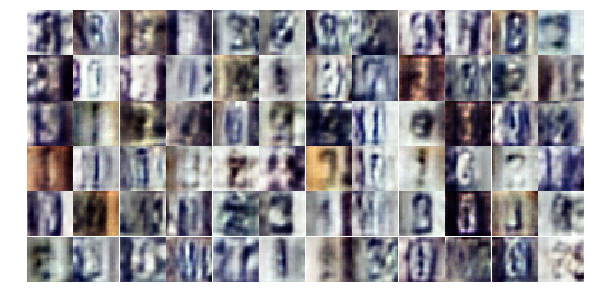

Epoch 4/25... Discriminator Loss: 0.3582... Generator Loss: 1.7175
Epoch 4/25... Discriminator Loss: 0.5165... Generator Loss: 1.4353
Epoch 4/25... Discriminator Loss: 0.5214... Generator Loss: 1.6479
Epoch 4/25... Discriminator Loss: 0.4859... Generator Loss: 1.3488
Epoch 4/25... Discriminator Loss: 0.6377... Generator Loss: 2.9586
Epoch 4/25... Discriminator Loss: 1.2156... Generator Loss: 0.4748
Epoch 4/25... Discriminator Loss: 1.1032... Generator Loss: 0.6138
Epoch 4/25... Discriminator Loss: 0.7114... Generator Loss: 1.5851
Epoch 4/25... Discriminator Loss: 0.5812... Generator Loss: 1.3027
Epoch 4/25... Discriminator Loss: 0.4213... Generator Loss: 1.8074


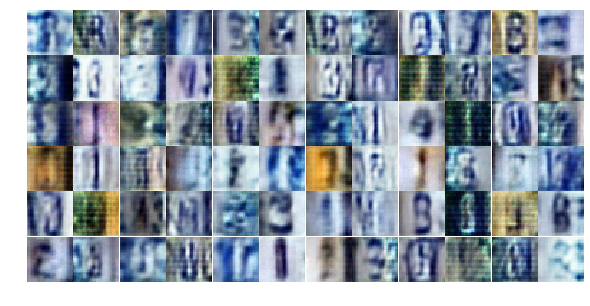

Epoch 4/25... Discriminator Loss: 0.5886... Generator Loss: 1.3684
Epoch 4/25... Discriminator Loss: 0.4798... Generator Loss: 1.8521
Epoch 4/25... Discriminator Loss: 0.3196... Generator Loss: 2.3914
Epoch 4/25... Discriminator Loss: 1.4567... Generator Loss: 3.5880
Epoch 4/25... Discriminator Loss: 1.1631... Generator Loss: 0.5674
Epoch 4/25... Discriminator Loss: 0.6283... Generator Loss: 1.1723
Epoch 4/25... Discriminator Loss: 0.7590... Generator Loss: 0.9354
Epoch 4/25... Discriminator Loss: 0.7014... Generator Loss: 2.0474
Epoch 4/25... Discriminator Loss: 0.7686... Generator Loss: 1.1458
Epoch 5/25... Discriminator Loss: 0.5103... Generator Loss: 1.3015


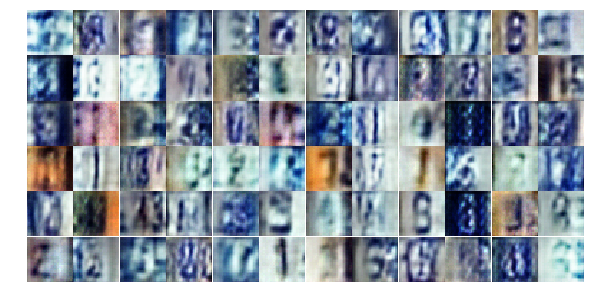

Epoch 5/25... Discriminator Loss: 0.4648... Generator Loss: 1.9573
Epoch 5/25... Discriminator Loss: 0.6103... Generator Loss: 1.1524
Epoch 5/25... Discriminator Loss: 0.4588... Generator Loss: 1.6226
Epoch 5/25... Discriminator Loss: 0.5670... Generator Loss: 1.0687
Epoch 5/25... Discriminator Loss: 0.2503... Generator Loss: 2.1698
Epoch 5/25... Discriminator Loss: 1.6536... Generator Loss: 0.2842
Epoch 5/25... Discriminator Loss: 0.7171... Generator Loss: 1.0747
Epoch 5/25... Discriminator Loss: 0.7239... Generator Loss: 1.1322
Epoch 5/25... Discriminator Loss: 0.7038... Generator Loss: 0.9497
Epoch 5/25... Discriminator Loss: 0.8258... Generator Loss: 0.7948


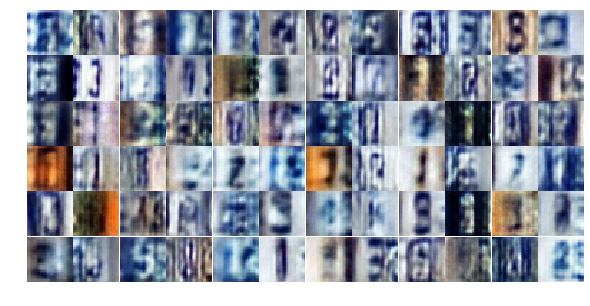

Epoch 5/25... Discriminator Loss: 0.3548... Generator Loss: 2.0359
Epoch 5/25... Discriminator Loss: 0.4982... Generator Loss: 1.8556
Epoch 5/25... Discriminator Loss: 0.4985... Generator Loss: 1.6829
Epoch 5/25... Discriminator Loss: 1.1049... Generator Loss: 0.5549
Epoch 5/25... Discriminator Loss: 0.5873... Generator Loss: 1.8636
Epoch 5/25... Discriminator Loss: 0.6658... Generator Loss: 1.3679
Epoch 5/25... Discriminator Loss: 0.6733... Generator Loss: 1.0765
Epoch 5/25... Discriminator Loss: 0.4352... Generator Loss: 1.8684
Epoch 5/25... Discriminator Loss: 0.9308... Generator Loss: 2.4653
Epoch 5/25... Discriminator Loss: 0.4829... Generator Loss: 1.6870


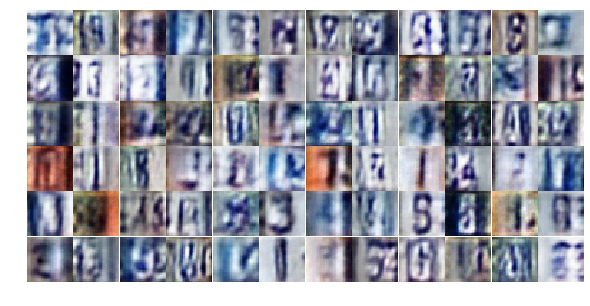

Epoch 5/25... Discriminator Loss: 0.4835... Generator Loss: 1.4282
Epoch 5/25... Discriminator Loss: 1.1204... Generator Loss: 2.0879
Epoch 5/25... Discriminator Loss: 0.5337... Generator Loss: 1.1876
Epoch 5/25... Discriminator Loss: 0.4234... Generator Loss: 1.5711
Epoch 5/25... Discriminator Loss: 0.4140... Generator Loss: 1.4816
Epoch 5/25... Discriminator Loss: 0.4833... Generator Loss: 1.4867
Epoch 5/25... Discriminator Loss: 0.7735... Generator Loss: 0.8190
Epoch 5/25... Discriminator Loss: 1.3701... Generator Loss: 0.4473
Epoch 5/25... Discriminator Loss: 0.7569... Generator Loss: 2.5964
Epoch 5/25... Discriminator Loss: 0.7291... Generator Loss: 1.1833


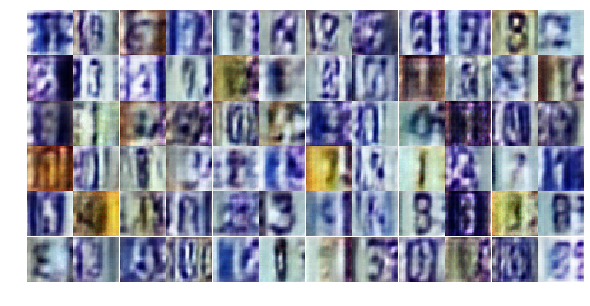

Epoch 5/25... Discriminator Loss: 0.6044... Generator Loss: 1.3331
Epoch 5/25... Discriminator Loss: 0.8355... Generator Loss: 0.7674
Epoch 5/25... Discriminator Loss: 0.6939... Generator Loss: 0.9949
Epoch 5/25... Discriminator Loss: 0.7081... Generator Loss: 0.9733
Epoch 5/25... Discriminator Loss: 0.9098... Generator Loss: 0.7045
Epoch 5/25... Discriminator Loss: 0.5929... Generator Loss: 2.5021
Epoch 5/25... Discriminator Loss: 1.1088... Generator Loss: 0.5414
Epoch 5/25... Discriminator Loss: 0.3674... Generator Loss: 1.8769
Epoch 5/25... Discriminator Loss: 0.8862... Generator Loss: 0.7043
Epoch 5/25... Discriminator Loss: 0.5107... Generator Loss: 1.1733


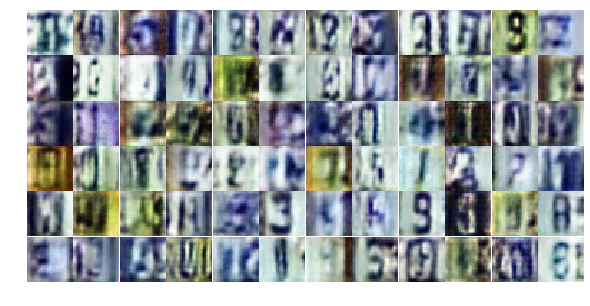

Epoch 5/25... Discriminator Loss: 0.2757... Generator Loss: 2.6408
Epoch 5/25... Discriminator Loss: 0.3350... Generator Loss: 1.6332
Epoch 5/25... Discriminator Loss: 0.7027... Generator Loss: 1.7503
Epoch 5/25... Discriminator Loss: 1.3999... Generator Loss: 0.4811
Epoch 5/25... Discriminator Loss: 0.8199... Generator Loss: 1.8071
Epoch 5/25... Discriminator Loss: 0.8550... Generator Loss: 0.8791
Epoch 5/25... Discriminator Loss: 0.9029... Generator Loss: 0.9041
Epoch 5/25... Discriminator Loss: 0.4746... Generator Loss: 1.9029
Epoch 5/25... Discriminator Loss: 0.7058... Generator Loss: 0.9454
Epoch 5/25... Discriminator Loss: 0.4292... Generator Loss: 1.8993


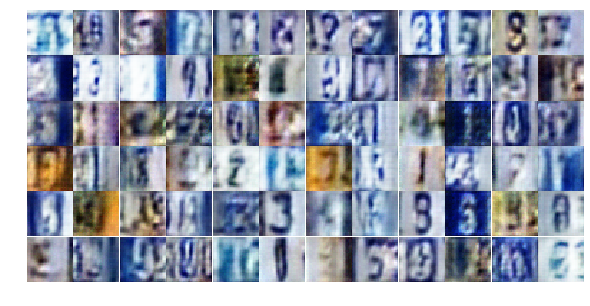

Epoch 5/25... Discriminator Loss: 0.8805... Generator Loss: 0.9195
Epoch 5/25... Discriminator Loss: 0.7510... Generator Loss: 0.9694
Epoch 5/25... Discriminator Loss: 0.7129... Generator Loss: 1.0145
Epoch 5/25... Discriminator Loss: 0.6557... Generator Loss: 1.0424
Epoch 5/25... Discriminator Loss: 0.5257... Generator Loss: 1.3692
Epoch 5/25... Discriminator Loss: 0.6891... Generator Loss: 1.6484
Epoch 6/25... Discriminator Loss: 0.6053... Generator Loss: 1.1907
Epoch 6/25... Discriminator Loss: 0.4170... Generator Loss: 1.4603
Epoch 6/25... Discriminator Loss: 1.3608... Generator Loss: 0.6150
Epoch 6/25... Discriminator Loss: 0.9141... Generator Loss: 0.7407


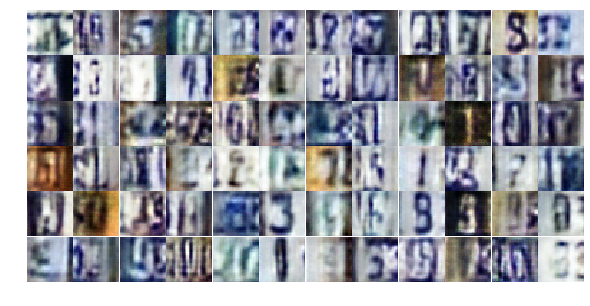

Epoch 6/25... Discriminator Loss: 0.5275... Generator Loss: 1.2149
Epoch 6/25... Discriminator Loss: 1.7698... Generator Loss: 0.2751
Epoch 6/25... Discriminator Loss: 2.6653... Generator Loss: 5.0408
Epoch 6/25... Discriminator Loss: 0.9841... Generator Loss: 0.7514
Epoch 6/25... Discriminator Loss: 0.7695... Generator Loss: 0.9669
Epoch 6/25... Discriminator Loss: 0.7125... Generator Loss: 0.9121
Epoch 6/25... Discriminator Loss: 0.5522... Generator Loss: 1.8819
Epoch 6/25... Discriminator Loss: 0.7423... Generator Loss: 0.9470
Epoch 6/25... Discriminator Loss: 0.4601... Generator Loss: 1.4979
Epoch 6/25... Discriminator Loss: 0.5722... Generator Loss: 1.3545


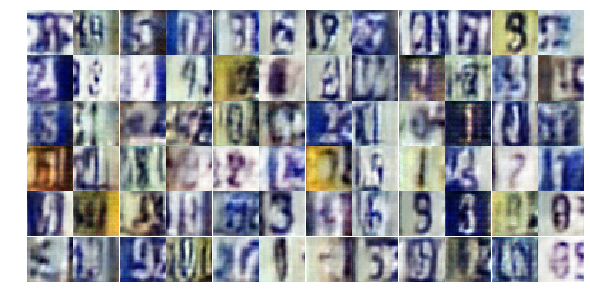

Epoch 6/25... Discriminator Loss: 0.4390... Generator Loss: 1.5941
Epoch 6/25... Discriminator Loss: 1.8567... Generator Loss: 0.2328
Epoch 6/25... Discriminator Loss: 0.9307... Generator Loss: 0.7251
Epoch 6/25... Discriminator Loss: 0.3127... Generator Loss: 1.8549
Epoch 6/25... Discriminator Loss: 0.4695... Generator Loss: 1.8306
Epoch 6/25... Discriminator Loss: 0.5555... Generator Loss: 1.3399
Epoch 6/25... Discriminator Loss: 0.5241... Generator Loss: 1.4161
Epoch 6/25... Discriminator Loss: 1.1273... Generator Loss: 0.4942
Epoch 6/25... Discriminator Loss: 0.5768... Generator Loss: 1.8209
Epoch 6/25... Discriminator Loss: 0.9554... Generator Loss: 2.0321


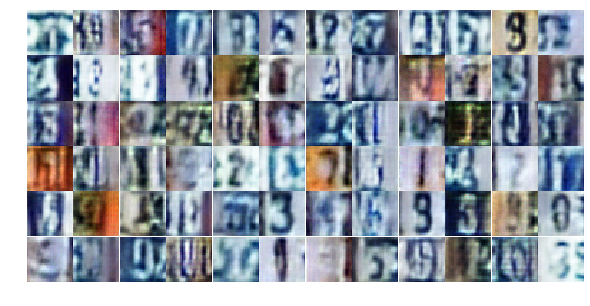

Epoch 6/25... Discriminator Loss: 0.8926... Generator Loss: 0.7330
Epoch 6/25... Discriminator Loss: 0.9631... Generator Loss: 0.6484
Epoch 6/25... Discriminator Loss: 0.6649... Generator Loss: 1.0178
Epoch 6/25... Discriminator Loss: 0.8532... Generator Loss: 0.7624
Epoch 6/25... Discriminator Loss: 0.9536... Generator Loss: 1.9032
Epoch 6/25... Discriminator Loss: 0.9120... Generator Loss: 0.7295
Epoch 6/25... Discriminator Loss: 0.7214... Generator Loss: 1.1786
Epoch 6/25... Discriminator Loss: 0.3515... Generator Loss: 1.6917
Epoch 6/25... Discriminator Loss: 0.6129... Generator Loss: 1.2179
Epoch 6/25... Discriminator Loss: 0.4961... Generator Loss: 1.4945


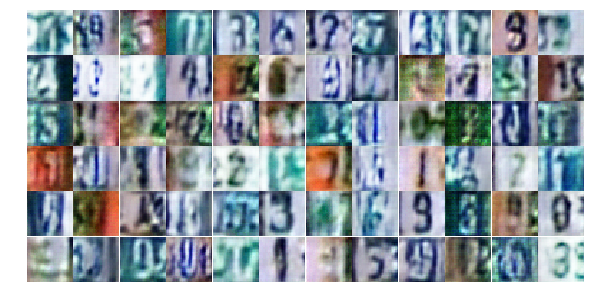

Epoch 6/25... Discriminator Loss: 0.7065... Generator Loss: 0.9582
Epoch 6/25... Discriminator Loss: 0.6131... Generator Loss: 2.2809
Epoch 6/25... Discriminator Loss: 0.9343... Generator Loss: 0.7420
Epoch 6/25... Discriminator Loss: 0.6567... Generator Loss: 1.4449
Epoch 6/25... Discriminator Loss: 0.7620... Generator Loss: 0.8127
Epoch 6/25... Discriminator Loss: 0.6131... Generator Loss: 1.1169
Epoch 6/25... Discriminator Loss: 0.3230... Generator Loss: 2.1713
Epoch 6/25... Discriminator Loss: 0.2206... Generator Loss: 2.9391
Epoch 6/25... Discriminator Loss: 0.7531... Generator Loss: 0.8232
Epoch 6/25... Discriminator Loss: 0.3525... Generator Loss: 1.5461


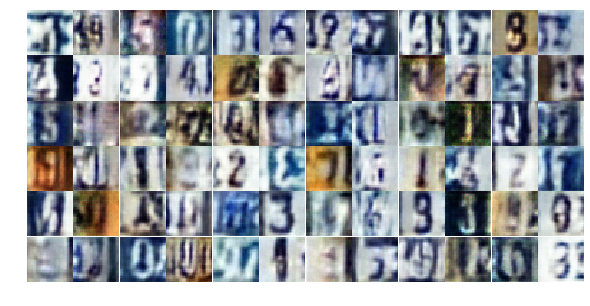

Epoch 6/25... Discriminator Loss: 0.7977... Generator Loss: 1.4203
Epoch 6/25... Discriminator Loss: 0.9857... Generator Loss: 0.9846
Epoch 6/25... Discriminator Loss: 0.8617... Generator Loss: 0.8675
Epoch 6/25... Discriminator Loss: 0.5900... Generator Loss: 1.1440
Epoch 6/25... Discriminator Loss: 0.9879... Generator Loss: 4.1971
Epoch 6/25... Discriminator Loss: 0.3061... Generator Loss: 2.0340
Epoch 6/25... Discriminator Loss: 0.5837... Generator Loss: 1.5063
Epoch 6/25... Discriminator Loss: 1.4157... Generator Loss: 0.4469
Epoch 6/25... Discriminator Loss: 0.5400... Generator Loss: 1.7240
Epoch 6/25... Discriminator Loss: 1.6966... Generator Loss: 0.2808


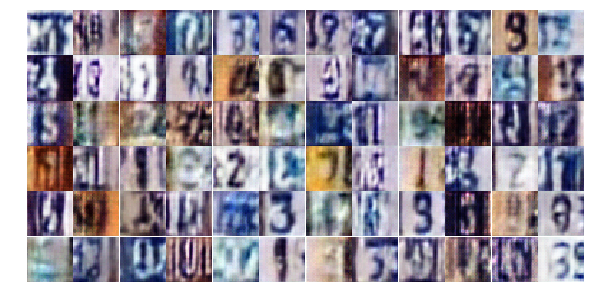

Epoch 6/25... Discriminator Loss: 0.3973... Generator Loss: 1.7415
Epoch 6/25... Discriminator Loss: 0.3983... Generator Loss: 1.8639
Epoch 6/25... Discriminator Loss: 0.4379... Generator Loss: 1.5162
Epoch 7/25... Discriminator Loss: 0.3069... Generator Loss: 2.8370
Epoch 7/25... Discriminator Loss: 0.1995... Generator Loss: 2.7929
Epoch 7/25... Discriminator Loss: 0.4251... Generator Loss: 1.5145
Epoch 7/25... Discriminator Loss: 0.3590... Generator Loss: 1.7249
Epoch 7/25... Discriminator Loss: 0.1965... Generator Loss: 2.5697
Epoch 7/25... Discriminator Loss: 0.3125... Generator Loss: 3.4571
Epoch 7/25... Discriminator Loss: 0.4236... Generator Loss: 4.9217


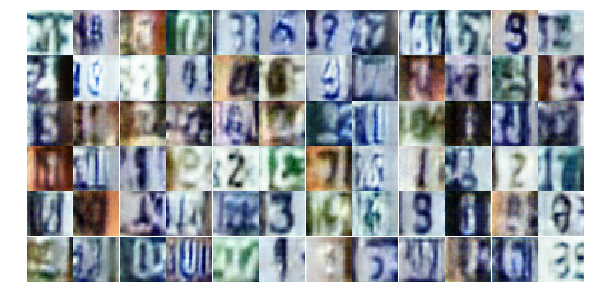

Epoch 7/25... Discriminator Loss: 0.6139... Generator Loss: 1.9774
Epoch 7/25... Discriminator Loss: 0.8128... Generator Loss: 0.7882
Epoch 7/25... Discriminator Loss: 0.8020... Generator Loss: 0.7913
Epoch 7/25... Discriminator Loss: 0.3237... Generator Loss: 3.1213
Epoch 7/25... Discriminator Loss: 0.5694... Generator Loss: 1.0394
Epoch 7/25... Discriminator Loss: 1.1114... Generator Loss: 0.5428
Epoch 7/25... Discriminator Loss: 0.6158... Generator Loss: 1.0375
Epoch 7/25... Discriminator Loss: 0.2160... Generator Loss: 3.9650
Epoch 7/25... Discriminator Loss: 0.6061... Generator Loss: 3.5923
Epoch 7/25... Discriminator Loss: 0.2357... Generator Loss: 2.0787


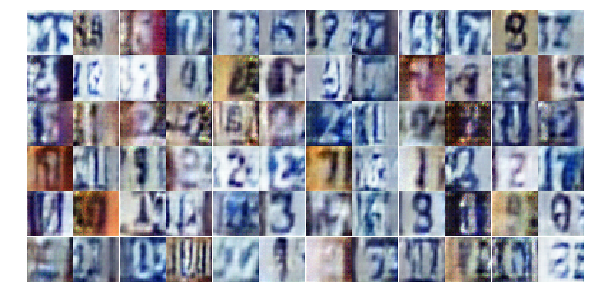

Epoch 7/25... Discriminator Loss: 0.4315... Generator Loss: 1.3217
Epoch 7/25... Discriminator Loss: 0.2474... Generator Loss: 5.3123
Epoch 7/25... Discriminator Loss: 0.1207... Generator Loss: 3.0698
Epoch 7/25... Discriminator Loss: 0.4551... Generator Loss: 1.3485
Epoch 7/25... Discriminator Loss: 0.0796... Generator Loss: 3.1917
Epoch 7/25... Discriminator Loss: 0.3916... Generator Loss: 3.5000
Epoch 7/25... Discriminator Loss: 0.1823... Generator Loss: 2.9165
Epoch 7/25... Discriminator Loss: 0.2051... Generator Loss: 2.0452
Epoch 7/25... Discriminator Loss: 0.0847... Generator Loss: 3.5348
Epoch 7/25... Discriminator Loss: 0.4688... Generator Loss: 1.2744


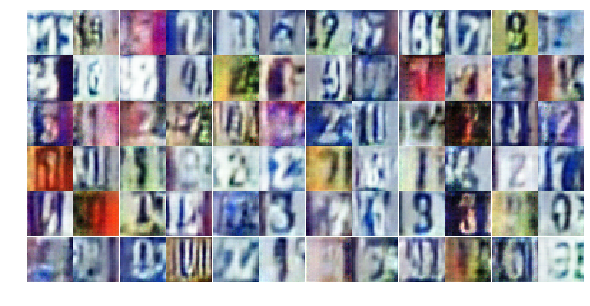

Epoch 7/25... Discriminator Loss: 0.1587... Generator Loss: 3.2961
Epoch 7/25... Discriminator Loss: 0.5676... Generator Loss: 1.0292
Epoch 7/25... Discriminator Loss: 0.1316... Generator Loss: 3.6227
Epoch 7/25... Discriminator Loss: 0.5180... Generator Loss: 1.2725
Epoch 7/25... Discriminator Loss: 0.3805... Generator Loss: 1.5545
Epoch 7/25... Discriminator Loss: 0.2927... Generator Loss: 1.8659
Epoch 7/25... Discriminator Loss: 0.1569... Generator Loss: 3.1171
Epoch 7/25... Discriminator Loss: 0.2630... Generator Loss: 2.0786
Epoch 7/25... Discriminator Loss: 0.2660... Generator Loss: 1.9156
Epoch 7/25... Discriminator Loss: 0.1865... Generator Loss: 2.4502


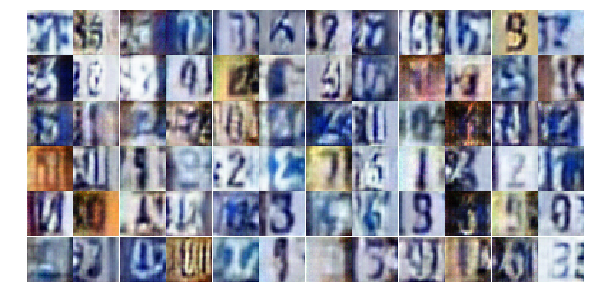

Epoch 7/25... Discriminator Loss: 0.1937... Generator Loss: 2.7944
Epoch 7/25... Discriminator Loss: 0.0911... Generator Loss: 3.7629
Epoch 7/25... Discriminator Loss: 0.3942... Generator Loss: 1.5233
Epoch 7/25... Discriminator Loss: 0.7134... Generator Loss: 0.8278
Epoch 7/25... Discriminator Loss: 3.5251... Generator Loss: 2.6532
Epoch 7/25... Discriminator Loss: 1.2971... Generator Loss: 0.5851
Epoch 7/25... Discriminator Loss: 1.1586... Generator Loss: 0.6971
Epoch 7/25... Discriminator Loss: 1.1464... Generator Loss: 0.8099
Epoch 7/25... Discriminator Loss: 0.9671... Generator Loss: 2.2469
Epoch 7/25... Discriminator Loss: 1.0918... Generator Loss: 1.1370


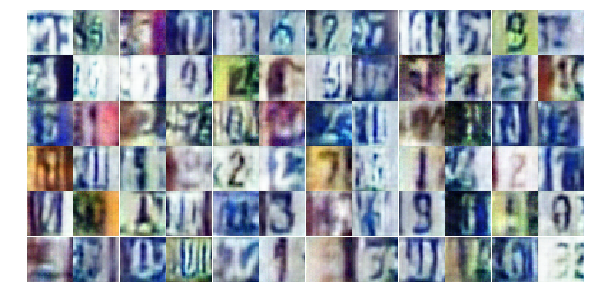

Epoch 7/25... Discriminator Loss: 0.9702... Generator Loss: 1.8603
Epoch 7/25... Discriminator Loss: 0.7769... Generator Loss: 1.3502
Epoch 7/25... Discriminator Loss: 0.7635... Generator Loss: 1.1893
Epoch 7/25... Discriminator Loss: 0.8931... Generator Loss: 0.9002
Epoch 7/25... Discriminator Loss: 0.6545... Generator Loss: 1.1324
Epoch 7/25... Discriminator Loss: 0.6907... Generator Loss: 1.1044
Epoch 7/25... Discriminator Loss: 1.2403... Generator Loss: 0.4363
Epoch 7/25... Discriminator Loss: 0.6814... Generator Loss: 1.4684
Epoch 7/25... Discriminator Loss: 0.8064... Generator Loss: 1.0181
Epoch 7/25... Discriminator Loss: 1.3333... Generator Loss: 0.4530


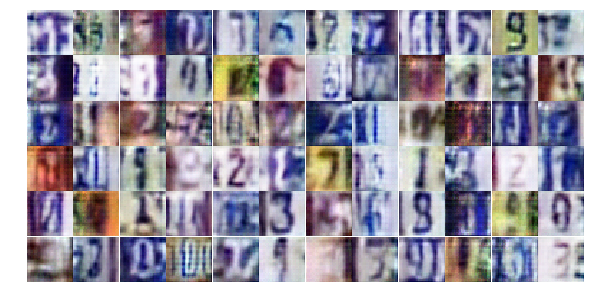

Epoch 7/25... Discriminator Loss: 0.6695... Generator Loss: 1.7391
Epoch 8/25... Discriminator Loss: 0.8830... Generator Loss: 0.7607
Epoch 8/25... Discriminator Loss: 1.0025... Generator Loss: 0.5944
Epoch 8/25... Discriminator Loss: 0.8284... Generator Loss: 0.8445
Epoch 8/25... Discriminator Loss: 0.5946... Generator Loss: 1.1783
Epoch 8/25... Discriminator Loss: 0.9415... Generator Loss: 0.7208
Epoch 8/25... Discriminator Loss: 0.4992... Generator Loss: 1.5314
Epoch 8/25... Discriminator Loss: 0.2869... Generator Loss: 2.5700
Epoch 8/25... Discriminator Loss: 0.3710... Generator Loss: 1.8903
Epoch 8/25... Discriminator Loss: 0.7198... Generator Loss: 0.8977


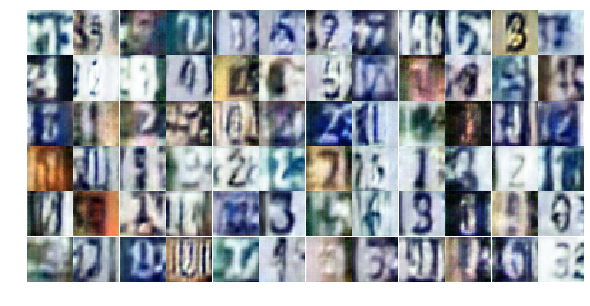

Epoch 8/25... Discriminator Loss: 0.4069... Generator Loss: 1.9660
Epoch 8/25... Discriminator Loss: 0.5285... Generator Loss: 1.1454
Epoch 8/25... Discriminator Loss: 0.3869... Generator Loss: 1.5482
Epoch 8/25... Discriminator Loss: 0.7491... Generator Loss: 0.8097
Epoch 8/25... Discriminator Loss: 0.7646... Generator Loss: 1.1562
Epoch 8/25... Discriminator Loss: 0.2386... Generator Loss: 2.2170
Epoch 8/25... Discriminator Loss: 0.2480... Generator Loss: 2.1851
Epoch 8/25... Discriminator Loss: 0.6714... Generator Loss: 0.9324
Epoch 8/25... Discriminator Loss: 0.4282... Generator Loss: 1.4856
Epoch 8/25... Discriminator Loss: 0.7667... Generator Loss: 0.8816


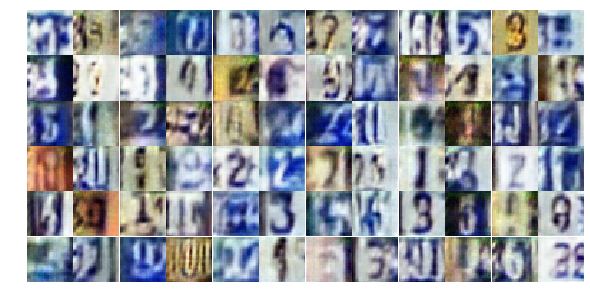

Epoch 8/25... Discriminator Loss: 0.3247... Generator Loss: 5.4238
Epoch 8/25... Discriminator Loss: 0.0756... Generator Loss: 4.1254
Epoch 8/25... Discriminator Loss: 0.3408... Generator Loss: 1.5903
Epoch 8/25... Discriminator Loss: 0.1574... Generator Loss: 3.4752
Epoch 8/25... Discriminator Loss: 0.1372... Generator Loss: 7.6575
Epoch 8/25... Discriminator Loss: 0.4234... Generator Loss: 1.4802
Epoch 8/25... Discriminator Loss: 0.4841... Generator Loss: 1.2724
Epoch 8/25... Discriminator Loss: 0.1794... Generator Loss: 2.6984
Epoch 8/25... Discriminator Loss: 0.1312... Generator Loss: 3.2655
Epoch 8/25... Discriminator Loss: 0.0868... Generator Loss: 5.0273


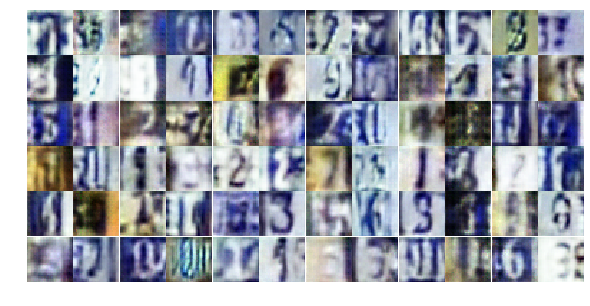

Epoch 8/25... Discriminator Loss: 0.3228... Generator Loss: 1.5782
Epoch 8/25... Discriminator Loss: 0.3159... Generator Loss: 1.7719
Epoch 8/25... Discriminator Loss: 0.7139... Generator Loss: 6.6942
Epoch 8/25... Discriminator Loss: 0.3134... Generator Loss: 1.8419
Epoch 8/25... Discriminator Loss: 0.6680... Generator Loss: 6.1990
Epoch 8/25... Discriminator Loss: 0.1229... Generator Loss: 3.1042
Epoch 8/25... Discriminator Loss: 1.4248... Generator Loss: 4.3706
Epoch 8/25... Discriminator Loss: 1.3595... Generator Loss: 0.4622
Epoch 8/25... Discriminator Loss: 2.5047... Generator Loss: 0.1400
Epoch 8/25... Discriminator Loss: 0.6835... Generator Loss: 1.6863


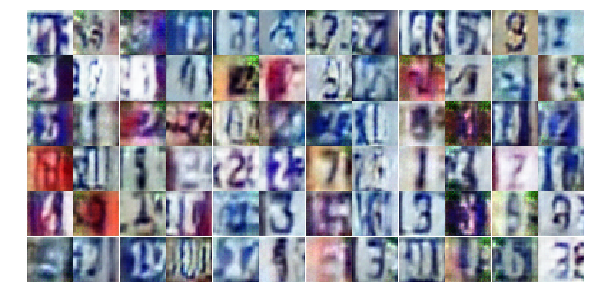

Epoch 8/25... Discriminator Loss: 0.3067... Generator Loss: 2.4063
Epoch 8/25... Discriminator Loss: 0.7001... Generator Loss: 1.5333
Epoch 8/25... Discriminator Loss: 0.2731... Generator Loss: 1.9637
Epoch 8/25... Discriminator Loss: 0.4290... Generator Loss: 1.5221
Epoch 8/25... Discriminator Loss: 0.4464... Generator Loss: 4.1902
Epoch 8/25... Discriminator Loss: 0.4629... Generator Loss: 1.6148
Epoch 8/25... Discriminator Loss: 0.9683... Generator Loss: 0.6241
Epoch 8/25... Discriminator Loss: 0.1789... Generator Loss: 2.6520
Epoch 8/25... Discriminator Loss: 0.2353... Generator Loss: 2.4997
Epoch 8/25... Discriminator Loss: 0.2956... Generator Loss: 2.0538


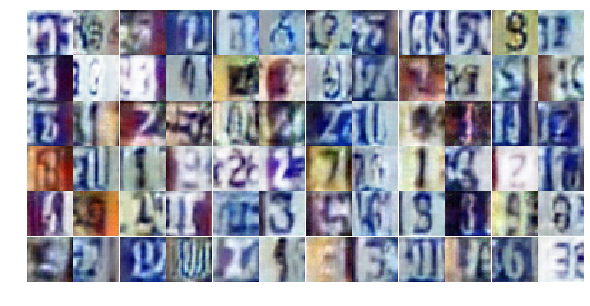

Epoch 8/25... Discriminator Loss: 0.8208... Generator Loss: 0.7126
Epoch 8/25... Discriminator Loss: 0.2712... Generator Loss: 1.8961
Epoch 8/25... Discriminator Loss: 0.0961... Generator Loss: 3.7129
Epoch 8/25... Discriminator Loss: 0.3346... Generator Loss: 4.0271
Epoch 8/25... Discriminator Loss: 0.8133... Generator Loss: 7.0759
Epoch 8/25... Discriminator Loss: 0.7581... Generator Loss: 0.8285
Epoch 8/25... Discriminator Loss: 0.3809... Generator Loss: 1.6622
Epoch 8/25... Discriminator Loss: 0.2840... Generator Loss: 2.9233
Epoch 9/25... Discriminator Loss: 0.4736... Generator Loss: 1.2866
Epoch 9/25... Discriminator Loss: 0.3651... Generator Loss: 1.5345


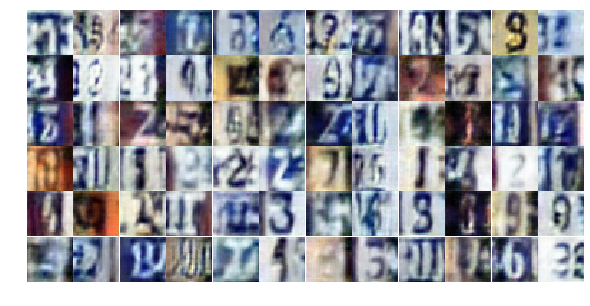

Epoch 9/25... Discriminator Loss: 0.2725... Generator Loss: 1.9474
Epoch 9/25... Discriminator Loss: 0.2690... Generator Loss: 4.7190
Epoch 9/25... Discriminator Loss: 0.4371... Generator Loss: 1.7021
Epoch 9/25... Discriminator Loss: 1.1097... Generator Loss: 0.5302
Epoch 9/25... Discriminator Loss: 0.8055... Generator Loss: 0.8753
Epoch 9/25... Discriminator Loss: 0.2271... Generator Loss: 2.4477
Epoch 9/25... Discriminator Loss: 1.1358... Generator Loss: 0.4865
Epoch 9/25... Discriminator Loss: 0.1423... Generator Loss: 3.1970
Epoch 9/25... Discriminator Loss: 0.3815... Generator Loss: 1.6507
Epoch 9/25... Discriminator Loss: 0.5278... Generator Loss: 3.4080


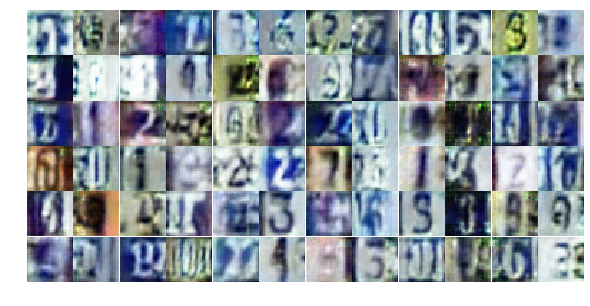

Epoch 9/25... Discriminator Loss: 0.6644... Generator Loss: 0.9723
Epoch 9/25... Discriminator Loss: 0.6482... Generator Loss: 1.0033
Epoch 9/25... Discriminator Loss: 0.7703... Generator Loss: 0.8541
Epoch 9/25... Discriminator Loss: 0.3148... Generator Loss: 2.0430
Epoch 9/25... Discriminator Loss: 0.5347... Generator Loss: 1.1490
Epoch 9/25... Discriminator Loss: 1.4512... Generator Loss: 0.3554
Epoch 9/25... Discriminator Loss: 0.4490... Generator Loss: 1.4443
Epoch 9/25... Discriminator Loss: 0.2255... Generator Loss: 2.0348
Epoch 9/25... Discriminator Loss: 0.3918... Generator Loss: 3.0587
Epoch 9/25... Discriminator Loss: 0.3261... Generator Loss: 1.6664


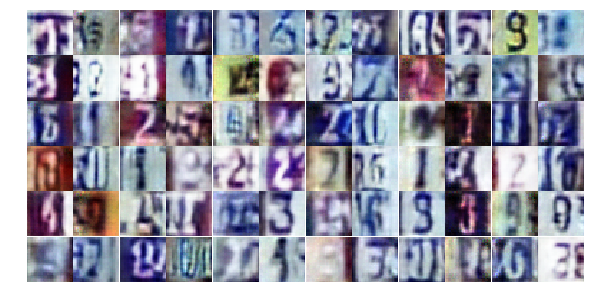

Epoch 9/25... Discriminator Loss: 0.9109... Generator Loss: 0.7843
Epoch 9/25... Discriminator Loss: 0.7531... Generator Loss: 0.7882
Epoch 9/25... Discriminator Loss: 0.4146... Generator Loss: 4.9824
Epoch 9/25... Discriminator Loss: 0.8522... Generator Loss: 0.7603
Epoch 9/25... Discriminator Loss: 0.2995... Generator Loss: 4.0314
Epoch 9/25... Discriminator Loss: 0.1718... Generator Loss: 2.6647
Epoch 9/25... Discriminator Loss: 0.8284... Generator Loss: 0.8227
Epoch 9/25... Discriminator Loss: 0.2536... Generator Loss: 3.2650
Epoch 9/25... Discriminator Loss: 0.2350... Generator Loss: 3.0910
Epoch 9/25... Discriminator Loss: 0.2578... Generator Loss: 1.9447


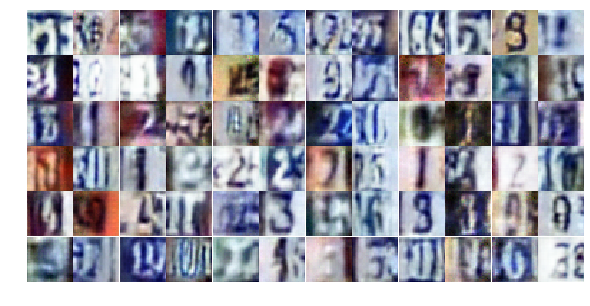

Epoch 9/25... Discriminator Loss: 0.4897... Generator Loss: 1.2635
Epoch 9/25... Discriminator Loss: 0.2105... Generator Loss: 3.2659
Epoch 9/25... Discriminator Loss: 1.3438... Generator Loss: 0.4530
Epoch 9/25... Discriminator Loss: 0.2843... Generator Loss: 1.8728
Epoch 9/25... Discriminator Loss: 0.5509... Generator Loss: 1.2596
Epoch 9/25... Discriminator Loss: 2.4936... Generator Loss: 3.5691
Epoch 9/25... Discriminator Loss: 1.7030... Generator Loss: 2.4120
Epoch 9/25... Discriminator Loss: 0.8394... Generator Loss: 1.9941
Epoch 9/25... Discriminator Loss: 1.2892... Generator Loss: 0.4838
Epoch 9/25... Discriminator Loss: 0.5644... Generator Loss: 1.5752


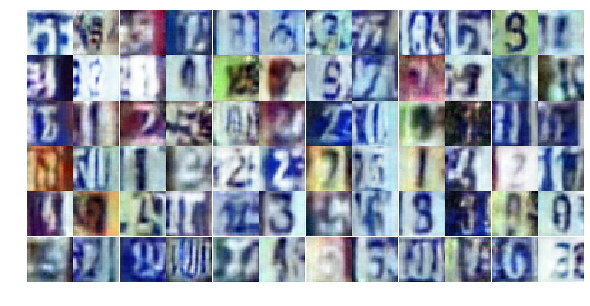

Epoch 9/25... Discriminator Loss: 0.5665... Generator Loss: 1.7948
Epoch 9/25... Discriminator Loss: 0.7924... Generator Loss: 0.8922
Epoch 9/25... Discriminator Loss: 0.4300... Generator Loss: 1.7800
Epoch 9/25... Discriminator Loss: 0.5498... Generator Loss: 2.7615
Epoch 9/25... Discriminator Loss: 0.8323... Generator Loss: 0.7636
Epoch 9/25... Discriminator Loss: 0.3574... Generator Loss: 1.7060
Epoch 9/25... Discriminator Loss: 0.4575... Generator Loss: 1.6078
Epoch 9/25... Discriminator Loss: 0.4437... Generator Loss: 1.5260
Epoch 9/25... Discriminator Loss: 0.3014... Generator Loss: 2.1541
Epoch 9/25... Discriminator Loss: 0.3869... Generator Loss: 2.0667


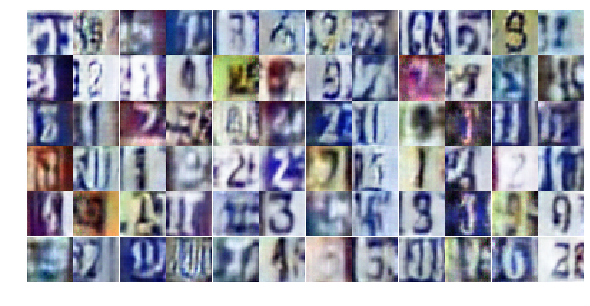

Epoch 9/25... Discriminator Loss: 0.8584... Generator Loss: 0.7965
Epoch 9/25... Discriminator Loss: 0.3906... Generator Loss: 2.6824
Epoch 9/25... Discriminator Loss: 0.6278... Generator Loss: 1.0504
Epoch 9/25... Discriminator Loss: 1.5985... Generator Loss: 0.2833
Epoch 9/25... Discriminator Loss: 0.9497... Generator Loss: 0.6745
Epoch 10/25... Discriminator Loss: 0.2982... Generator Loss: 2.1707
Epoch 10/25... Discriminator Loss: 0.6153... Generator Loss: 2.3506
Epoch 10/25... Discriminator Loss: 0.9679... Generator Loss: 0.6156
Epoch 10/25... Discriminator Loss: 0.7879... Generator Loss: 0.8505
Epoch 10/25... Discriminator Loss: 0.7418... Generator Loss: 0.8431


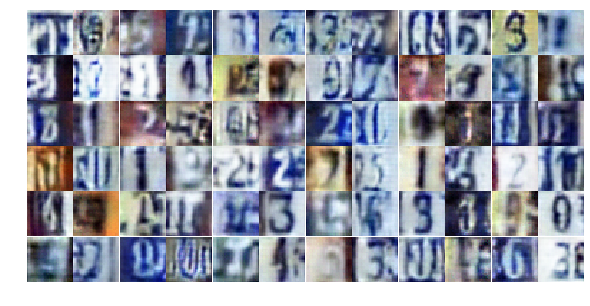

Epoch 10/25... Discriminator Loss: 0.4586... Generator Loss: 1.2810
Epoch 10/25... Discriminator Loss: 0.4555... Generator Loss: 1.3413
Epoch 10/25... Discriminator Loss: 0.4251... Generator Loss: 1.4686
Epoch 10/25... Discriminator Loss: 0.4451... Generator Loss: 1.4905
Epoch 10/25... Discriminator Loss: 0.7646... Generator Loss: 3.4574
Epoch 10/25... Discriminator Loss: 0.4491... Generator Loss: 1.5775
Epoch 10/25... Discriminator Loss: 0.4207... Generator Loss: 1.5158
Epoch 10/25... Discriminator Loss: 0.3547... Generator Loss: 1.6852
Epoch 10/25... Discriminator Loss: 1.1214... Generator Loss: 0.5151
Epoch 10/25... Discriminator Loss: 0.2730... Generator Loss: 2.4951


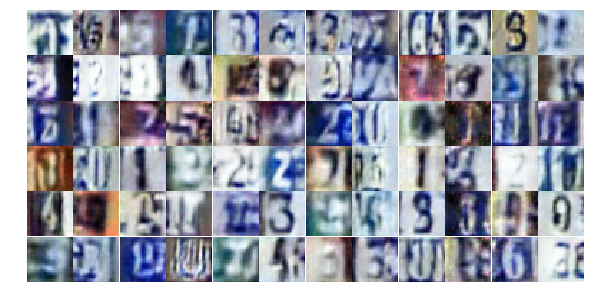

Epoch 10/25... Discriminator Loss: 0.2742... Generator Loss: 2.7066
Epoch 10/25... Discriminator Loss: 0.3313... Generator Loss: 1.9552
Epoch 10/25... Discriminator Loss: 0.2014... Generator Loss: 2.6500
Epoch 10/25... Discriminator Loss: 1.3213... Generator Loss: 0.4177
Epoch 10/25... Discriminator Loss: 1.4093... Generator Loss: 0.3880
Epoch 10/25... Discriminator Loss: 0.6559... Generator Loss: 1.0121
Epoch 10/25... Discriminator Loss: 1.3567... Generator Loss: 0.4351
Epoch 10/25... Discriminator Loss: 0.2892... Generator Loss: 2.1832
Epoch 10/25... Discriminator Loss: 0.8241... Generator Loss: 0.7742
Epoch 10/25... Discriminator Loss: 0.4356... Generator Loss: 1.4128


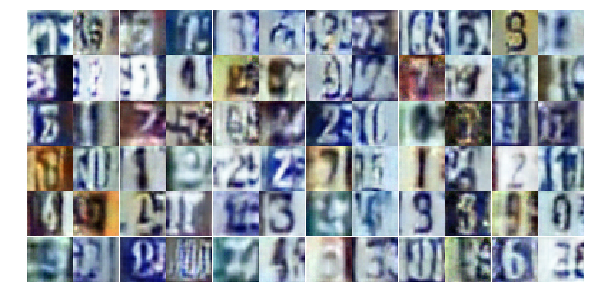

Epoch 10/25... Discriminator Loss: 0.5525... Generator Loss: 1.1111
Epoch 10/25... Discriminator Loss: 0.5007... Generator Loss: 1.3905
Epoch 10/25... Discriminator Loss: 0.7270... Generator Loss: 0.7975
Epoch 10/25... Discriminator Loss: 0.2780... Generator Loss: 1.9202
Epoch 10/25... Discriminator Loss: 1.6105... Generator Loss: 0.3048
Epoch 10/25... Discriminator Loss: 0.8208... Generator Loss: 0.8130
Epoch 10/25... Discriminator Loss: 0.2556... Generator Loss: 2.0840
Epoch 10/25... Discriminator Loss: 0.6463... Generator Loss: 1.9678
Epoch 10/25... Discriminator Loss: 0.3533... Generator Loss: 1.6704
Epoch 10/25... Discriminator Loss: 0.4514... Generator Loss: 1.4642


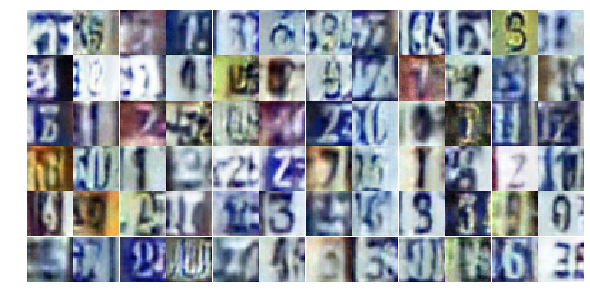

Epoch 10/25... Discriminator Loss: 0.7385... Generator Loss: 0.9722
Epoch 10/25... Discriminator Loss: 1.3188... Generator Loss: 0.4991
Epoch 10/25... Discriminator Loss: 3.1205... Generator Loss: 5.1975
Epoch 10/25... Discriminator Loss: 1.3492... Generator Loss: 0.4739
Epoch 10/25... Discriminator Loss: 1.0645... Generator Loss: 0.6460
Epoch 10/25... Discriminator Loss: 0.6579... Generator Loss: 0.9569
Epoch 10/25... Discriminator Loss: 0.6870... Generator Loss: 0.9420
Epoch 10/25... Discriminator Loss: 0.6170... Generator Loss: 1.1073
Epoch 10/25... Discriminator Loss: 0.4185... Generator Loss: 1.4188
Epoch 10/25... Discriminator Loss: 0.4618... Generator Loss: 1.3669


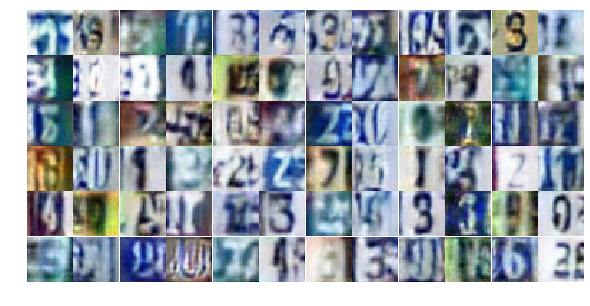

Epoch 10/25... Discriminator Loss: 0.6861... Generator Loss: 0.9273
Epoch 10/25... Discriminator Loss: 0.3989... Generator Loss: 1.9223
Epoch 10/25... Discriminator Loss: 0.5957... Generator Loss: 1.1537
Epoch 10/25... Discriminator Loss: 0.6587... Generator Loss: 1.0093
Epoch 10/25... Discriminator Loss: 0.6000... Generator Loss: 1.1457
Epoch 10/25... Discriminator Loss: 0.9087... Generator Loss: 0.7005
Epoch 10/25... Discriminator Loss: 0.4176... Generator Loss: 1.4684
Epoch 10/25... Discriminator Loss: 1.2102... Generator Loss: 3.7639
Epoch 10/25... Discriminator Loss: 1.1065... Generator Loss: 2.7538
Epoch 10/25... Discriminator Loss: 0.6512... Generator Loss: 2.0339


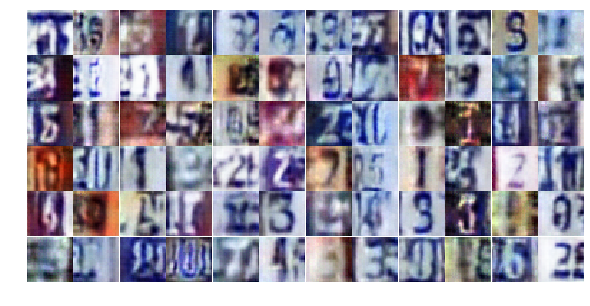

Epoch 10/25... Discriminator Loss: 0.8000... Generator Loss: 1.0817
Epoch 10/25... Discriminator Loss: 0.6523... Generator Loss: 1.6722
Epoch 10/25... Discriminator Loss: 0.8798... Generator Loss: 0.7529
Epoch 11/25... Discriminator Loss: 1.1133... Generator Loss: 0.5386
Epoch 11/25... Discriminator Loss: 0.7491... Generator Loss: 0.8235
Epoch 11/25... Discriminator Loss: 1.2533... Generator Loss: 0.4253
Epoch 11/25... Discriminator Loss: 0.7918... Generator Loss: 0.8544
Epoch 11/25... Discriminator Loss: 0.4435... Generator Loss: 1.6924
Epoch 11/25... Discriminator Loss: 1.0243... Generator Loss: 0.6432
Epoch 11/25... Discriminator Loss: 0.3266... Generator Loss: 2.2562


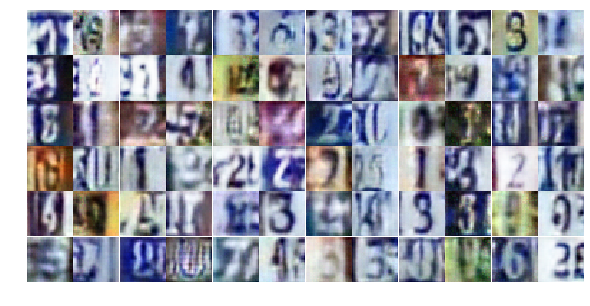

Epoch 11/25... Discriminator Loss: 0.2448... Generator Loss: 2.6555
Epoch 11/25... Discriminator Loss: 0.5041... Generator Loss: 1.3732
Epoch 11/25... Discriminator Loss: 0.3341... Generator Loss: 1.6498
Epoch 11/25... Discriminator Loss: 0.4039... Generator Loss: 1.6018
Epoch 11/25... Discriminator Loss: 0.5382... Generator Loss: 1.7780
Epoch 11/25... Discriminator Loss: 0.3294... Generator Loss: 1.8762
Epoch 11/25... Discriminator Loss: 0.4223... Generator Loss: 1.6448
Epoch 11/25... Discriminator Loss: 0.2363... Generator Loss: 2.3231
Epoch 11/25... Discriminator Loss: 0.3737... Generator Loss: 1.6220
Epoch 11/25... Discriminator Loss: 0.8195... Generator Loss: 0.8998


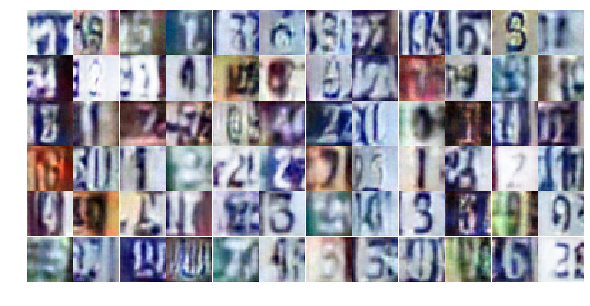

Epoch 11/25... Discriminator Loss: 0.8149... Generator Loss: 0.7728
Epoch 11/25... Discriminator Loss: 0.6218... Generator Loss: 1.9315
Epoch 11/25... Discriminator Loss: 0.4009... Generator Loss: 1.4796
Epoch 11/25... Discriminator Loss: 0.4196... Generator Loss: 1.5037
Epoch 11/25... Discriminator Loss: 0.1381... Generator Loss: 3.2224
Epoch 11/25... Discriminator Loss: 0.3331... Generator Loss: 2.1478
Epoch 11/25... Discriminator Loss: 0.3804... Generator Loss: 1.7385
Epoch 11/25... Discriminator Loss: 0.8356... Generator Loss: 0.8186
Epoch 11/25... Discriminator Loss: 0.3345... Generator Loss: 1.8340
Epoch 11/25... Discriminator Loss: 0.7417... Generator Loss: 0.9187


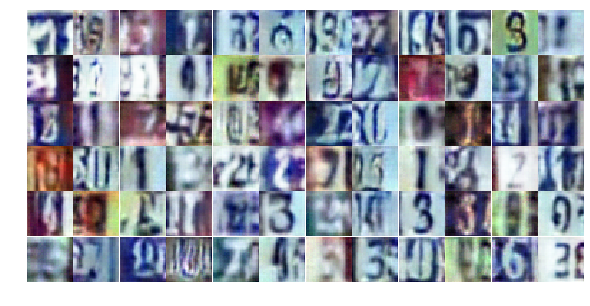

Epoch 11/25... Discriminator Loss: 0.4926... Generator Loss: 1.3195
Epoch 11/25... Discriminator Loss: 0.3612... Generator Loss: 1.9755
Epoch 11/25... Discriminator Loss: 0.4147... Generator Loss: 1.4582
Epoch 11/25... Discriminator Loss: 0.3128... Generator Loss: 1.6888
Epoch 11/25... Discriminator Loss: 0.3297... Generator Loss: 1.9597
Epoch 11/25... Discriminator Loss: 1.4977... Generator Loss: 0.3358
Epoch 11/25... Discriminator Loss: 0.4049... Generator Loss: 3.2743
Epoch 11/25... Discriminator Loss: 1.8973... Generator Loss: 0.9665
Epoch 11/25... Discriminator Loss: 0.8746... Generator Loss: 1.9714
Epoch 11/25... Discriminator Loss: 0.8919... Generator Loss: 1.1725


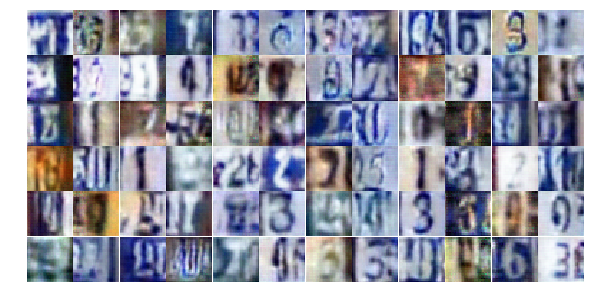

Epoch 11/25... Discriminator Loss: 0.9562... Generator Loss: 0.9176
Epoch 11/25... Discriminator Loss: 0.3080... Generator Loss: 2.1453
Epoch 11/25... Discriminator Loss: 0.9068... Generator Loss: 0.7322
Epoch 11/25... Discriminator Loss: 0.6742... Generator Loss: 1.1588
Epoch 11/25... Discriminator Loss: 0.7888... Generator Loss: 0.9714
Epoch 11/25... Discriminator Loss: 0.5331... Generator Loss: 1.3904
Epoch 11/25... Discriminator Loss: 0.7124... Generator Loss: 1.1246
Epoch 11/25... Discriminator Loss: 0.6080... Generator Loss: 1.0219
Epoch 11/25... Discriminator Loss: 1.1399... Generator Loss: 0.5087
Epoch 11/25... Discriminator Loss: 0.5471... Generator Loss: 1.1914


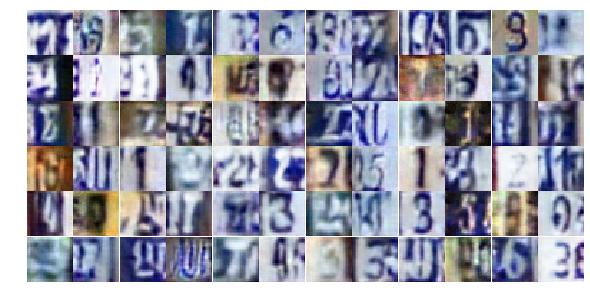

Epoch 11/25... Discriminator Loss: 0.8853... Generator Loss: 0.7122
Epoch 11/25... Discriminator Loss: 0.2891... Generator Loss: 2.0783
Epoch 11/25... Discriminator Loss: 0.4562... Generator Loss: 1.8224
Epoch 11/25... Discriminator Loss: 0.2496... Generator Loss: 2.4798
Epoch 11/25... Discriminator Loss: 0.8458... Generator Loss: 0.8044
Epoch 11/25... Discriminator Loss: 0.4977... Generator Loss: 1.2069
Epoch 11/25... Discriminator Loss: 1.3922... Generator Loss: 0.4369
Epoch 11/25... Discriminator Loss: 0.4120... Generator Loss: 2.0496
Epoch 11/25... Discriminator Loss: 1.0494... Generator Loss: 0.6397
Epoch 11/25... Discriminator Loss: 0.3634... Generator Loss: 1.7958


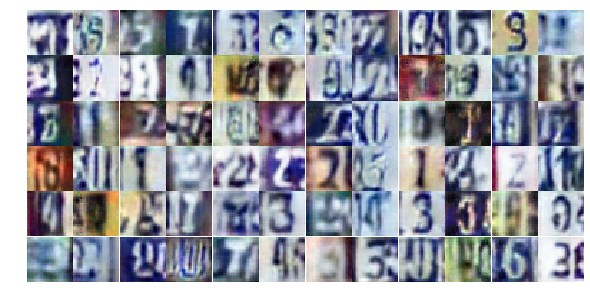

Epoch 12/25... Discriminator Loss: 0.5103... Generator Loss: 1.7903
Epoch 12/25... Discriminator Loss: 0.3606... Generator Loss: 1.8791
Epoch 12/25... Discriminator Loss: 0.6468... Generator Loss: 1.1495
Epoch 12/25... Discriminator Loss: 0.3141... Generator Loss: 1.9111
Epoch 12/25... Discriminator Loss: 0.3998... Generator Loss: 1.7388
Epoch 12/25... Discriminator Loss: 0.9026... Generator Loss: 0.6846
Epoch 12/25... Discriminator Loss: 0.2654... Generator Loss: 2.5355
Epoch 12/25... Discriminator Loss: 0.4944... Generator Loss: 1.3454
Epoch 12/25... Discriminator Loss: 0.4198... Generator Loss: 2.0786
Epoch 12/25... Discriminator Loss: 1.7033... Generator Loss: 0.3392


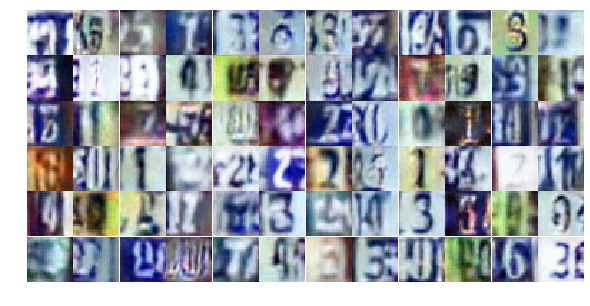

Epoch 12/25... Discriminator Loss: 0.4655... Generator Loss: 1.9139
Epoch 12/25... Discriminator Loss: 0.4683... Generator Loss: 1.3463
Epoch 12/25... Discriminator Loss: 0.2117... Generator Loss: 2.5175
Epoch 12/25... Discriminator Loss: 0.1908... Generator Loss: 2.8862
Epoch 12/25... Discriminator Loss: 0.8936... Generator Loss: 0.8458
Epoch 12/25... Discriminator Loss: 0.9214... Generator Loss: 0.7144
Epoch 12/25... Discriminator Loss: 1.9804... Generator Loss: 0.2241
Epoch 12/25... Discriminator Loss: 0.4000... Generator Loss: 1.8308
Epoch 12/25... Discriminator Loss: 0.4971... Generator Loss: 1.5084
Epoch 12/25... Discriminator Loss: 0.4470... Generator Loss: 1.5597


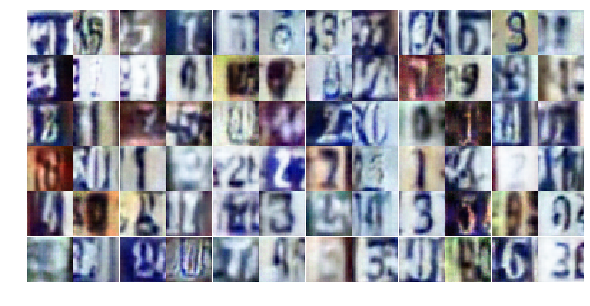

Epoch 12/25... Discriminator Loss: 0.3514... Generator Loss: 2.8417
Epoch 12/25... Discriminator Loss: 0.3989... Generator Loss: 1.8499
Epoch 12/25... Discriminator Loss: 0.1829... Generator Loss: 2.5652
Epoch 12/25... Discriminator Loss: 0.5029... Generator Loss: 1.2640
Epoch 12/25... Discriminator Loss: 0.3003... Generator Loss: 1.9374
Epoch 12/25... Discriminator Loss: 0.2446... Generator Loss: 1.9502
Epoch 12/25... Discriminator Loss: 0.4213... Generator Loss: 1.5816
Epoch 12/25... Discriminator Loss: 0.1623... Generator Loss: 3.0150
Epoch 12/25... Discriminator Loss: 0.3055... Generator Loss: 1.6968
Epoch 12/25... Discriminator Loss: 1.3750... Generator Loss: 0.4108


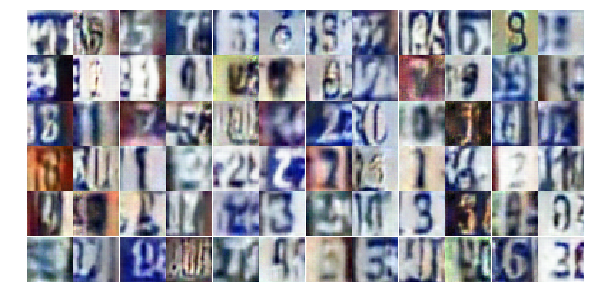

Epoch 12/25... Discriminator Loss: 0.3253... Generator Loss: 1.8423
Epoch 12/25... Discriminator Loss: 0.8713... Generator Loss: 0.8187
Epoch 12/25... Discriminator Loss: 0.5335... Generator Loss: 1.1223
Epoch 12/25... Discriminator Loss: 1.3601... Generator Loss: 0.4083
Epoch 12/25... Discriminator Loss: 0.6904... Generator Loss: 1.0765
Epoch 12/25... Discriminator Loss: 1.5402... Generator Loss: 0.3847
Epoch 12/25... Discriminator Loss: 0.6610... Generator Loss: 1.0693
Epoch 12/25... Discriminator Loss: 1.2777... Generator Loss: 0.4909
Epoch 12/25... Discriminator Loss: 0.3714... Generator Loss: 1.8533
Epoch 12/25... Discriminator Loss: 0.1596... Generator Loss: 2.5616


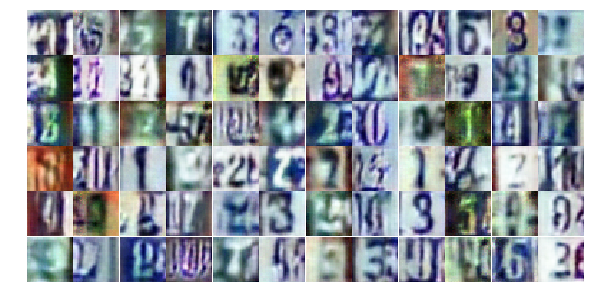

Epoch 12/25... Discriminator Loss: 0.4467... Generator Loss: 1.3412
Epoch 12/25... Discriminator Loss: 0.1804... Generator Loss: 2.7619
Epoch 12/25... Discriminator Loss: 0.3343... Generator Loss: 1.8053
Epoch 12/25... Discriminator Loss: 0.4748... Generator Loss: 2.5112
Epoch 12/25... Discriminator Loss: 1.7217... Generator Loss: 0.2987
Epoch 12/25... Discriminator Loss: 1.1024... Generator Loss: 0.5700
Epoch 12/25... Discriminator Loss: 0.5803... Generator Loss: 1.1831
Epoch 12/25... Discriminator Loss: 0.4519... Generator Loss: 1.4460
Epoch 12/25... Discriminator Loss: 0.4562... Generator Loss: 1.6594
Epoch 12/25... Discriminator Loss: 0.4403... Generator Loss: 2.0035


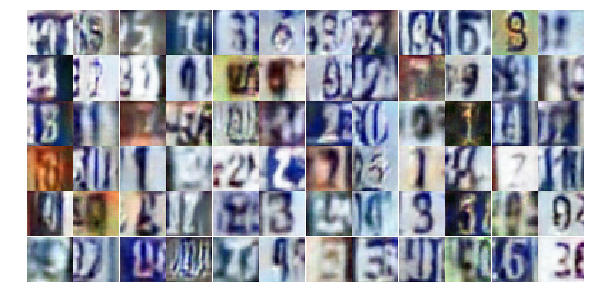

Epoch 12/25... Discriminator Loss: 0.4558... Generator Loss: 1.8135
Epoch 12/25... Discriminator Loss: 0.7699... Generator Loss: 0.8280
Epoch 12/25... Discriminator Loss: 2.6993... Generator Loss: 2.7842
Epoch 12/25... Discriminator Loss: 1.5065... Generator Loss: 0.6560
Epoch 12/25... Discriminator Loss: 1.2247... Generator Loss: 1.2897
Epoch 12/25... Discriminator Loss: 1.5598... Generator Loss: 2.0446
Epoch 12/25... Discriminator Loss: 0.9798... Generator Loss: 0.8169
Epoch 13/25... Discriminator Loss: 0.8776... Generator Loss: 1.8999
Epoch 13/25... Discriminator Loss: 0.7311... Generator Loss: 1.2099
Epoch 13/25... Discriminator Loss: 1.0060... Generator Loss: 0.7667


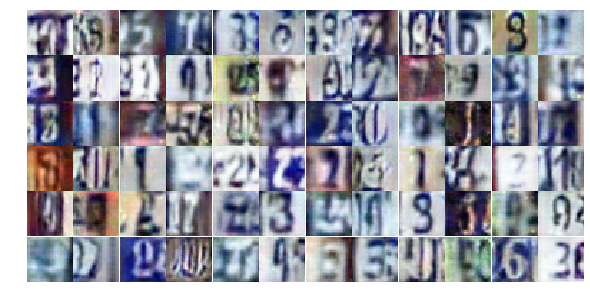

Epoch 13/25... Discriminator Loss: 0.7599... Generator Loss: 1.0103
Epoch 13/25... Discriminator Loss: 0.6064... Generator Loss: 1.5177
Epoch 13/25... Discriminator Loss: 1.1259... Generator Loss: 0.5129
Epoch 13/25... Discriminator Loss: 1.0051... Generator Loss: 0.8995
Epoch 13/25... Discriminator Loss: 0.7957... Generator Loss: 0.8873
Epoch 13/25... Discriminator Loss: 0.5196... Generator Loss: 1.5756
Epoch 13/25... Discriminator Loss: 0.4685... Generator Loss: 1.7159
Epoch 13/25... Discriminator Loss: 0.7117... Generator Loss: 0.9118
Epoch 13/25... Discriminator Loss: 0.4868... Generator Loss: 1.2510
Epoch 13/25... Discriminator Loss: 0.4907... Generator Loss: 2.3276


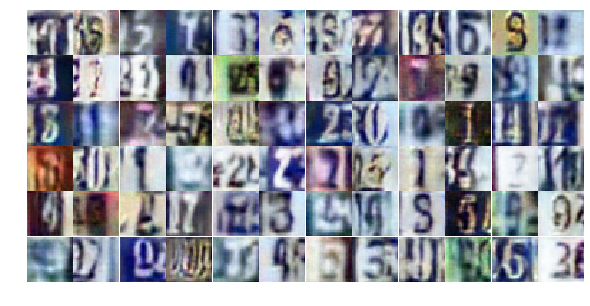

Epoch 13/25... Discriminator Loss: 0.7189... Generator Loss: 2.2662
Epoch 13/25... Discriminator Loss: 0.5049... Generator Loss: 1.6915
Epoch 13/25... Discriminator Loss: 0.7560... Generator Loss: 0.9443
Epoch 13/25... Discriminator Loss: 0.5260... Generator Loss: 1.3645
Epoch 13/25... Discriminator Loss: 0.4929... Generator Loss: 1.8673
Epoch 13/25... Discriminator Loss: 0.7658... Generator Loss: 1.3457
Epoch 13/25... Discriminator Loss: 0.5464... Generator Loss: 1.3373
Epoch 13/25... Discriminator Loss: 1.0616... Generator Loss: 0.5885
Epoch 13/25... Discriminator Loss: 0.6511... Generator Loss: 1.0765
Epoch 13/25... Discriminator Loss: 0.8391... Generator Loss: 0.8228


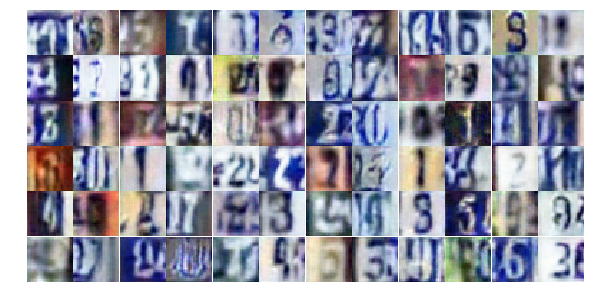

Epoch 13/25... Discriminator Loss: 0.8421... Generator Loss: 0.7981
Epoch 13/25... Discriminator Loss: 0.3871... Generator Loss: 2.1312
Epoch 13/25... Discriminator Loss: 0.7182... Generator Loss: 0.9542
Epoch 13/25... Discriminator Loss: 0.7078... Generator Loss: 0.9445
Epoch 13/25... Discriminator Loss: 0.5229... Generator Loss: 1.3852
Epoch 13/25... Discriminator Loss: 0.5241... Generator Loss: 1.2733
Epoch 13/25... Discriminator Loss: 1.0924... Generator Loss: 3.5104
Epoch 13/25... Discriminator Loss: 0.4517... Generator Loss: 1.6442
Epoch 13/25... Discriminator Loss: 0.4884... Generator Loss: 1.5152
Epoch 13/25... Discriminator Loss: 0.3647... Generator Loss: 1.9321


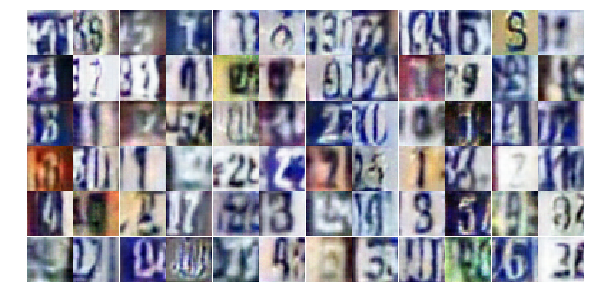

Epoch 13/25... Discriminator Loss: 0.8245... Generator Loss: 0.7842
Epoch 13/25... Discriminator Loss: 0.8376... Generator Loss: 2.3523
Epoch 13/25... Discriminator Loss: 0.8348... Generator Loss: 0.9530
Epoch 13/25... Discriminator Loss: 1.4180... Generator Loss: 0.3968
Epoch 13/25... Discriminator Loss: 0.3793... Generator Loss: 1.8621
Epoch 13/25... Discriminator Loss: 0.3104... Generator Loss: 2.6493
Epoch 13/25... Discriminator Loss: 0.4676... Generator Loss: 1.2701
Epoch 13/25... Discriminator Loss: 0.6807... Generator Loss: 1.0809
Epoch 13/25... Discriminator Loss: 0.6827... Generator Loss: 0.9748
Epoch 13/25... Discriminator Loss: 0.5493... Generator Loss: 1.1558


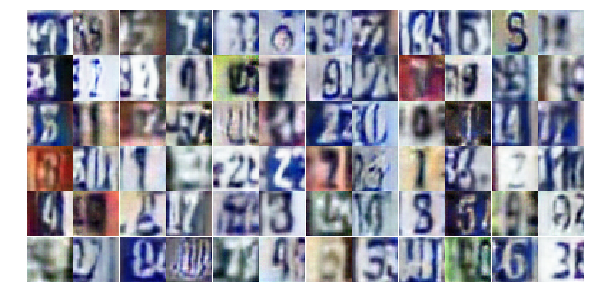

Epoch 13/25... Discriminator Loss: 0.4571... Generator Loss: 1.5304
Epoch 13/25... Discriminator Loss: 0.7425... Generator Loss: 2.7499
Epoch 13/25... Discriminator Loss: 0.9371... Generator Loss: 0.7426
Epoch 13/25... Discriminator Loss: 0.2188... Generator Loss: 3.0548
Epoch 13/25... Discriminator Loss: 0.7471... Generator Loss: 0.8337
Epoch 13/25... Discriminator Loss: 0.6205... Generator Loss: 1.3938
Epoch 13/25... Discriminator Loss: 0.5415... Generator Loss: 1.1749
Epoch 13/25... Discriminator Loss: 0.3692... Generator Loss: 1.7924
Epoch 13/25... Discriminator Loss: 0.3728... Generator Loss: 1.8270
Epoch 13/25... Discriminator Loss: 0.6871... Generator Loss: 1.0436


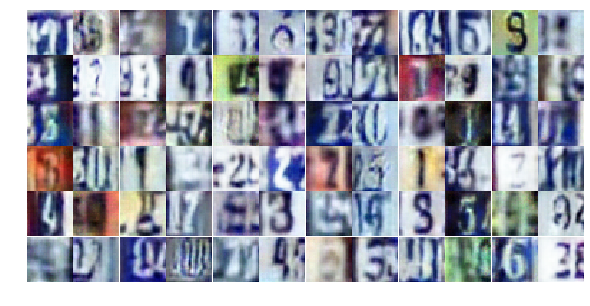

Epoch 13/25... Discriminator Loss: 0.1908... Generator Loss: 3.4492
Epoch 13/25... Discriminator Loss: 1.8650... Generator Loss: 0.2350
Epoch 13/25... Discriminator Loss: 0.7478... Generator Loss: 2.4809
Epoch 13/25... Discriminator Loss: 0.6657... Generator Loss: 1.1877
Epoch 14/25... Discriminator Loss: 0.7074... Generator Loss: 1.1569
Epoch 14/25... Discriminator Loss: 0.6586... Generator Loss: 1.3598
Epoch 14/25... Discriminator Loss: 0.6043... Generator Loss: 1.1986
Epoch 14/25... Discriminator Loss: 0.4799... Generator Loss: 1.6680
Epoch 14/25... Discriminator Loss: 0.4625... Generator Loss: 1.5627
Epoch 14/25... Discriminator Loss: 1.1556... Generator Loss: 0.5075


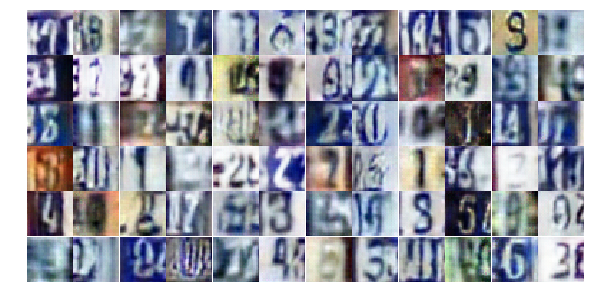

Epoch 14/25... Discriminator Loss: 0.7370... Generator Loss: 0.8473
Epoch 14/25... Discriminator Loss: 0.5126... Generator Loss: 1.2533
Epoch 14/25... Discriminator Loss: 0.7303... Generator Loss: 0.9827
Epoch 14/25... Discriminator Loss: 0.4018... Generator Loss: 1.9731
Epoch 14/25... Discriminator Loss: 0.8868... Generator Loss: 0.7075
Epoch 14/25... Discriminator Loss: 0.2020... Generator Loss: 2.1909
Epoch 14/25... Discriminator Loss: 0.2672... Generator Loss: 2.4273
Epoch 14/25... Discriminator Loss: 1.3101... Generator Loss: 0.4418
Epoch 14/25... Discriminator Loss: 0.7862... Generator Loss: 0.9909
Epoch 14/25... Discriminator Loss: 1.5481... Generator Loss: 0.3470


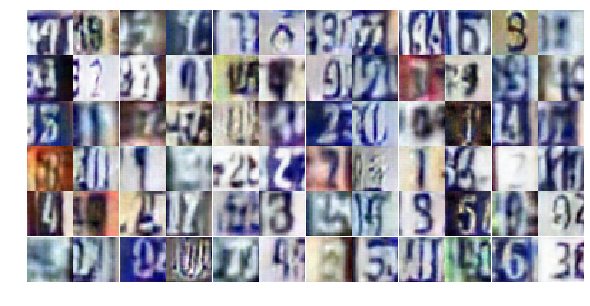

Epoch 14/25... Discriminator Loss: 0.3722... Generator Loss: 1.5481
Epoch 14/25... Discriminator Loss: 0.5041... Generator Loss: 2.2872
Epoch 14/25... Discriminator Loss: 0.5609... Generator Loss: 1.5734
Epoch 14/25... Discriminator Loss: 0.3937... Generator Loss: 2.0002
Epoch 14/25... Discriminator Loss: 0.7699... Generator Loss: 0.9029
Epoch 14/25... Discriminator Loss: 0.3164... Generator Loss: 2.0453
Epoch 14/25... Discriminator Loss: 0.5658... Generator Loss: 1.1817
Epoch 14/25... Discriminator Loss: 0.3666... Generator Loss: 1.5994
Epoch 14/25... Discriminator Loss: 0.6281... Generator Loss: 1.1113
Epoch 14/25... Discriminator Loss: 0.4231... Generator Loss: 1.6505


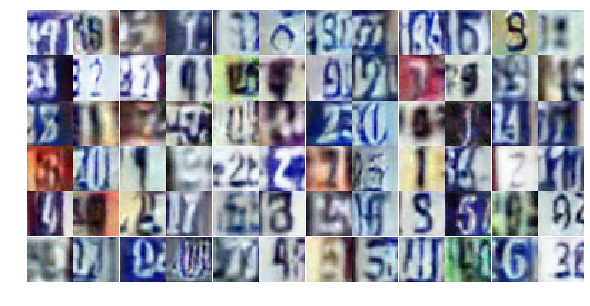

Epoch 14/25... Discriminator Loss: 1.3366... Generator Loss: 0.4122
Epoch 14/25... Discriminator Loss: 0.2568... Generator Loss: 1.8959
Epoch 14/25... Discriminator Loss: 0.6736... Generator Loss: 0.9243
Epoch 14/25... Discriminator Loss: 0.4361... Generator Loss: 1.5116
Epoch 14/25... Discriminator Loss: 0.7257... Generator Loss: 0.9454
Epoch 14/25... Discriminator Loss: 0.6768... Generator Loss: 0.9308
Epoch 14/25... Discriminator Loss: 0.5283... Generator Loss: 1.2471
Epoch 14/25... Discriminator Loss: 0.3545... Generator Loss: 1.8265
Epoch 14/25... Discriminator Loss: 0.3903... Generator Loss: 3.3385
Epoch 14/25... Discriminator Loss: 0.5906... Generator Loss: 1.3200


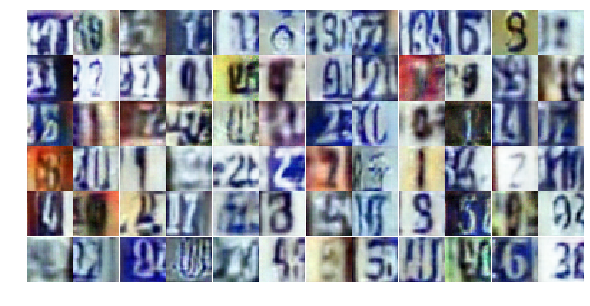

Epoch 14/25... Discriminator Loss: 1.1433... Generator Loss: 0.5403
Epoch 14/25... Discriminator Loss: 0.5801... Generator Loss: 1.2326
Epoch 14/25... Discriminator Loss: 0.6583... Generator Loss: 1.0506
Epoch 14/25... Discriminator Loss: 0.3110... Generator Loss: 2.0844
Epoch 14/25... Discriminator Loss: 0.4904... Generator Loss: 1.2724
Epoch 14/25... Discriminator Loss: 0.6189... Generator Loss: 1.2930
Epoch 14/25... Discriminator Loss: 0.6491... Generator Loss: 1.0564
Epoch 14/25... Discriminator Loss: 0.3372... Generator Loss: 1.7592
Epoch 14/25... Discriminator Loss: 1.8264... Generator Loss: 0.2522
Epoch 14/25... Discriminator Loss: 3.1194... Generator Loss: 0.2057


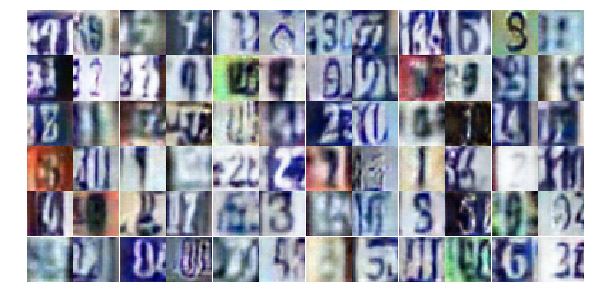

Epoch 14/25... Discriminator Loss: 2.2230... Generator Loss: 2.5952
Epoch 14/25... Discriminator Loss: 1.8076... Generator Loss: 0.2764
Epoch 14/25... Discriminator Loss: 0.7515... Generator Loss: 1.0315
Epoch 14/25... Discriminator Loss: 0.7009... Generator Loss: 1.0268
Epoch 14/25... Discriminator Loss: 0.7411... Generator Loss: 0.9516
Epoch 14/25... Discriminator Loss: 0.5610... Generator Loss: 1.2153
Epoch 14/25... Discriminator Loss: 0.7286... Generator Loss: 0.9126
Epoch 14/25... Discriminator Loss: 0.6980... Generator Loss: 0.9963
Epoch 14/25... Discriminator Loss: 0.8044... Generator Loss: 0.8402
Epoch 14/25... Discriminator Loss: 0.6077... Generator Loss: 1.0662


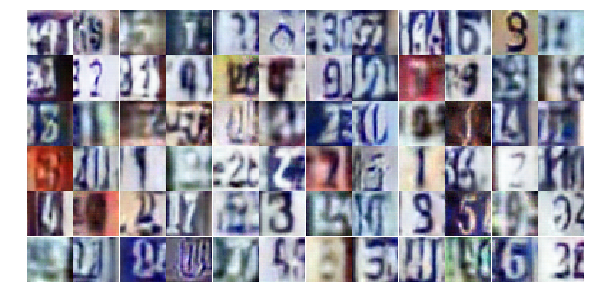

Epoch 14/25... Discriminator Loss: 0.7539... Generator Loss: 1.1226
Epoch 14/25... Discriminator Loss: 1.2030... Generator Loss: 0.5295
Epoch 15/25... Discriminator Loss: 0.5835... Generator Loss: 1.1435
Epoch 15/25... Discriminator Loss: 0.4058... Generator Loss: 1.8023
Epoch 15/25... Discriminator Loss: 0.4265... Generator Loss: 1.7290
Epoch 15/25... Discriminator Loss: 0.6634... Generator Loss: 1.0095
Epoch 15/25... Discriminator Loss: 0.5909... Generator Loss: 1.0967
Epoch 15/25... Discriminator Loss: 0.4085... Generator Loss: 1.6542
Epoch 15/25... Discriminator Loss: 1.2169... Generator Loss: 0.4988
Epoch 15/25... Discriminator Loss: 0.7146... Generator Loss: 0.9364


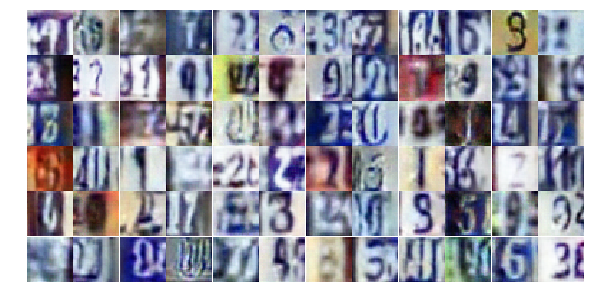

Epoch 15/25... Discriminator Loss: 0.6830... Generator Loss: 0.9927
Epoch 15/25... Discriminator Loss: 0.4077... Generator Loss: 2.3987
Epoch 15/25... Discriminator Loss: 0.7377... Generator Loss: 0.9578
Epoch 15/25... Discriminator Loss: 0.7749... Generator Loss: 0.8180
Epoch 15/25... Discriminator Loss: 1.1814... Generator Loss: 0.5044
Epoch 15/25... Discriminator Loss: 2.1897... Generator Loss: 0.1989
Epoch 15/25... Discriminator Loss: 0.6612... Generator Loss: 1.0204
Epoch 15/25... Discriminator Loss: 0.5867... Generator Loss: 1.1960
Epoch 15/25... Discriminator Loss: 0.4030... Generator Loss: 2.5356
Epoch 15/25... Discriminator Loss: 0.5754... Generator Loss: 1.1687


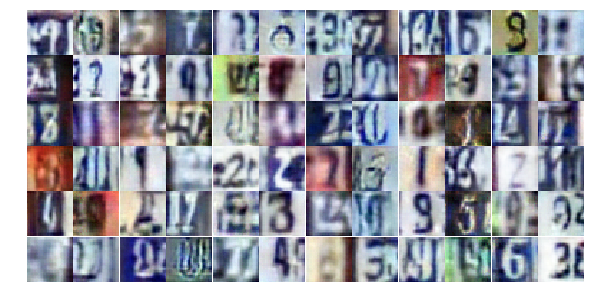

Epoch 15/25... Discriminator Loss: 0.3489... Generator Loss: 1.8005
Epoch 15/25... Discriminator Loss: 0.4595... Generator Loss: 1.4005
Epoch 15/25... Discriminator Loss: 0.5159... Generator Loss: 1.3215
Epoch 15/25... Discriminator Loss: 0.6847... Generator Loss: 1.1022
Epoch 15/25... Discriminator Loss: 0.9300... Generator Loss: 0.7149
Epoch 15/25... Discriminator Loss: 0.3215... Generator Loss: 1.7680
Epoch 15/25... Discriminator Loss: 0.8008... Generator Loss: 0.8259
Epoch 15/25... Discriminator Loss: 0.8577... Generator Loss: 0.7762
Epoch 15/25... Discriminator Loss: 0.5987... Generator Loss: 1.0540
Epoch 15/25... Discriminator Loss: 1.2910... Generator Loss: 0.4826


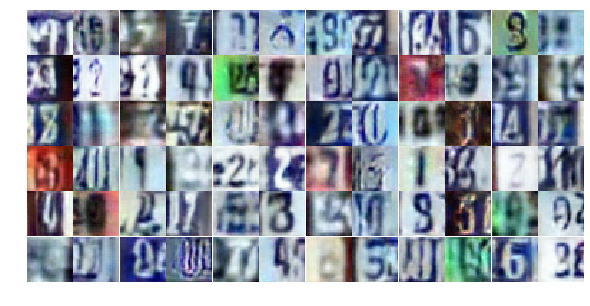

Epoch 15/25... Discriminator Loss: 0.4891... Generator Loss: 1.5170
Epoch 15/25... Discriminator Loss: 1.1593... Generator Loss: 0.5128
Epoch 15/25... Discriminator Loss: 0.5741... Generator Loss: 1.1848
Epoch 15/25... Discriminator Loss: 0.4537... Generator Loss: 1.4350
Epoch 15/25... Discriminator Loss: 0.5102... Generator Loss: 1.3775
Epoch 15/25... Discriminator Loss: 1.4612... Generator Loss: 3.8542
Epoch 15/25... Discriminator Loss: 0.7225... Generator Loss: 0.9803
Epoch 15/25... Discriminator Loss: 0.6904... Generator Loss: 0.9583
Epoch 15/25... Discriminator Loss: 0.3395... Generator Loss: 1.9646
Epoch 15/25... Discriminator Loss: 0.6060... Generator Loss: 2.3573


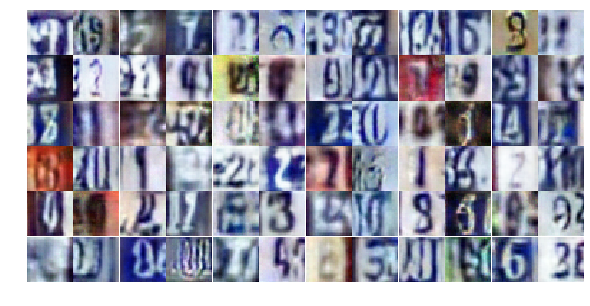

Epoch 15/25... Discriminator Loss: 0.4682... Generator Loss: 1.3566
Epoch 15/25... Discriminator Loss: 0.6774... Generator Loss: 1.0333
Epoch 15/25... Discriminator Loss: 1.6118... Generator Loss: 0.3314
Epoch 15/25... Discriminator Loss: 0.3840... Generator Loss: 1.7357
Epoch 15/25... Discriminator Loss: 0.7625... Generator Loss: 0.8685
Epoch 15/25... Discriminator Loss: 1.0257... Generator Loss: 0.6070
Epoch 15/25... Discriminator Loss: 0.4496... Generator Loss: 1.4904
Epoch 15/25... Discriminator Loss: 0.5219... Generator Loss: 1.3454
Epoch 15/25... Discriminator Loss: 0.5403... Generator Loss: 1.1927
Epoch 15/25... Discriminator Loss: 0.6664... Generator Loss: 1.0118


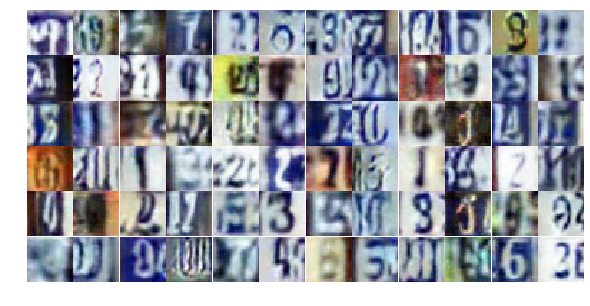

Epoch 15/25... Discriminator Loss: 0.6784... Generator Loss: 1.0159
Epoch 15/25... Discriminator Loss: 0.8045... Generator Loss: 0.7941
Epoch 15/25... Discriminator Loss: 0.4386... Generator Loss: 1.4041
Epoch 15/25... Discriminator Loss: 1.1710... Generator Loss: 0.5052
Epoch 15/25... Discriminator Loss: 2.6123... Generator Loss: 0.2047
Epoch 15/25... Discriminator Loss: 1.5382... Generator Loss: 2.3122
Epoch 15/25... Discriminator Loss: 1.7676... Generator Loss: 0.2540
Epoch 15/25... Discriminator Loss: 1.0102... Generator Loss: 0.7064
Epoch 15/25... Discriminator Loss: 1.1865... Generator Loss: 0.5866
Epoch 16/25... Discriminator Loss: 0.8919... Generator Loss: 0.7296


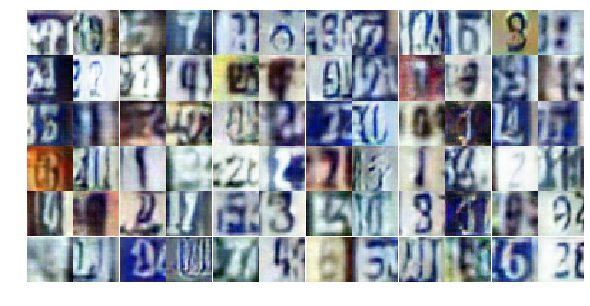

Epoch 16/25... Discriminator Loss: 0.6599... Generator Loss: 1.0747
Epoch 16/25... Discriminator Loss: 0.8796... Generator Loss: 0.8452
Epoch 16/25... Discriminator Loss: 1.2491... Generator Loss: 0.4652
Epoch 16/25... Discriminator Loss: 0.6153... Generator Loss: 1.4553
Epoch 16/25... Discriminator Loss: 0.6039... Generator Loss: 1.2492
Epoch 16/25... Discriminator Loss: 0.6976... Generator Loss: 1.8590
Epoch 16/25... Discriminator Loss: 1.5302... Generator Loss: 0.3625
Epoch 16/25... Discriminator Loss: 0.8019... Generator Loss: 0.8103
Epoch 16/25... Discriminator Loss: 0.7452... Generator Loss: 0.8972
Epoch 16/25... Discriminator Loss: 0.4479... Generator Loss: 1.4156


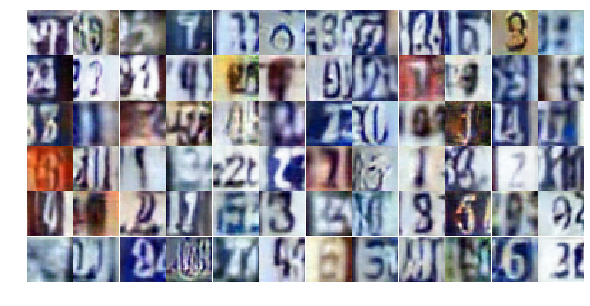

Epoch 16/25... Discriminator Loss: 1.0339... Generator Loss: 0.5867
Epoch 16/25... Discriminator Loss: 0.6155... Generator Loss: 1.4090
Epoch 16/25... Discriminator Loss: 0.6645... Generator Loss: 1.2000
Epoch 16/25... Discriminator Loss: 1.2485... Generator Loss: 0.4803
Epoch 16/25... Discriminator Loss: 0.8419... Generator Loss: 1.7141
Epoch 16/25... Discriminator Loss: 0.6144... Generator Loss: 1.2772
Epoch 16/25... Discriminator Loss: 1.7474... Generator Loss: 0.3254
Epoch 16/25... Discriminator Loss: 0.4853... Generator Loss: 1.4978
Epoch 16/25... Discriminator Loss: 0.4508... Generator Loss: 1.3780
Epoch 16/25... Discriminator Loss: 0.5125... Generator Loss: 1.2899


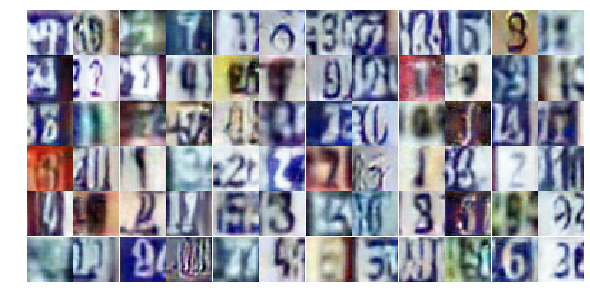

Epoch 16/25... Discriminator Loss: 1.0108... Generator Loss: 0.6790
Epoch 16/25... Discriminator Loss: 0.6567... Generator Loss: 1.6299
Epoch 16/25... Discriminator Loss: 0.7816... Generator Loss: 0.8890
Epoch 16/25... Discriminator Loss: 1.3771... Generator Loss: 0.4249
Epoch 16/25... Discriminator Loss: 0.4937... Generator Loss: 1.4545
Epoch 16/25... Discriminator Loss: 1.1471... Generator Loss: 0.5727
Epoch 16/25... Discriminator Loss: 0.7569... Generator Loss: 0.8779
Epoch 16/25... Discriminator Loss: 0.3053... Generator Loss: 1.9265
Epoch 16/25... Discriminator Loss: 0.7219... Generator Loss: 0.9618
Epoch 16/25... Discriminator Loss: 0.5186... Generator Loss: 1.2756


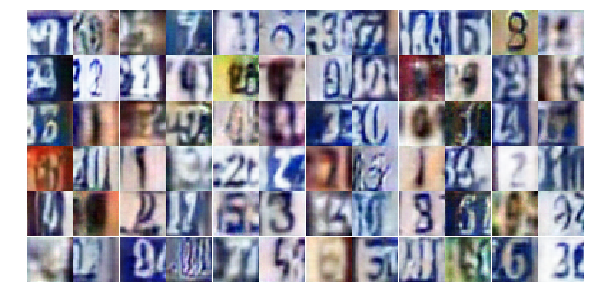

Epoch 16/25... Discriminator Loss: 0.3865... Generator Loss: 1.5336
Epoch 16/25... Discriminator Loss: 0.4499... Generator Loss: 1.3646
Epoch 16/25... Discriminator Loss: 0.6681... Generator Loss: 1.5870
Epoch 16/25... Discriminator Loss: 3.0181... Generator Loss: 3.1276
Epoch 16/25... Discriminator Loss: 0.8034... Generator Loss: 1.4653
Epoch 16/25... Discriminator Loss: 0.6781... Generator Loss: 1.5043
Epoch 16/25... Discriminator Loss: 1.1261... Generator Loss: 0.5676
Epoch 16/25... Discriminator Loss: 0.9899... Generator Loss: 0.6534
Epoch 16/25... Discriminator Loss: 0.8293... Generator Loss: 0.8427
Epoch 16/25... Discriminator Loss: 0.3287... Generator Loss: 1.9428


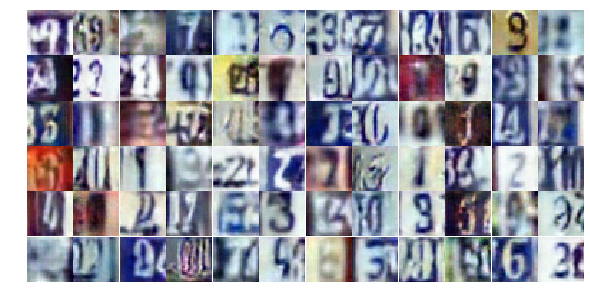

Epoch 16/25... Discriminator Loss: 0.4639... Generator Loss: 1.5085
Epoch 16/25... Discriminator Loss: 0.5672... Generator Loss: 1.5818
Epoch 16/25... Discriminator Loss: 1.0699... Generator Loss: 0.6186
Epoch 16/25... Discriminator Loss: 0.9564... Generator Loss: 0.6769
Epoch 16/25... Discriminator Loss: 1.3024... Generator Loss: 0.4374
Epoch 16/25... Discriminator Loss: 1.0987... Generator Loss: 0.5854
Epoch 16/25... Discriminator Loss: 0.2684... Generator Loss: 1.9717
Epoch 16/25... Discriminator Loss: 0.5343... Generator Loss: 1.2190
Epoch 16/25... Discriminator Loss: 0.3872... Generator Loss: 1.5202
Epoch 16/25... Discriminator Loss: 0.9979... Generator Loss: 0.6556


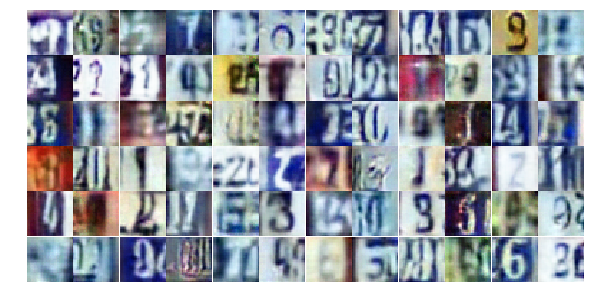

Epoch 16/25... Discriminator Loss: 1.4563... Generator Loss: 0.3708
Epoch 16/25... Discriminator Loss: 0.6179... Generator Loss: 1.1217
Epoch 16/25... Discriminator Loss: 1.5873... Generator Loss: 0.3727
Epoch 16/25... Discriminator Loss: 0.5068... Generator Loss: 1.3173
Epoch 16/25... Discriminator Loss: 0.5795... Generator Loss: 1.1847
Epoch 16/25... Discriminator Loss: 0.5262... Generator Loss: 2.4320
Epoch 17/25... Discriminator Loss: 0.5797... Generator Loss: 1.2262
Epoch 17/25... Discriminator Loss: 0.7369... Generator Loss: 0.9482
Epoch 17/25... Discriminator Loss: 0.5561... Generator Loss: 1.1985
Epoch 17/25... Discriminator Loss: 0.7424... Generator Loss: 1.0026


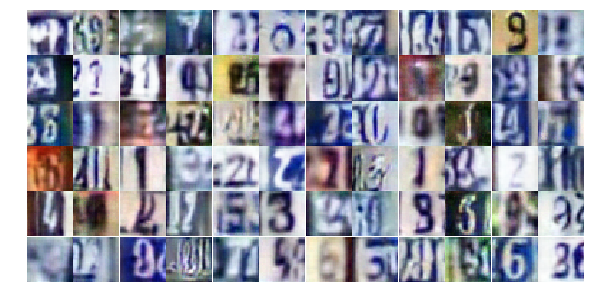

Epoch 17/25... Discriminator Loss: 0.4424... Generator Loss: 1.4083
Epoch 17/25... Discriminator Loss: 0.5116... Generator Loss: 1.1623
Epoch 17/25... Discriminator Loss: 0.9056... Generator Loss: 0.7034
Epoch 17/25... Discriminator Loss: 0.8264... Generator Loss: 0.8126
Epoch 17/25... Discriminator Loss: 1.2098... Generator Loss: 0.5334
Epoch 17/25... Discriminator Loss: 1.1195... Generator Loss: 0.5510
Epoch 17/25... Discriminator Loss: 0.9055... Generator Loss: 0.7913
Epoch 17/25... Discriminator Loss: 0.3547... Generator Loss: 1.7152
Epoch 17/25... Discriminator Loss: 0.3009... Generator Loss: 1.8525
Epoch 17/25... Discriminator Loss: 0.5524... Generator Loss: 2.0770


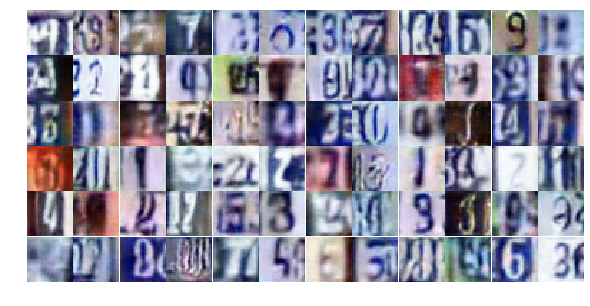

Epoch 17/25... Discriminator Loss: 0.5143... Generator Loss: 1.9415
Epoch 17/25... Discriminator Loss: 1.2377... Generator Loss: 2.1649
Epoch 17/25... Discriminator Loss: 0.7920... Generator Loss: 0.8776
Epoch 17/25... Discriminator Loss: 0.7064... Generator Loss: 1.0932
Epoch 17/25... Discriminator Loss: 0.5437... Generator Loss: 1.4781
Epoch 17/25... Discriminator Loss: 0.7349... Generator Loss: 0.9322
Epoch 17/25... Discriminator Loss: 0.6280... Generator Loss: 1.8851
Epoch 17/25... Discriminator Loss: 0.5410... Generator Loss: 1.4193
Epoch 17/25... Discriminator Loss: 0.5170... Generator Loss: 1.2600
Epoch 17/25... Discriminator Loss: 0.5290... Generator Loss: 1.2194


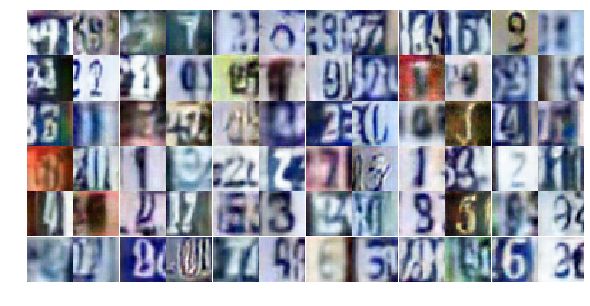

Epoch 17/25... Discriminator Loss: 1.1015... Generator Loss: 0.5936
Epoch 17/25... Discriminator Loss: 0.3087... Generator Loss: 1.8737
Epoch 17/25... Discriminator Loss: 0.4166... Generator Loss: 1.6374
Epoch 17/25... Discriminator Loss: 0.8146... Generator Loss: 0.8411
Epoch 17/25... Discriminator Loss: 1.0743... Generator Loss: 0.6154
Epoch 17/25... Discriminator Loss: 0.3271... Generator Loss: 1.8248
Epoch 17/25... Discriminator Loss: 1.1000... Generator Loss: 0.5231
Epoch 17/25... Discriminator Loss: 0.4745... Generator Loss: 1.3279
Epoch 17/25... Discriminator Loss: 1.0914... Generator Loss: 0.6094
Epoch 17/25... Discriminator Loss: 0.2265... Generator Loss: 2.5179


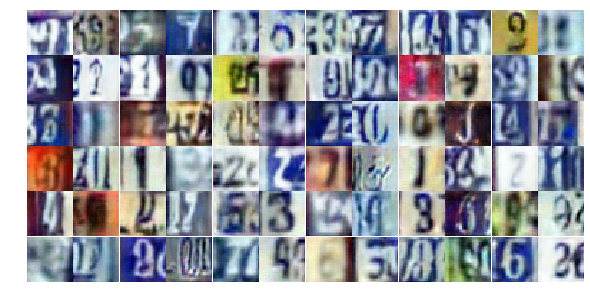

Epoch 17/25... Discriminator Loss: 0.6222... Generator Loss: 1.3491
Epoch 17/25... Discriminator Loss: 1.4493... Generator Loss: 0.3909
Epoch 17/25... Discriminator Loss: 0.5689... Generator Loss: 2.0339
Epoch 17/25... Discriminator Loss: 0.7450... Generator Loss: 0.8954
Epoch 17/25... Discriminator Loss: 1.1464... Generator Loss: 0.5466
Epoch 17/25... Discriminator Loss: 0.6182... Generator Loss: 1.2007
Epoch 17/25... Discriminator Loss: 0.4428... Generator Loss: 1.6628
Epoch 17/25... Discriminator Loss: 0.5288... Generator Loss: 1.4824
Epoch 17/25... Discriminator Loss: 0.3419... Generator Loss: 1.8346
Epoch 17/25... Discriminator Loss: 1.1198... Generator Loss: 0.5378


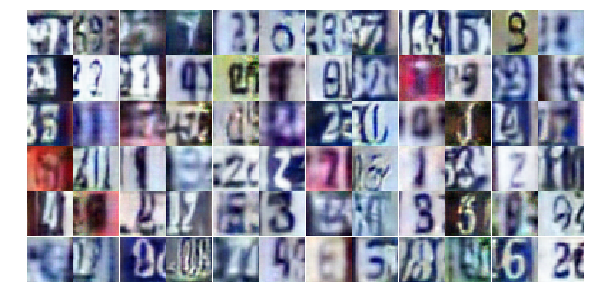

Epoch 17/25... Discriminator Loss: 0.7968... Generator Loss: 1.1210
Epoch 17/25... Discriminator Loss: 0.2619... Generator Loss: 2.0479
Epoch 17/25... Discriminator Loss: 1.2985... Generator Loss: 0.5373
Epoch 17/25... Discriminator Loss: 0.4290... Generator Loss: 1.3411
Epoch 17/25... Discriminator Loss: 1.1185... Generator Loss: 0.5565
Epoch 17/25... Discriminator Loss: 0.7755... Generator Loss: 0.8626
Epoch 17/25... Discriminator Loss: 0.8287... Generator Loss: 0.7536
Epoch 17/25... Discriminator Loss: 0.5075... Generator Loss: 1.2437
Epoch 17/25... Discriminator Loss: 0.5459... Generator Loss: 1.2894
Epoch 17/25... Discriminator Loss: 1.2090... Generator Loss: 0.5171


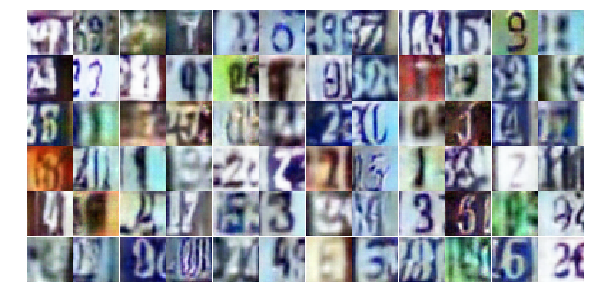

Epoch 17/25... Discriminator Loss: 1.0461... Generator Loss: 0.8068
Epoch 17/25... Discriminator Loss: 0.7952... Generator Loss: 1.0322
Epoch 17/25... Discriminator Loss: 0.6943... Generator Loss: 1.0793
Epoch 17/25... Discriminator Loss: 0.4265... Generator Loss: 2.1393
Epoch 18/25... Discriminator Loss: 0.7076... Generator Loss: 1.1374
Epoch 18/25... Discriminator Loss: 0.8503... Generator Loss: 0.7546
Epoch 18/25... Discriminator Loss: 0.8197... Generator Loss: 0.8561
Epoch 18/25... Discriminator Loss: 0.4661... Generator Loss: 1.6396
Epoch 18/25... Discriminator Loss: 1.6616... Generator Loss: 0.3525
Epoch 18/25... Discriminator Loss: 0.7602... Generator Loss: 0.9493


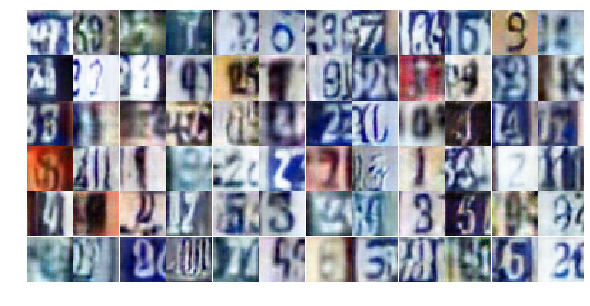

Epoch 18/25... Discriminator Loss: 0.2802... Generator Loss: 3.1425
Epoch 18/25... Discriminator Loss: 0.9617... Generator Loss: 0.6649
Epoch 18/25... Discriminator Loss: 0.8268... Generator Loss: 0.7811
Epoch 18/25... Discriminator Loss: 0.3851... Generator Loss: 1.7101
Epoch 18/25... Discriminator Loss: 0.4861... Generator Loss: 2.1776
Epoch 18/25... Discriminator Loss: 1.0580... Generator Loss: 0.6556
Epoch 18/25... Discriminator Loss: 0.6415... Generator Loss: 1.0789
Epoch 18/25... Discriminator Loss: 1.2000... Generator Loss: 0.4874
Epoch 18/25... Discriminator Loss: 0.7931... Generator Loss: 2.0549
Epoch 18/25... Discriminator Loss: 0.2966... Generator Loss: 2.2692


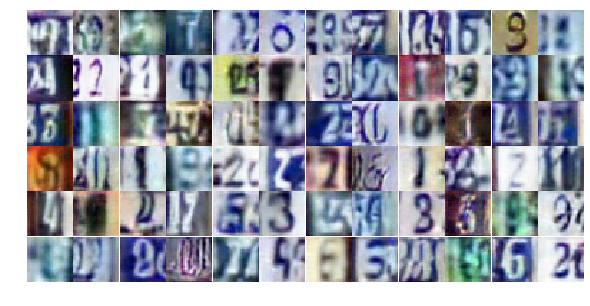

Epoch 18/25... Discriminator Loss: 0.5705... Generator Loss: 1.2785
Epoch 18/25... Discriminator Loss: 0.8472... Generator Loss: 0.8211
Epoch 18/25... Discriminator Loss: 1.1462... Generator Loss: 0.5401
Epoch 18/25... Discriminator Loss: 0.3140... Generator Loss: 2.0973
Epoch 18/25... Discriminator Loss: 0.7255... Generator Loss: 0.9984
Epoch 18/25... Discriminator Loss: 0.7145... Generator Loss: 1.0307
Epoch 18/25... Discriminator Loss: 0.6476... Generator Loss: 1.1577
Epoch 18/25... Discriminator Loss: 0.4750... Generator Loss: 1.4398
Epoch 18/25... Discriminator Loss: 0.7086... Generator Loss: 0.9418
Epoch 18/25... Discriminator Loss: 0.3515... Generator Loss: 1.8327


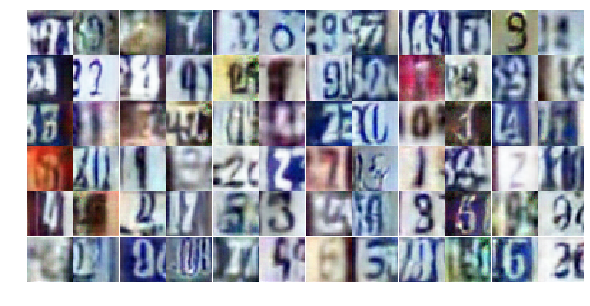

Epoch 18/25... Discriminator Loss: 0.2613... Generator Loss: 2.9347
Epoch 18/25... Discriminator Loss: 0.6076... Generator Loss: 1.3778
Epoch 18/25... Discriminator Loss: 1.0857... Generator Loss: 0.5811
Epoch 18/25... Discriminator Loss: 0.6888... Generator Loss: 1.6571
Epoch 18/25... Discriminator Loss: 1.7786... Generator Loss: 0.2829
Epoch 18/25... Discriminator Loss: 0.7438... Generator Loss: 1.1236
Epoch 18/25... Discriminator Loss: 0.4796... Generator Loss: 1.5562
Epoch 18/25... Discriminator Loss: 0.5259... Generator Loss: 1.5604
Epoch 18/25... Discriminator Loss: 0.7241... Generator Loss: 3.5439
Epoch 18/25... Discriminator Loss: 0.7484... Generator Loss: 1.3880


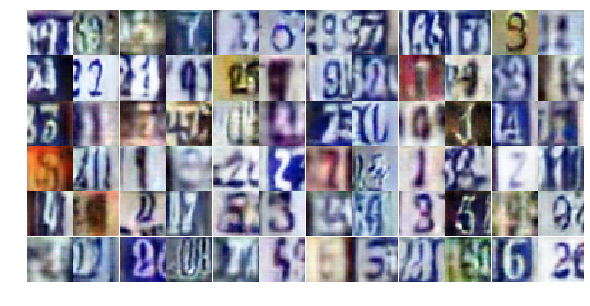

Epoch 18/25... Discriminator Loss: 0.6904... Generator Loss: 1.1352
Epoch 18/25... Discriminator Loss: 0.7102... Generator Loss: 1.0230
Epoch 18/25... Discriminator Loss: 0.6122... Generator Loss: 1.0881
Epoch 18/25... Discriminator Loss: 0.7130... Generator Loss: 1.0583
Epoch 18/25... Discriminator Loss: 0.7437... Generator Loss: 0.9813
Epoch 18/25... Discriminator Loss: 0.6121... Generator Loss: 1.0404
Epoch 18/25... Discriminator Loss: 0.7499... Generator Loss: 0.9405
Epoch 18/25... Discriminator Loss: 2.0228... Generator Loss: 3.3252
Epoch 18/25... Discriminator Loss: 0.7649... Generator Loss: 0.9210
Epoch 18/25... Discriminator Loss: 0.4151... Generator Loss: 1.5150


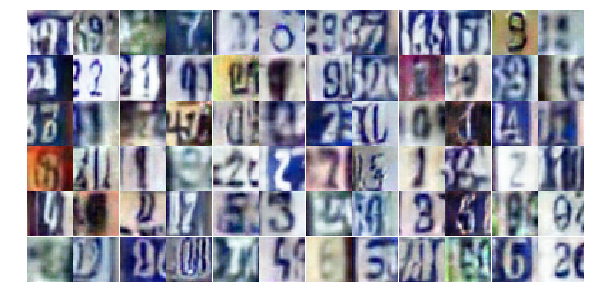

Epoch 18/25... Discriminator Loss: 0.7753... Generator Loss: 0.9140
Epoch 18/25... Discriminator Loss: 0.6234... Generator Loss: 1.0640
Epoch 18/25... Discriminator Loss: 0.8997... Generator Loss: 0.7270
Epoch 18/25... Discriminator Loss: 0.7756... Generator Loss: 0.9594
Epoch 18/25... Discriminator Loss: 0.6327... Generator Loss: 1.1512
Epoch 18/25... Discriminator Loss: 0.3939... Generator Loss: 2.2257
Epoch 18/25... Discriminator Loss: 0.5297... Generator Loss: 1.2170
Epoch 18/25... Discriminator Loss: 0.4502... Generator Loss: 1.3882
Epoch 18/25... Discriminator Loss: 0.5958... Generator Loss: 1.5328
Epoch 18/25... Discriminator Loss: 1.1385... Generator Loss: 0.5917


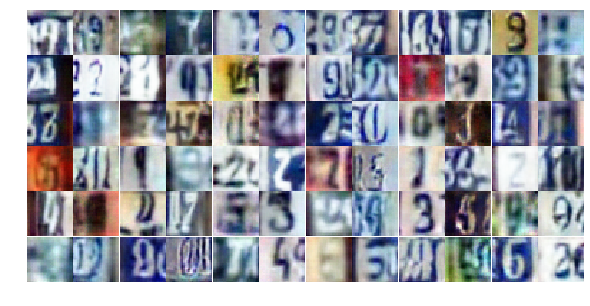

Epoch 18/25... Discriminator Loss: 0.4971... Generator Loss: 1.6301
Epoch 19/25... Discriminator Loss: 1.1020... Generator Loss: 0.5570
Epoch 19/25... Discriminator Loss: 0.8501... Generator Loss: 0.8283
Epoch 19/25... Discriminator Loss: 0.5491... Generator Loss: 1.6120
Epoch 19/25... Discriminator Loss: 0.5112... Generator Loss: 1.2451
Epoch 19/25... Discriminator Loss: 0.9185... Generator Loss: 0.7250
Epoch 19/25... Discriminator Loss: 0.2816... Generator Loss: 2.3806
Epoch 19/25... Discriminator Loss: 0.6629... Generator Loss: 1.0181
Epoch 19/25... Discriminator Loss: 0.4148... Generator Loss: 2.8807
Epoch 19/25... Discriminator Loss: 0.8626... Generator Loss: 0.8194


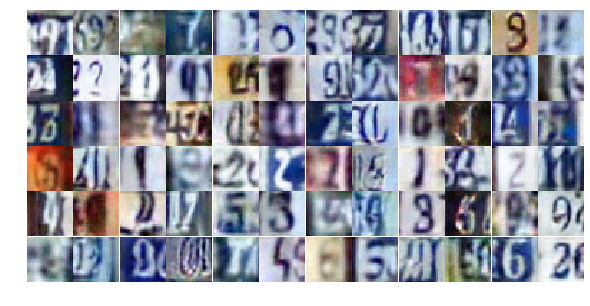

Epoch 19/25... Discriminator Loss: 0.6658... Generator Loss: 0.9535
Epoch 19/25... Discriminator Loss: 0.8309... Generator Loss: 0.8444
Epoch 19/25... Discriminator Loss: 0.5288... Generator Loss: 1.6650
Epoch 19/25... Discriminator Loss: 0.5226... Generator Loss: 1.2709
Epoch 19/25... Discriminator Loss: 0.5671... Generator Loss: 1.9906
Epoch 19/25... Discriminator Loss: 0.6012... Generator Loss: 1.2881
Epoch 19/25... Discriminator Loss: 0.7932... Generator Loss: 0.8174
Epoch 19/25... Discriminator Loss: 0.4930... Generator Loss: 1.5702
Epoch 19/25... Discriminator Loss: 1.0595... Generator Loss: 3.6368
Epoch 19/25... Discriminator Loss: 1.8158... Generator Loss: 0.3545


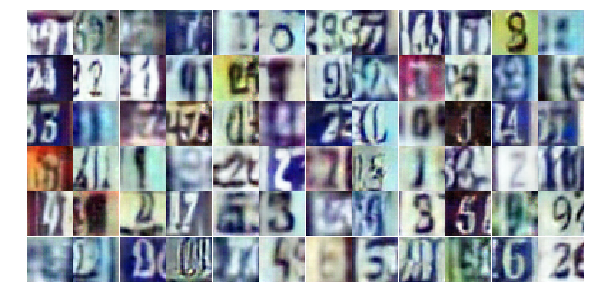

Epoch 19/25... Discriminator Loss: 0.5076... Generator Loss: 1.3537
Epoch 19/25... Discriminator Loss: 1.3263... Generator Loss: 0.4297
Epoch 19/25... Discriminator Loss: 1.4064... Generator Loss: 0.4229
Epoch 19/25... Discriminator Loss: 1.0604... Generator Loss: 0.8047
Epoch 19/25... Discriminator Loss: 0.6210... Generator Loss: 1.2446
Epoch 19/25... Discriminator Loss: 0.6369... Generator Loss: 1.1032
Epoch 19/25... Discriminator Loss: 0.8010... Generator Loss: 0.8630
Epoch 19/25... Discriminator Loss: 0.4950... Generator Loss: 1.3107
Epoch 19/25... Discriminator Loss: 0.5839... Generator Loss: 1.2082
Epoch 19/25... Discriminator Loss: 1.5471... Generator Loss: 0.4167


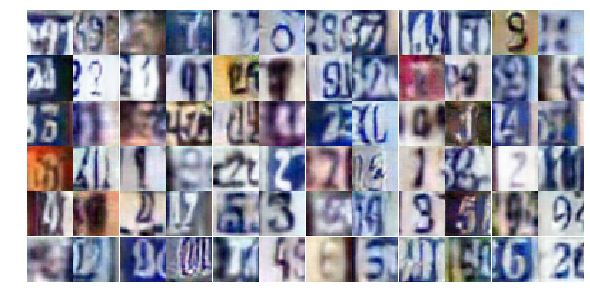

Epoch 19/25... Discriminator Loss: 0.8760... Generator Loss: 0.7238
Epoch 19/25... Discriminator Loss: 0.7321... Generator Loss: 0.8899
Epoch 19/25... Discriminator Loss: 0.5594... Generator Loss: 1.1942
Epoch 19/25... Discriminator Loss: 0.5832... Generator Loss: 1.1653
Epoch 19/25... Discriminator Loss: 0.5768... Generator Loss: 1.2615
Epoch 19/25... Discriminator Loss: 1.7350... Generator Loss: 0.3047
Epoch 19/25... Discriminator Loss: 0.7897... Generator Loss: 2.6060
Epoch 19/25... Discriminator Loss: 0.6246... Generator Loss: 3.4040
Epoch 19/25... Discriminator Loss: 0.9174... Generator Loss: 0.7037
Epoch 19/25... Discriminator Loss: 0.6170... Generator Loss: 2.9664


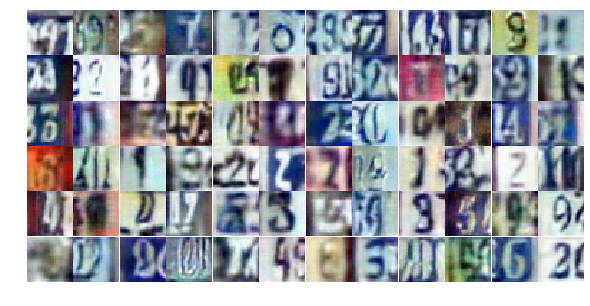

Epoch 19/25... Discriminator Loss: 0.5337... Generator Loss: 1.2103
Epoch 19/25... Discriminator Loss: 0.4303... Generator Loss: 1.4798
Epoch 19/25... Discriminator Loss: 0.9952... Generator Loss: 0.6535
Epoch 19/25... Discriminator Loss: 0.4769... Generator Loss: 1.4324
Epoch 19/25... Discriminator Loss: 0.4431... Generator Loss: 1.9589
Epoch 19/25... Discriminator Loss: 0.6133... Generator Loss: 1.8945
Epoch 19/25... Discriminator Loss: 0.6252... Generator Loss: 2.3721
Epoch 19/25... Discriminator Loss: 0.6153... Generator Loss: 1.1190
Epoch 19/25... Discriminator Loss: 0.6280... Generator Loss: 1.1407
Epoch 19/25... Discriminator Loss: 0.7440... Generator Loss: 0.9374


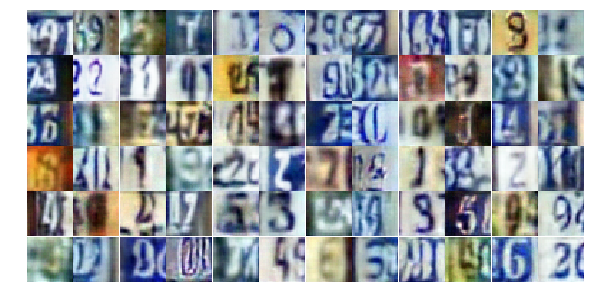

Epoch 19/25... Discriminator Loss: 0.5945... Generator Loss: 1.1725
Epoch 19/25... Discriminator Loss: 0.6288... Generator Loss: 1.3113
Epoch 19/25... Discriminator Loss: 0.5937... Generator Loss: 1.3308
Epoch 19/25... Discriminator Loss: 0.9725... Generator Loss: 0.7474
Epoch 19/25... Discriminator Loss: 0.6486... Generator Loss: 1.0231
Epoch 19/25... Discriminator Loss: 0.6651... Generator Loss: 1.3869
Epoch 19/25... Discriminator Loss: 1.7406... Generator Loss: 0.3080
Epoch 19/25... Discriminator Loss: 0.4198... Generator Loss: 1.7133
Epoch 20/25... Discriminator Loss: 1.2978... Generator Loss: 0.5878
Epoch 20/25... Discriminator Loss: 0.6875... Generator Loss: 1.0949


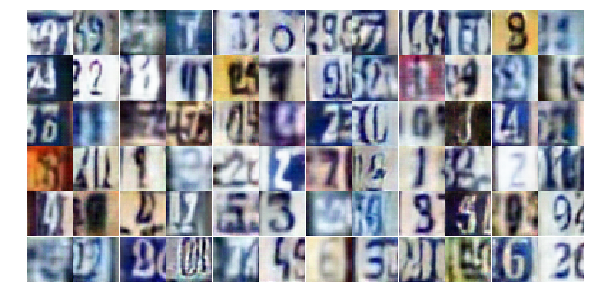

Epoch 20/25... Discriminator Loss: 0.3757... Generator Loss: 1.7624
Epoch 20/25... Discriminator Loss: 0.6225... Generator Loss: 1.2014
Epoch 20/25... Discriminator Loss: 0.8148... Generator Loss: 0.8554
Epoch 20/25... Discriminator Loss: 0.9180... Generator Loss: 0.7499
Epoch 20/25... Discriminator Loss: 0.4147... Generator Loss: 2.4218
Epoch 20/25... Discriminator Loss: 0.6481... Generator Loss: 1.0459
Epoch 20/25... Discriminator Loss: 0.6478... Generator Loss: 1.2472
Epoch 20/25... Discriminator Loss: 0.6677... Generator Loss: 1.2178
Epoch 20/25... Discriminator Loss: 0.5784... Generator Loss: 1.3547
Epoch 20/25... Discriminator Loss: 0.6519... Generator Loss: 1.0017


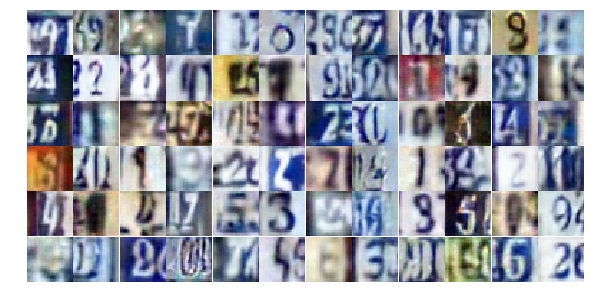

Epoch 20/25... Discriminator Loss: 1.1400... Generator Loss: 0.6671
Epoch 20/25... Discriminator Loss: 1.1467... Generator Loss: 0.5620
Epoch 20/25... Discriminator Loss: 0.4154... Generator Loss: 1.7304
Epoch 20/25... Discriminator Loss: 0.5530... Generator Loss: 1.4211
Epoch 20/25... Discriminator Loss: 1.0153... Generator Loss: 0.6056
Epoch 20/25... Discriminator Loss: 0.8338... Generator Loss: 0.8235
Epoch 20/25... Discriminator Loss: 0.9726... Generator Loss: 0.7454
Epoch 20/25... Discriminator Loss: 0.3591... Generator Loss: 1.7550
Epoch 20/25... Discriminator Loss: 0.8369... Generator Loss: 0.7858
Epoch 20/25... Discriminator Loss: 0.6564... Generator Loss: 1.1996


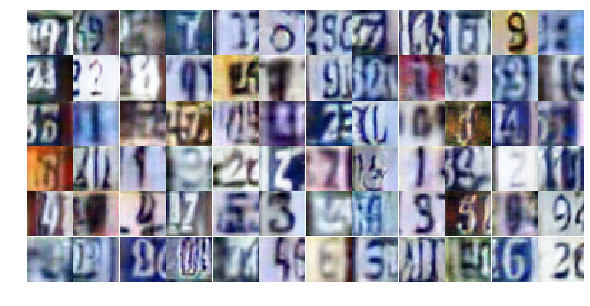

Epoch 20/25... Discriminator Loss: 1.2618... Generator Loss: 0.5296
Epoch 20/25... Discriminator Loss: 0.7226... Generator Loss: 1.0464
Epoch 20/25... Discriminator Loss: 0.3957... Generator Loss: 1.5750
Epoch 20/25... Discriminator Loss: 1.4282... Generator Loss: 0.4493
Epoch 20/25... Discriminator Loss: 0.6253... Generator Loss: 1.6662
Epoch 20/25... Discriminator Loss: 0.4162... Generator Loss: 1.3626
Epoch 20/25... Discriminator Loss: 0.5424... Generator Loss: 1.8525
Epoch 20/25... Discriminator Loss: 1.8315... Generator Loss: 0.2666
Epoch 20/25... Discriminator Loss: 1.0604... Generator Loss: 0.5997
Epoch 20/25... Discriminator Loss: 0.5260... Generator Loss: 1.1899


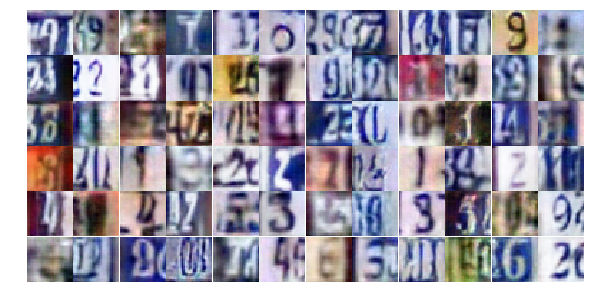

Epoch 20/25... Discriminator Loss: 0.6929... Generator Loss: 1.0927
Epoch 20/25... Discriminator Loss: 0.5055... Generator Loss: 1.2937
Epoch 20/25... Discriminator Loss: 0.4621... Generator Loss: 1.7483
Epoch 20/25... Discriminator Loss: 0.9258... Generator Loss: 0.9192
Epoch 20/25... Discriminator Loss: 0.7384... Generator Loss: 1.1997
Epoch 20/25... Discriminator Loss: 0.5333... Generator Loss: 1.6333
Epoch 20/25... Discriminator Loss: 0.9133... Generator Loss: 0.8433
Epoch 20/25... Discriminator Loss: 0.9496... Generator Loss: 0.7100
Epoch 20/25... Discriminator Loss: 0.6319... Generator Loss: 1.1751
Epoch 20/25... Discriminator Loss: 1.3640... Generator Loss: 0.4400


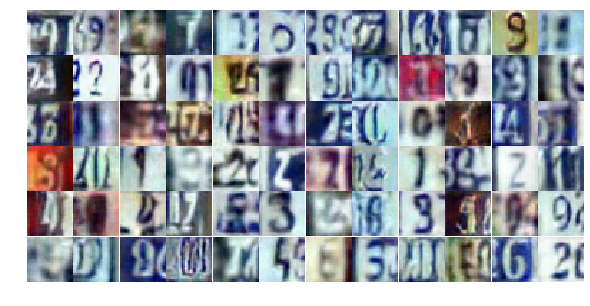

Epoch 20/25... Discriminator Loss: 0.3238... Generator Loss: 1.8345
Epoch 20/25... Discriminator Loss: 0.6787... Generator Loss: 1.1037
Epoch 20/25... Discriminator Loss: 0.7439... Generator Loss: 1.1190
Epoch 20/25... Discriminator Loss: 1.0729... Generator Loss: 0.6223
Epoch 20/25... Discriminator Loss: 0.8392... Generator Loss: 0.9169
Epoch 20/25... Discriminator Loss: 0.8548... Generator Loss: 0.8564
Epoch 20/25... Discriminator Loss: 0.9980... Generator Loss: 0.7383
Epoch 20/25... Discriminator Loss: 0.4491... Generator Loss: 1.6515
Epoch 20/25... Discriminator Loss: 0.7876... Generator Loss: 0.8096
Epoch 20/25... Discriminator Loss: 0.5791... Generator Loss: 1.1047


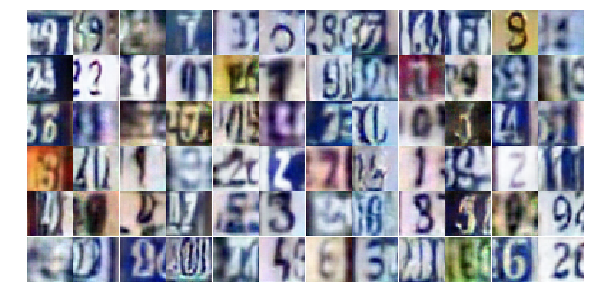

Epoch 20/25... Discriminator Loss: 0.4312... Generator Loss: 1.6799
Epoch 20/25... Discriminator Loss: 0.6844... Generator Loss: 1.5940
Epoch 20/25... Discriminator Loss: 0.6207... Generator Loss: 1.1849
Epoch 20/25... Discriminator Loss: 0.8768... Generator Loss: 1.6994
Epoch 20/25... Discriminator Loss: 0.5059... Generator Loss: 1.2775
Epoch 20/25... Discriminator Loss: 0.5649... Generator Loss: 1.1968
Epoch 21/25... Discriminator Loss: 0.6928... Generator Loss: 1.1055
Epoch 21/25... Discriminator Loss: 0.9875... Generator Loss: 0.6276
Epoch 21/25... Discriminator Loss: 0.9196... Generator Loss: 0.7401
Epoch 21/25... Discriminator Loss: 0.7694... Generator Loss: 0.8767


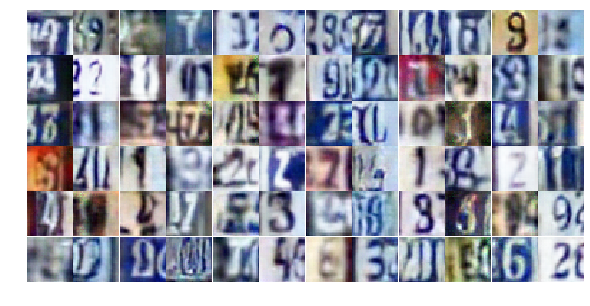

Epoch 21/25... Discriminator Loss: 0.4829... Generator Loss: 1.4457
Epoch 21/25... Discriminator Loss: 2.2603... Generator Loss: 0.2136
Epoch 21/25... Discriminator Loss: 0.3397... Generator Loss: 1.8979
Epoch 21/25... Discriminator Loss: 0.5015... Generator Loss: 1.1321
Epoch 21/25... Discriminator Loss: 0.9766... Generator Loss: 0.6870
Epoch 21/25... Discriminator Loss: 0.3440... Generator Loss: 1.7491
Epoch 21/25... Discriminator Loss: 0.8749... Generator Loss: 0.8028
Epoch 21/25... Discriminator Loss: 0.8311... Generator Loss: 0.8033
Epoch 21/25... Discriminator Loss: 0.8693... Generator Loss: 0.7754
Epoch 21/25... Discriminator Loss: 0.5841... Generator Loss: 1.7106


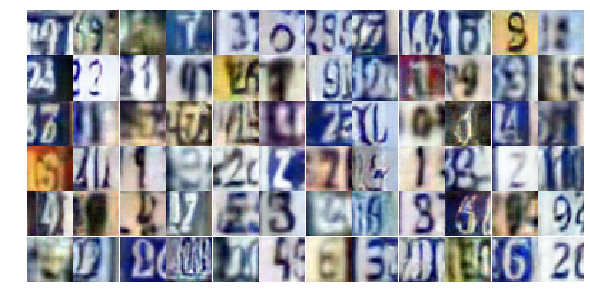

Epoch 21/25... Discriminator Loss: 0.3567... Generator Loss: 2.3388
Epoch 21/25... Discriminator Loss: 1.3966... Generator Loss: 0.4450
Epoch 21/25... Discriminator Loss: 1.7588... Generator Loss: 0.2863
Epoch 21/25... Discriminator Loss: 1.9698... Generator Loss: 0.2982
Epoch 21/25... Discriminator Loss: 0.8214... Generator Loss: 1.2247
Epoch 21/25... Discriminator Loss: 0.9891... Generator Loss: 0.8085
Epoch 21/25... Discriminator Loss: 0.9490... Generator Loss: 0.6577
Epoch 21/25... Discriminator Loss: 0.5965... Generator Loss: 1.1361
Epoch 21/25... Discriminator Loss: 0.5839... Generator Loss: 1.1974
Epoch 21/25... Discriminator Loss: 0.7034... Generator Loss: 1.0159


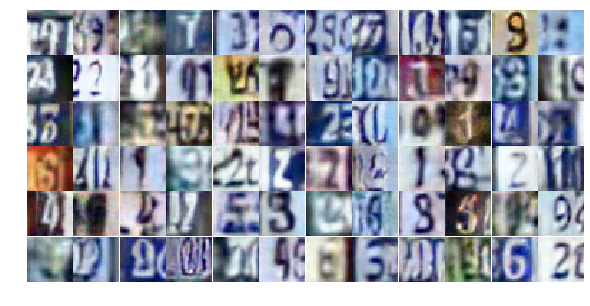

Epoch 21/25... Discriminator Loss: 0.9270... Generator Loss: 0.7711
Epoch 21/25... Discriminator Loss: 0.4837... Generator Loss: 1.2542
Epoch 21/25... Discriminator Loss: 1.1137... Generator Loss: 0.5663
Epoch 21/25... Discriminator Loss: 0.8728... Generator Loss: 0.7870
Epoch 21/25... Discriminator Loss: 0.9988... Generator Loss: 0.7305
Epoch 21/25... Discriminator Loss: 0.7893... Generator Loss: 0.9539
Epoch 21/25... Discriminator Loss: 0.3852... Generator Loss: 1.5362
Epoch 21/25... Discriminator Loss: 0.7814... Generator Loss: 0.8910
Epoch 21/25... Discriminator Loss: 0.8887... Generator Loss: 0.7667
Epoch 21/25... Discriminator Loss: 1.3352... Generator Loss: 0.5219


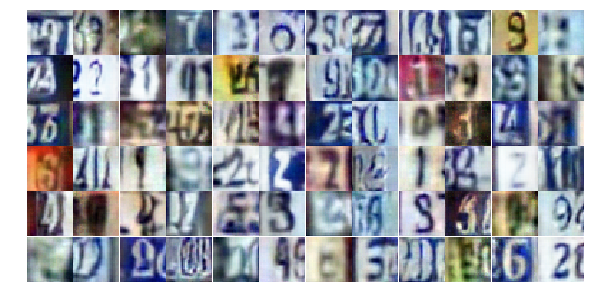

Epoch 21/25... Discriminator Loss: 1.2306... Generator Loss: 0.5410
Epoch 21/25... Discriminator Loss: 0.7868... Generator Loss: 0.8935
Epoch 21/25... Discriminator Loss: 0.9805... Generator Loss: 0.6472
Epoch 21/25... Discriminator Loss: 0.5576... Generator Loss: 1.1865
Epoch 21/25... Discriminator Loss: 0.5270... Generator Loss: 1.2632
Epoch 21/25... Discriminator Loss: 0.6711... Generator Loss: 1.2850
Epoch 21/25... Discriminator Loss: 0.6456... Generator Loss: 1.1110
Epoch 21/25... Discriminator Loss: 0.8370... Generator Loss: 0.8000
Epoch 21/25... Discriminator Loss: 0.8482... Generator Loss: 0.8259
Epoch 21/25... Discriminator Loss: 1.4136... Generator Loss: 1.8234


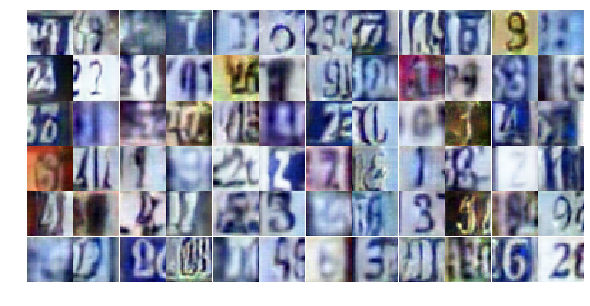

Epoch 21/25... Discriminator Loss: 0.8735... Generator Loss: 1.6477
Epoch 21/25... Discriminator Loss: 1.1994... Generator Loss: 0.6486
Epoch 21/25... Discriminator Loss: 0.9505... Generator Loss: 0.7228
Epoch 21/25... Discriminator Loss: 1.0237... Generator Loss: 0.7427
Epoch 21/25... Discriminator Loss: 0.4973... Generator Loss: 1.3206
Epoch 21/25... Discriminator Loss: 0.4376... Generator Loss: 1.8242
Epoch 21/25... Discriminator Loss: 0.6230... Generator Loss: 1.1106
Epoch 21/25... Discriminator Loss: 0.6341... Generator Loss: 1.1978
Epoch 21/25... Discriminator Loss: 1.1167... Generator Loss: 0.6270
Epoch 21/25... Discriminator Loss: 0.7377... Generator Loss: 0.9886


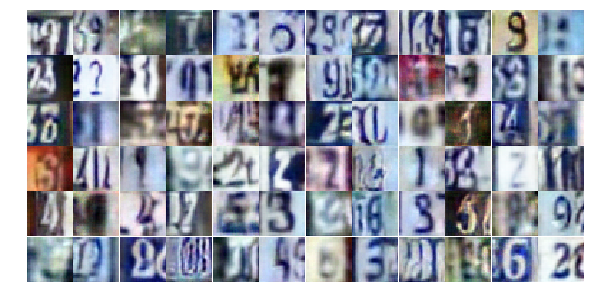

Epoch 21/25... Discriminator Loss: 0.5467... Generator Loss: 1.3592
Epoch 21/25... Discriminator Loss: 0.7897... Generator Loss: 1.0663
Epoch 21/25... Discriminator Loss: 0.5868... Generator Loss: 1.2536
Epoch 22/25... Discriminator Loss: 0.7078... Generator Loss: 1.0823
Epoch 22/25... Discriminator Loss: 0.7536... Generator Loss: 0.8731
Epoch 22/25... Discriminator Loss: 0.5719... Generator Loss: 1.3970
Epoch 22/25... Discriminator Loss: 0.6123... Generator Loss: 1.1543
Epoch 22/25... Discriminator Loss: 0.4971... Generator Loss: 1.2984
Epoch 22/25... Discriminator Loss: 0.7954... Generator Loss: 0.8517
Epoch 22/25... Discriminator Loss: 0.9388... Generator Loss: 0.7188


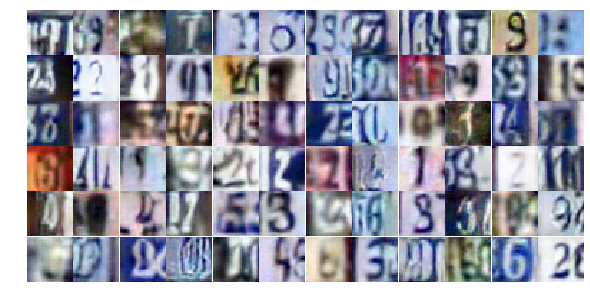

Epoch 22/25... Discriminator Loss: 0.6285... Generator Loss: 1.4446
Epoch 22/25... Discriminator Loss: 1.1543... Generator Loss: 0.5636
Epoch 22/25... Discriminator Loss: 1.2861... Generator Loss: 0.4964
Epoch 22/25... Discriminator Loss: 0.8753... Generator Loss: 0.7741
Epoch 22/25... Discriminator Loss: 1.0782... Generator Loss: 0.5807
Epoch 22/25... Discriminator Loss: 0.6783... Generator Loss: 1.0144
Epoch 22/25... Discriminator Loss: 0.7088... Generator Loss: 0.9965
Epoch 22/25... Discriminator Loss: 0.4528... Generator Loss: 1.3809
Epoch 22/25... Discriminator Loss: 1.0510... Generator Loss: 0.6232
Epoch 22/25... Discriminator Loss: 1.1704... Generator Loss: 0.5490


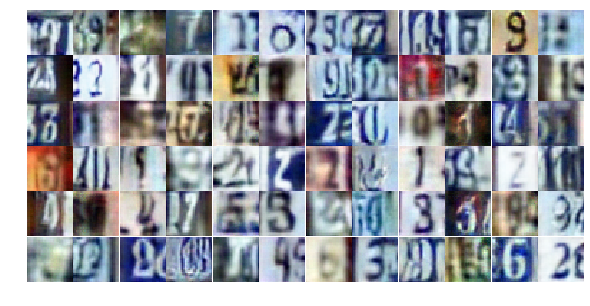

Epoch 22/25... Discriminator Loss: 0.0911... Generator Loss: 4.0297
Epoch 22/25... Discriminator Loss: 0.7158... Generator Loss: 1.0183
Epoch 22/25... Discriminator Loss: 0.5045... Generator Loss: 1.2602
Epoch 22/25... Discriminator Loss: 0.2012... Generator Loss: 2.2619
Epoch 22/25... Discriminator Loss: 0.5956... Generator Loss: 3.5725
Epoch 22/25... Discriminator Loss: 1.7481... Generator Loss: 3.4308
Epoch 22/25... Discriminator Loss: 0.5914... Generator Loss: 1.2139
Epoch 22/25... Discriminator Loss: 0.4119... Generator Loss: 1.6284
Epoch 22/25... Discriminator Loss: 0.4198... Generator Loss: 1.5571
Epoch 22/25... Discriminator Loss: 0.6437... Generator Loss: 1.0536


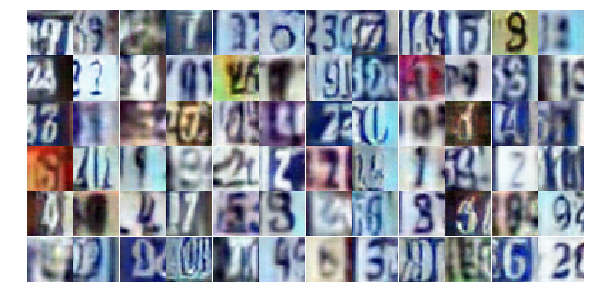

Epoch 22/25... Discriminator Loss: 0.3963... Generator Loss: 1.5520
Epoch 22/25... Discriminator Loss: 0.5666... Generator Loss: 1.0692
Epoch 22/25... Discriminator Loss: 1.0439... Generator Loss: 0.6198
Epoch 22/25... Discriminator Loss: 0.7377... Generator Loss: 0.9023
Epoch 22/25... Discriminator Loss: 0.7584... Generator Loss: 0.8333
Epoch 22/25... Discriminator Loss: 1.0738... Generator Loss: 0.6177
Epoch 22/25... Discriminator Loss: 1.8202... Generator Loss: 0.2742
Epoch 22/25... Discriminator Loss: 0.3940... Generator Loss: 2.0491
Epoch 22/25... Discriminator Loss: 0.6913... Generator Loss: 1.1180
Epoch 22/25... Discriminator Loss: 0.7018... Generator Loss: 1.1728


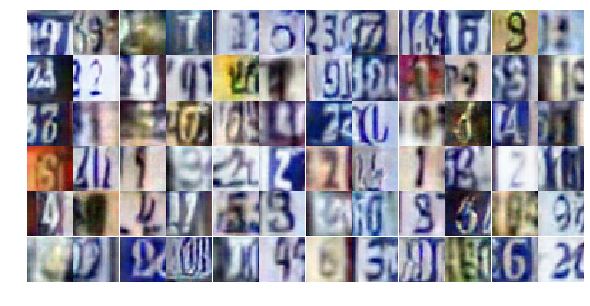

Epoch 22/25... Discriminator Loss: 0.8538... Generator Loss: 0.8161
Epoch 22/25... Discriminator Loss: 0.3485... Generator Loss: 1.9503
Epoch 22/25... Discriminator Loss: 0.3989... Generator Loss: 1.4713
Epoch 22/25... Discriminator Loss: 0.8400... Generator Loss: 0.7478
Epoch 22/25... Discriminator Loss: 0.4381... Generator Loss: 1.3812
Epoch 22/25... Discriminator Loss: 0.2412... Generator Loss: 2.1489
Epoch 22/25... Discriminator Loss: 0.6719... Generator Loss: 1.8863
Epoch 22/25... Discriminator Loss: 0.9720... Generator Loss: 2.3885
Epoch 22/25... Discriminator Loss: 3.5511... Generator Loss: 0.1866
Epoch 22/25... Discriminator Loss: 1.0495... Generator Loss: 0.7399


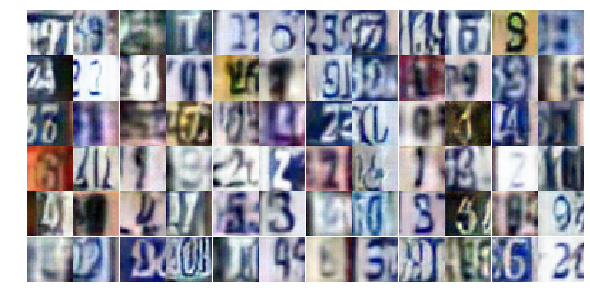

Epoch 22/25... Discriminator Loss: 1.1276... Generator Loss: 0.6407
Epoch 22/25... Discriminator Loss: 0.6651... Generator Loss: 1.1433
Epoch 22/25... Discriminator Loss: 0.7766... Generator Loss: 0.8352
Epoch 22/25... Discriminator Loss: 1.0187... Generator Loss: 0.7118
Epoch 22/25... Discriminator Loss: 0.6225... Generator Loss: 1.0643
Epoch 22/25... Discriminator Loss: 0.9887... Generator Loss: 0.7060
Epoch 22/25... Discriminator Loss: 0.8163... Generator Loss: 0.9238
Epoch 22/25... Discriminator Loss: 0.5766... Generator Loss: 1.2489
Epoch 22/25... Discriminator Loss: 0.6875... Generator Loss: 1.6165
Epoch 22/25... Discriminator Loss: 0.9895... Generator Loss: 0.6988


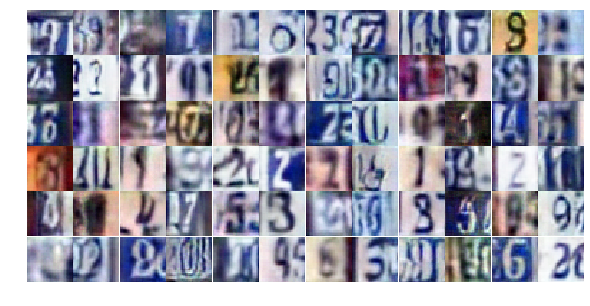

Epoch 23/25... Discriminator Loss: 0.8526... Generator Loss: 0.8745
Epoch 23/25... Discriminator Loss: 0.3642... Generator Loss: 1.5976
Epoch 23/25... Discriminator Loss: 0.8474... Generator Loss: 0.7603
Epoch 23/25... Discriminator Loss: 0.7602... Generator Loss: 0.9672
Epoch 23/25... Discriminator Loss: 0.3755... Generator Loss: 1.9126
Epoch 23/25... Discriminator Loss: 1.7361... Generator Loss: 0.3228
Epoch 23/25... Discriminator Loss: 0.5505... Generator Loss: 1.3895
Epoch 23/25... Discriminator Loss: 0.7300... Generator Loss: 0.9587
Epoch 23/25... Discriminator Loss: 0.9600... Generator Loss: 0.6760
Epoch 23/25... Discriminator Loss: 0.5264... Generator Loss: 1.2913


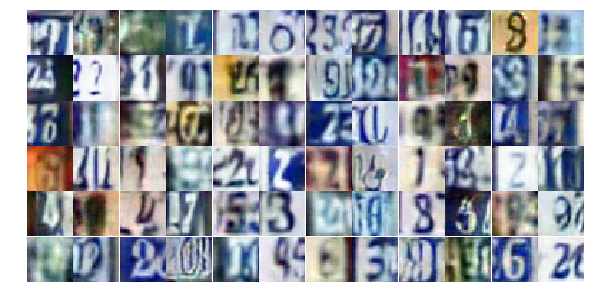

Epoch 23/25... Discriminator Loss: 0.6141... Generator Loss: 1.2025
Epoch 23/25... Discriminator Loss: 0.7966... Generator Loss: 0.8933
Epoch 23/25... Discriminator Loss: 0.9588... Generator Loss: 0.6714
Epoch 23/25... Discriminator Loss: 0.9765... Generator Loss: 0.6908
Epoch 23/25... Discriminator Loss: 0.4861... Generator Loss: 1.3043
Epoch 23/25... Discriminator Loss: 0.6042... Generator Loss: 1.2229
Epoch 23/25... Discriminator Loss: 0.9264... Generator Loss: 0.7968
Epoch 23/25... Discriminator Loss: 1.2801... Generator Loss: 3.9331
Epoch 23/25... Discriminator Loss: 2.3385... Generator Loss: 0.3421
Epoch 23/25... Discriminator Loss: 1.0592... Generator Loss: 0.7100


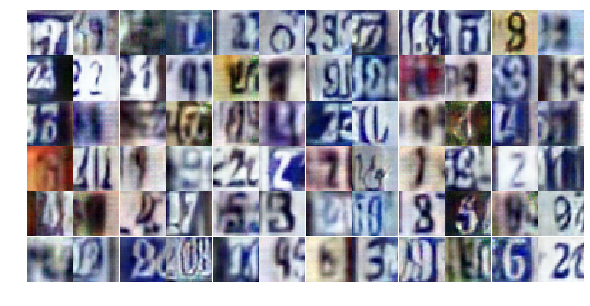

Epoch 23/25... Discriminator Loss: 0.8975... Generator Loss: 1.4492
Epoch 23/25... Discriminator Loss: 0.6897... Generator Loss: 1.0217
Epoch 23/25... Discriminator Loss: 0.8187... Generator Loss: 0.8137
Epoch 23/25... Discriminator Loss: 0.7154... Generator Loss: 0.8961
Epoch 23/25... Discriminator Loss: 0.6511... Generator Loss: 1.0825
Epoch 23/25... Discriminator Loss: 0.5804... Generator Loss: 1.2411
Epoch 23/25... Discriminator Loss: 0.7574... Generator Loss: 0.9213
Epoch 23/25... Discriminator Loss: 0.6638... Generator Loss: 1.2070
Epoch 23/25... Discriminator Loss: 0.6437... Generator Loss: 1.0118
Epoch 23/25... Discriminator Loss: 0.7724... Generator Loss: 1.8998


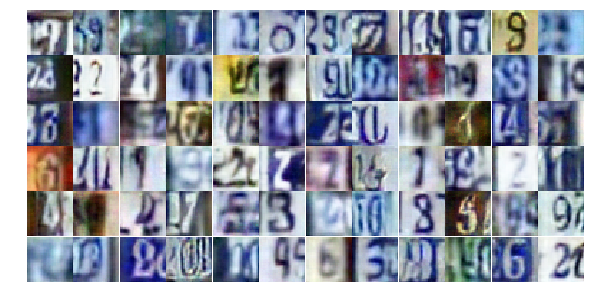

Epoch 23/25... Discriminator Loss: 0.5845... Generator Loss: 1.1051
Epoch 23/25... Discriminator Loss: 0.4695... Generator Loss: 1.5142
Epoch 23/25... Discriminator Loss: 0.7185... Generator Loss: 0.9324
Epoch 23/25... Discriminator Loss: 1.8774... Generator Loss: 0.2367
Epoch 23/25... Discriminator Loss: 0.7200... Generator Loss: 1.7607
Epoch 23/25... Discriminator Loss: 0.9923... Generator Loss: 0.7575
Epoch 23/25... Discriminator Loss: 1.1898... Generator Loss: 0.5330
Epoch 23/25... Discriminator Loss: 0.5458... Generator Loss: 1.3282
Epoch 23/25... Discriminator Loss: 0.4928... Generator Loss: 1.4253
Epoch 23/25... Discriminator Loss: 0.5041... Generator Loss: 1.3477


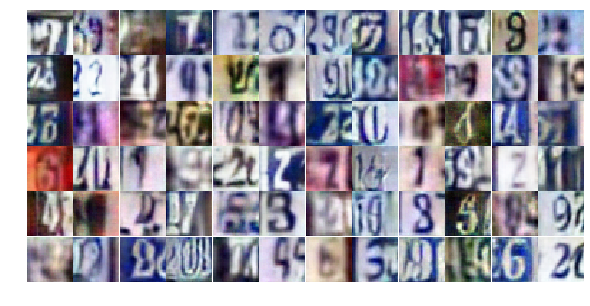

Epoch 23/25... Discriminator Loss: 1.1548... Generator Loss: 0.5830
Epoch 23/25... Discriminator Loss: 0.6837... Generator Loss: 1.0367
Epoch 23/25... Discriminator Loss: 1.3135... Generator Loss: 0.5280
Epoch 23/25... Discriminator Loss: 0.5801... Generator Loss: 1.2561
Epoch 23/25... Discriminator Loss: 0.7684... Generator Loss: 0.9088
Epoch 23/25... Discriminator Loss: 0.9488... Generator Loss: 0.6812
Epoch 23/25... Discriminator Loss: 0.5734... Generator Loss: 1.2069
Epoch 23/25... Discriminator Loss: 3.5085... Generator Loss: 0.0783
Epoch 23/25... Discriminator Loss: 0.7905... Generator Loss: 1.3296
Epoch 23/25... Discriminator Loss: 1.1178... Generator Loss: 0.7178


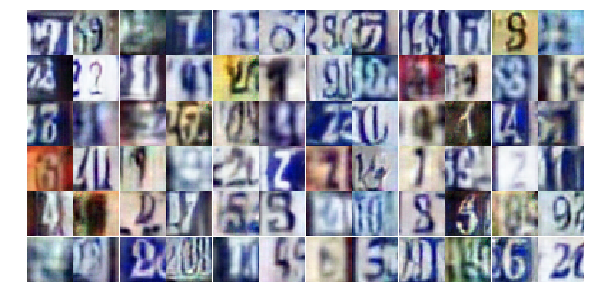

Epoch 23/25... Discriminator Loss: 0.5890... Generator Loss: 1.3233
Epoch 23/25... Discriminator Loss: 1.2778... Generator Loss: 0.5019
Epoch 23/25... Discriminator Loss: 1.0253... Generator Loss: 0.6550
Epoch 23/25... Discriminator Loss: 0.4407... Generator Loss: 1.6365
Epoch 23/25... Discriminator Loss: 1.0471... Generator Loss: 0.5802
Epoch 23/25... Discriminator Loss: 0.7820... Generator Loss: 0.8586
Epoch 23/25... Discriminator Loss: 0.9957... Generator Loss: 0.7641
Epoch 24/25... Discriminator Loss: 0.7176... Generator Loss: 0.9898
Epoch 24/25... Discriminator Loss: 0.7882... Generator Loss: 0.9396
Epoch 24/25... Discriminator Loss: 1.0003... Generator Loss: 0.7066


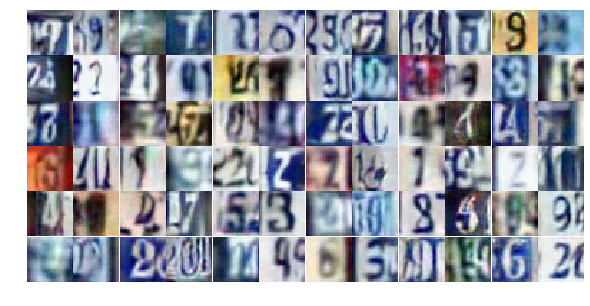

Epoch 24/25... Discriminator Loss: 0.6331... Generator Loss: 2.3338
Epoch 24/25... Discriminator Loss: 0.5263... Generator Loss: 1.5502
Epoch 24/25... Discriminator Loss: 0.7886... Generator Loss: 0.9801
Epoch 24/25... Discriminator Loss: 0.6815... Generator Loss: 1.8698
Epoch 24/25... Discriminator Loss: 0.6433... Generator Loss: 1.0741
Epoch 24/25... Discriminator Loss: 0.3052... Generator Loss: 1.8618
Epoch 24/25... Discriminator Loss: 0.8675... Generator Loss: 0.9042
Epoch 24/25... Discriminator Loss: 1.0209... Generator Loss: 0.6211
Epoch 24/25... Discriminator Loss: 0.5319... Generator Loss: 1.1865
Epoch 24/25... Discriminator Loss: 0.4789... Generator Loss: 1.5444


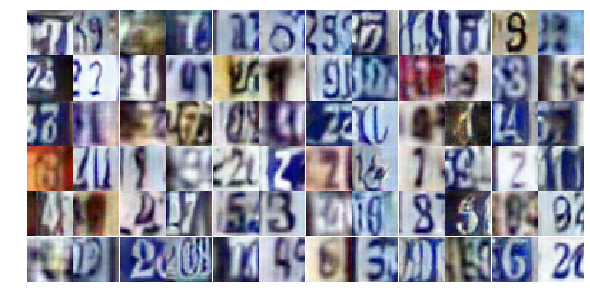

Epoch 24/25... Discriminator Loss: 1.1702... Generator Loss: 0.5327
Epoch 24/25... Discriminator Loss: 1.5841... Generator Loss: 0.3198
Epoch 24/25... Discriminator Loss: 1.2872... Generator Loss: 0.5028
Epoch 24/25... Discriminator Loss: 0.8028... Generator Loss: 0.8084
Epoch 24/25... Discriminator Loss: 0.5310... Generator Loss: 1.4143
Epoch 24/25... Discriminator Loss: 0.8444... Generator Loss: 0.8426
Epoch 24/25... Discriminator Loss: 0.4733... Generator Loss: 1.5411
Epoch 24/25... Discriminator Loss: 1.3667... Generator Loss: 0.4405
Epoch 24/25... Discriminator Loss: 0.7587... Generator Loss: 1.1188
Epoch 24/25... Discriminator Loss: 0.3974... Generator Loss: 1.6512


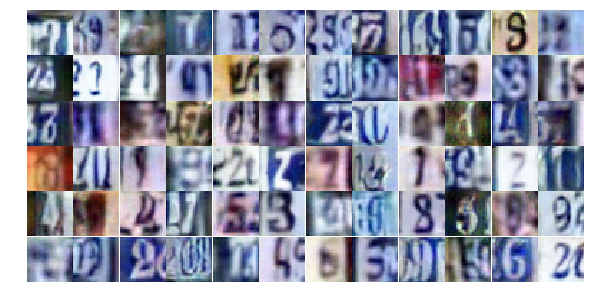

Epoch 24/25... Discriminator Loss: 0.4306... Generator Loss: 1.7241
Epoch 24/25... Discriminator Loss: 0.5517... Generator Loss: 1.2958
Epoch 24/25... Discriminator Loss: 0.3993... Generator Loss: 1.4575
Epoch 24/25... Discriminator Loss: 1.6637... Generator Loss: 0.2870
Epoch 24/25... Discriminator Loss: 0.5291... Generator Loss: 1.3224
Epoch 24/25... Discriminator Loss: 0.4966... Generator Loss: 1.2136
Epoch 24/25... Discriminator Loss: 0.5094... Generator Loss: 1.2335
Epoch 24/25... Discriminator Loss: 0.4987... Generator Loss: 1.4576
Epoch 24/25... Discriminator Loss: 0.5209... Generator Loss: 1.5841
Epoch 24/25... Discriminator Loss: 1.2115... Generator Loss: 0.5052


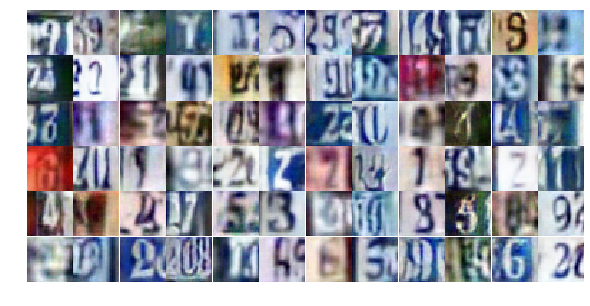

Epoch 24/25... Discriminator Loss: 0.3175... Generator Loss: 1.8775
Epoch 24/25... Discriminator Loss: 0.4318... Generator Loss: 2.5937
Epoch 24/25... Discriminator Loss: 2.0179... Generator Loss: 3.9087
Epoch 24/25... Discriminator Loss: 0.9916... Generator Loss: 0.7508
Epoch 24/25... Discriminator Loss: 0.6085... Generator Loss: 1.4158
Epoch 24/25... Discriminator Loss: 1.0377... Generator Loss: 0.6125
Epoch 24/25... Discriminator Loss: 0.7517... Generator Loss: 1.0056
Epoch 24/25... Discriminator Loss: 0.5540... Generator Loss: 1.2591
Epoch 24/25... Discriminator Loss: 0.6333... Generator Loss: 1.2041
Epoch 24/25... Discriminator Loss: 1.0496... Generator Loss: 4.1376


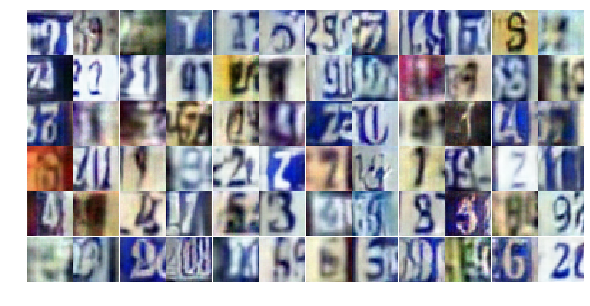

Epoch 24/25... Discriminator Loss: 0.6230... Generator Loss: 1.2832
Epoch 24/25... Discriminator Loss: 1.3779... Generator Loss: 0.5837
Epoch 24/25... Discriminator Loss: 1.7551... Generator Loss: 0.2797
Epoch 24/25... Discriminator Loss: 0.7998... Generator Loss: 1.0875
Epoch 24/25... Discriminator Loss: 1.2344... Generator Loss: 0.5153
Epoch 24/25... Discriminator Loss: 0.7596... Generator Loss: 0.9149
Epoch 24/25... Discriminator Loss: 0.9127... Generator Loss: 0.7829
Epoch 24/25... Discriminator Loss: 0.5405... Generator Loss: 1.2011
Epoch 24/25... Discriminator Loss: 0.8342... Generator Loss: 0.9278
Epoch 24/25... Discriminator Loss: 0.8775... Generator Loss: 0.7329


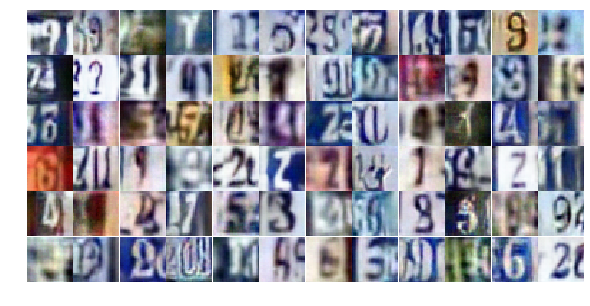

Epoch 24/25... Discriminator Loss: 0.7544... Generator Loss: 0.8863
Epoch 24/25... Discriminator Loss: 1.3065... Generator Loss: 0.5075
Epoch 24/25... Discriminator Loss: 1.0212... Generator Loss: 0.7380
Epoch 24/25... Discriminator Loss: 0.7586... Generator Loss: 1.0618
Epoch 24/25... Discriminator Loss: 1.0692... Generator Loss: 0.6489
Epoch 25/25... Discriminator Loss: 0.8161... Generator Loss: 0.9000
Epoch 25/25... Discriminator Loss: 0.5240... Generator Loss: 1.4407
Epoch 25/25... Discriminator Loss: 0.8668... Generator Loss: 0.7413
Epoch 25/25... Discriminator Loss: 0.6912... Generator Loss: 0.9674
Epoch 25/25... Discriminator Loss: 0.8827... Generator Loss: 0.7484


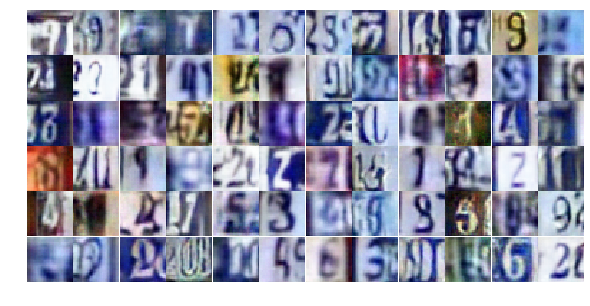

Epoch 25/25... Discriminator Loss: 0.6508... Generator Loss: 1.2354
Epoch 25/25... Discriminator Loss: 1.5639... Generator Loss: 0.3824
Epoch 25/25... Discriminator Loss: 0.7475... Generator Loss: 1.0546
Epoch 25/25... Discriminator Loss: 0.7337... Generator Loss: 1.0356
Epoch 25/25... Discriminator Loss: 1.0189... Generator Loss: 0.6946
Epoch 25/25... Discriminator Loss: 0.7315... Generator Loss: 0.9225
Epoch 25/25... Discriminator Loss: 1.0111... Generator Loss: 0.6607
Epoch 25/25... Discriminator Loss: 0.8031... Generator Loss: 0.8048
Epoch 25/25... Discriminator Loss: 0.5765... Generator Loss: 1.2111
Epoch 25/25... Discriminator Loss: 1.3374... Generator Loss: 0.5031


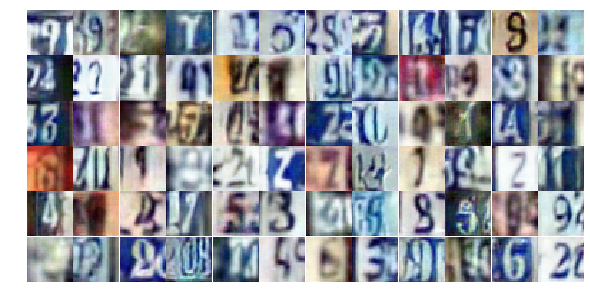

Epoch 25/25... Discriminator Loss: 0.4001... Generator Loss: 2.0195
Epoch 25/25... Discriminator Loss: 0.5952... Generator Loss: 2.8715
Epoch 25/25... Discriminator Loss: 1.2618... Generator Loss: 0.4997
Epoch 25/25... Discriminator Loss: 0.6326... Generator Loss: 1.1813
Epoch 25/25... Discriminator Loss: 0.7136... Generator Loss: 0.9283
Epoch 25/25... Discriminator Loss: 0.4209... Generator Loss: 1.6893
Epoch 25/25... Discriminator Loss: 0.8273... Generator Loss: 0.8627
Epoch 25/25... Discriminator Loss: 1.3367... Generator Loss: 0.4707
Epoch 25/25... Discriminator Loss: 0.5068... Generator Loss: 1.6095
Epoch 25/25... Discriminator Loss: 0.5275... Generator Loss: 1.4142


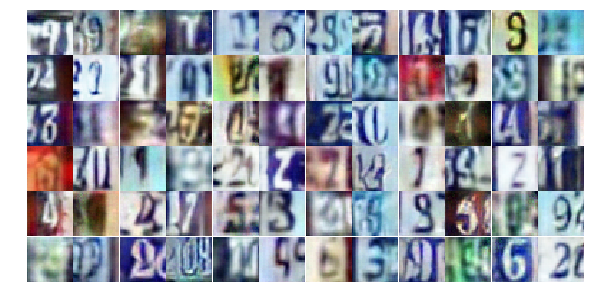

Epoch 25/25... Discriminator Loss: 0.8476... Generator Loss: 0.7925
Epoch 25/25... Discriminator Loss: 0.4987... Generator Loss: 1.2922
Epoch 25/25... Discriminator Loss: 1.3675... Generator Loss: 0.4363
Epoch 25/25... Discriminator Loss: 0.4368... Generator Loss: 1.5251
Epoch 25/25... Discriminator Loss: 1.7581... Generator Loss: 0.3110
Epoch 25/25... Discriminator Loss: 0.4069... Generator Loss: 2.4090
Epoch 25/25... Discriminator Loss: 1.0444... Generator Loss: 0.6090
Epoch 25/25... Discriminator Loss: 0.5269... Generator Loss: 1.3731
Epoch 25/25... Discriminator Loss: 0.9939... Generator Loss: 2.4448
Epoch 25/25... Discriminator Loss: 0.8900... Generator Loss: 0.8628


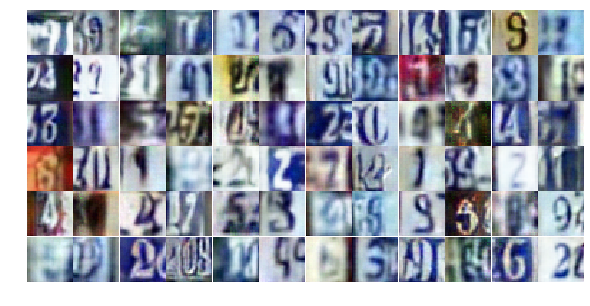

Epoch 25/25... Discriminator Loss: 1.1996... Generator Loss: 0.5014
Epoch 25/25... Discriminator Loss: 0.4615... Generator Loss: 1.4349
Epoch 25/25... Discriminator Loss: 0.7632... Generator Loss: 0.9382
Epoch 25/25... Discriminator Loss: 0.3955... Generator Loss: 1.5285
Epoch 25/25... Discriminator Loss: 1.3044... Generator Loss: 0.4230
Epoch 25/25... Discriminator Loss: 1.7407... Generator Loss: 0.3497
Epoch 25/25... Discriminator Loss: 0.7873... Generator Loss: 0.8747
Epoch 25/25... Discriminator Loss: 0.6969... Generator Loss: 1.0840
Epoch 25/25... Discriminator Loss: 2.3111... Generator Loss: 0.1636
Epoch 25/25... Discriminator Loss: 0.6784... Generator Loss: 1.9971


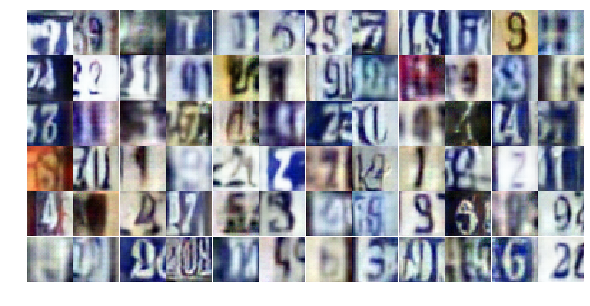

Epoch 25/25... Discriminator Loss: 0.6969... Generator Loss: 1.4935
Epoch 25/25... Discriminator Loss: 1.0335... Generator Loss: 0.6975
Epoch 25/25... Discriminator Loss: 0.7787... Generator Loss: 1.0928
Epoch 25/25... Discriminator Loss: 1.0077... Generator Loss: 0.6288
Epoch 25/25... Discriminator Loss: 0.9168... Generator Loss: 0.7544
Epoch 25/25... Discriminator Loss: 0.4727... Generator Loss: 1.3693
Epoch 25/25... Discriminator Loss: 1.0659... Generator Loss: 0.6830
Epoch 25/25... Discriminator Loss: 0.6919... Generator Loss: 1.0705
Epoch 25/25... Discriminator Loss: 0.8025... Generator Loss: 0.8774
Epoch 25/25... Discriminator Loss: 0.6521... Generator Loss: 1.0541


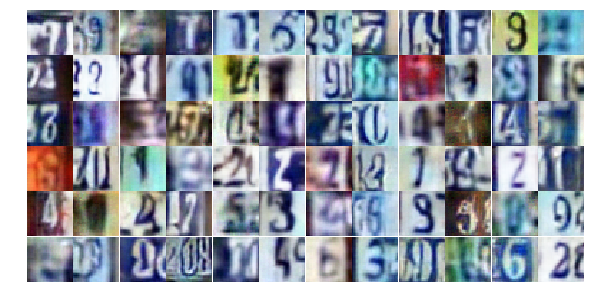

Epoch 25/25... Discriminator Loss: 2.2082... Generator Loss: 0.2279
Epoch 25/25... Discriminator Loss: 2.3538... Generator Loss: 2.1256


In [18]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

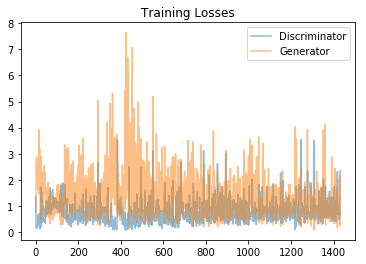

In [19]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_base.py:1334: MatplotlibDeprecationWarning: 
box-forced
  "2.2", "box-forced", obj_type="keyword argument")


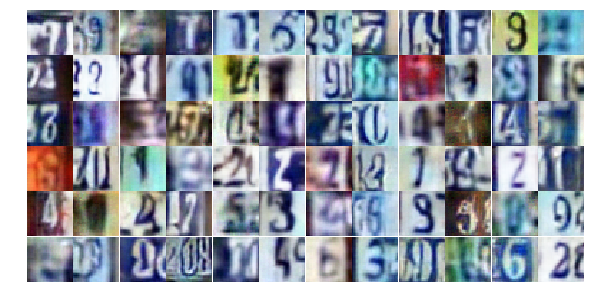

In [20]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))